<a href="https://colab.research.google.com/github/seriousssam/deep-image-prior-transfer/blob/master/DIP_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports and Basic Setup

In [0]:
# http://pytorch.org/
from os import path
from wheel.pep425tags import get_abbr_impl, get_impl_ver, get_abi_tag
import numpy as np
import time
from __future__ import division

platform = '{}{}-{}'.format(get_abbr_impl(), get_impl_ver(), get_abi_tag())

accelerator = 'cu80' if path.exists('/opt/bin/nvidia-smi') else 'cpu'

!pip install -q http://download.pytorch.org/whl/{accelerator}/torch-0.3.0.post4-{platform}-linux_x86_64.whl torchvision
import torch

In [0]:
import os
import torch
import torchvision
from torchvision import datasets, transforms
from torch.utils.data.sampler import SubsetRandomSampler
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np


In [3]:
!pip install Pillow==4.0.0

    100% |████████████████████████████████| 5.6MB 7.2MB/s 
torchvision 0.2.1 has requirement pillow>=4.1.1, but you'll have pillow 4.0.0 which is incompatible.
  Found existing installation: Pillow 5.3.0
    Uninstalling Pillow-5.3.0:
      Successfully uninstalled Pillow-5.3.0


In [0]:
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
import datetime

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# Downsampler

In [0]:
# Downsampler(n_planes=3, factor=4, kernel_type='lanczos2', phase=0.5, preserve_size=True).type(dtype)
from torch import nn
class Downsample(nn.Module):
  def __init__ (self, n_planes, factor, preserve_size):
    super(Downsample, self).__init__()
    kernel_width = 4 * factor + 1
    self.kernel = get_kernel(factor, kernel_width)
    downsampler = nn.Conv2d(n_planes, n_planes, kernel_size=self.kernel.shape, stride=factor, padding=0)
    downsampler.weight.data[:] = 0
    downsampler.bias.data[:] = 0
    kernel_torch = torch.from_numpy(self.kernel)
    for i in range(n_planes):
      downsampler.weight.data[i, i] = kernel_torch      
    self.downsampler_ = downsampler

    if preserve_size:

        if  self.kernel.shape[0] % 2 == 1: 
            pad = int((self.kernel.shape[0] - 1) / 2.)
        else:
            pad = int((self.kernel.shape[0] - factor) / 2.)

        self.padding = nn.ReplicationPad2d(pad)

    self.preserve_size = preserve_size
    
  def forward(self, input):
      if self.preserve_size:
          x = self.padding(input)
      else:
          x= input
      self.x = x
      return self.downsampler_(x)
    
def get_kernel(factor, kernel_width):
  support = 2
  kernel = np.zeros([kernel_width - 1, kernel_width - 1])
  center = (kernel_width + 1) / 2.

  for i in range(1, kernel.shape[0] + 1):
      for j in range(1, kernel.shape[1] + 1):

          di = abs(i + 0.5 - center) / factor  
          dj = abs(j + 0.5 - center) / factor 

          pi_sq = np.pi * np.pi

          val = 1
          if di != 0:
              val = val * support * np.sin(np.pi * di) * np.sin(np.pi * di / support)
              val = val / (np.pi * np.pi * di * di)

          if dj != 0:
              val = val * support * np.sin(np.pi * dj) * np.sin(np.pi * dj / support)
              val = val / (np.pi * np.pi * dj * dj)

          kernel[i - 1][j - 1] = val
  kernel /= kernel.sum()
  return kernel

# Data import for superresolution dip network

In [0]:
import os

# Fetch the folder with all the input images
file_list = drive.ListFile({'q': "'11a5-Sek52Fq86iHXoK6KQ-Gvr1G8El0Y' in parents and trashed=false"}).GetList()

# Create an input directory (no need to execute cuz created)
os.mkdir('input')

In [7]:
# Store files in the input directory
i = 1
for file1 in sorted(file_list, key = lambda x: x['title']):
    print('Downloading {} from GDrive ({}/{})'.format(file1['title'], i, len(file_list)))
    file1.GetContentFile('input/' + file1['title'])
    i += 1

In [8]:
images = os.listdir('input')
#Verify that files are present
images[:5]

['invaders_05_input.png',
 'gaxe2_axbattler_02_input.png',
 'vikings_eric_input.png',
 'mana_granpa_input.png',
 'win31_ports_input.png']

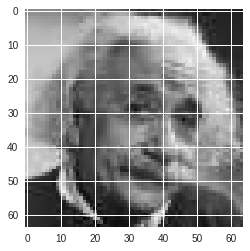

In [9]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

path = 'input/einstein.jpg'
image = mpimg.imread(path)
plt.imshow(image)

In [10]:
image.shape

(64, 64, 3)

In [0]:
from PIL import Image
def get_image(filename):
  image = Image.open('input/' + filename)
  image_array = np.array(image)
  image_array = image_array.transpose((2, 0, 1))
  return image_array/255

# Build superresolution dip network

In [0]:
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

LeakyReLU = nn.LeakyReLU(0.2, inplace=True)

num_channels_down=[128, 128, 128, 128, 128]
num_channels_up=[128, 128, 128, 128, 128]
num_channels_skip=[4, 4, 4, 4, 4]
num_channels_input = 32
k_down = 3
k_up = 3
k_skip = 1

padding_down = int((k_down-1)/2)
padding_up = int((k_up-1)/2)
padding_skip = int((k_skip-1)/2)

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        #-----------------------------------------------------------------------
        #----------------------------- Down blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 0 # for first
        #first down block, others are copypaste
        self.down1_downsample = nn.Conv2d(num_channels_input, num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down1_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down1_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down1_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 1
        self.down2_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down2_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down2_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down2_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 2
        self.down3_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down3_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down3_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down3_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 3
        self.down4_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down4_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down4_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down4_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 4
        self.down5_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down5_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down5_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down5_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        #-----------------------------------------------------------------------
        #----------------------------- Skip blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 0 # for first
        #first skip block, others are copypaste
        self.skip1_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip1_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        i = 1
        self.skip2_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip2_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        i = 2
        self.skip3_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip3_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        i = 3
        self.skip4_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip4_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        i = 4
        self.skip5_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip5_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        #-----------------------------------------------------------------------
        #--------------------------- Misc but needed ---------------------------
        #-----------------------------------------------------------------------
        
        #will need this for the up layers
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear') #at the end
        num_channels_up.append(0) #this way for the fifth layers the combined is just the skip
        #will need this at the end of network
        self.makeFinalOutput = nn.Conv2d(num_channels_up[0],3,1)
        
        #-----------------------------------------------------------------------
        #------------------------------ Up blocks ------------------------------
        #-----------------------------------------------------------------------
        
        i=4 # for fifth
        #fifth up block, others are copypaste
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i]; #num_channels_up[5] is 0
        self.up5_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up5_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up5_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up5_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up5_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=3
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up4_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up4_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up4_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up4_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up4_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=2
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up3_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up3_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up3_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up3_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up3_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=1
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up2_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up2_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up2_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up2_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up2_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=0
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up1_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up1_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up1_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up1_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up1_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
    def forward(self, x):
        #-----------------------------------------------------------------------
        #-------------------- Downsampling and recording skip ------------------
        #-----------------------------------------------------------------------
        x = LeakyReLU(self.down1_bn_downsample(self.down1_downsample(x)))
        x = LeakyReLU(self.down1_bn_justconv(self.down1_justconv(x)))
        skips1 = LeakyReLU(self.skip1_bn(self.skip1_conv(x)))
        
        x = LeakyReLU(self.down2_bn_downsample(self.down2_downsample(x)))
        x = LeakyReLU(self.down2_bn_justconv(self.down2_justconv(x)))
        skips2 = LeakyReLU(self.skip2_bn(self.skip2_conv(x)))
        
        x = LeakyReLU(self.down3_bn_downsample(self.down3_downsample(x)))
        x = LeakyReLU(self.down3_bn_justconv(self.down3_justconv(x)))
        skips3 = LeakyReLU(self.skip3_bn(self.skip3_conv(x)))
        
        x = LeakyReLU(self.down4_bn_downsample(self.down4_downsample(x)))
        x = LeakyReLU(self.down4_bn_justconv(self.down4_justconv(x)))
        skips4 = LeakyReLU(self.skip4_bn(self.skip4_conv(x)))
        
        x = LeakyReLU(self.down5_bn_downsample(self.down5_downsample(x)))
        x = LeakyReLU(self.down5_bn_justconv(self.down5_justconv(x)))
        skips5 = LeakyReLU(self.skip5_bn(self.skip5_conv(x)))
        
        #-----------------------------------------------------------------------
        #------------------------------ Upsampling -----------------------------
        #-----------------------------------------------------------------------
        
        #we start at the fifth layer (layers have reverse order)
        x = self.up5_bn_initial(skips5) #notice no concatenation here
        x = LeakyReLU(self.up5_bn1(self.up5_conv1(x)))
        x = LeakyReLU(self.up5_bn2(self.up5_conv2(x)))
        x = self.upsample(x)
        
        #now we upsample all the other layers
        #print("up4")
        #print(x.size())
        #print(skips4.size())
        x = self.up4_bn_initial(torch.cat((x, skips4),1))
        x = LeakyReLU(self.up4_bn1(self.up4_conv1(x)))
        x = LeakyReLU(self.up4_bn2(self.up4_conv2(x)))
        x = self.upsample(x)
        
        #print("up3")
        #print(x.size())
        #print(skips3.size())
        x = self.up3_bn_initial(torch.cat((x, skips3),1))
        x = LeakyReLU(self.up3_bn1(self.up3_conv1(x)))
        x = LeakyReLU(self.up3_bn2(self.up3_conv2(x)))
        x = self.upsample(x)
        
        #print("up2")
        #print(x.size())
        #print(skips2.size())
        x = self.up2_bn_initial(torch.cat((x, skips2),1))
        x = LeakyReLU(self.up2_bn1(self.up2_conv1(x)))
        x = LeakyReLU(self.up2_bn2(self.up2_conv2(x)))
        x = self.upsample(x)
        
        #print("up1")
        #print(x.size())
        #print(skips1.size())
        x = self.up1_bn_initial(torch.cat((x, skips1),1))
        x = LeakyReLU(self.up1_bn1(self.up1_conv1(x)))
        x = LeakyReLU(self.up1_bn2(self.up1_conv2(x)))
        x = self.upsample(x)
        
        
        #-----------------------------------------------------------------------
        #------------------------------- Finalize ------------------------------
        #-----------------------------------------------------------------------

        #now we get x to the right dimensions
        x = self.makeFinalOutput(x) #not sure if we need the leaky ReLU here
        
        return x

In [0]:
#generate noisy image for Yoshi
#original dimensions (3,32,22)
#output image (3,256,176)
#input_depth = 32
#dimensions = [256,176]
#noiseType = "uniform"

def createNoisyImage(input_depth,dimensions,var=0.1,noiseType='uniform'):
  tensorShape = [1,input_depth,dimensions[0],dimensions[1]]
  networkInput = Variable(torch.zeros(tensorShape))
  
  if noiseType == "uniform":
    networkInput.data.uniform_()
  elif noiseType == "normal":
    networkInput.data.normal_()
  
  networkInput.data = networkInput.data * var
  
  return networkInput

#this needs to be image size times 4!
superResolutionBase = createNoisyImage(32,[256,256],0.1,"uniform")
#inputs are: input_depth, [img.shape[1],img.shape[2]], var, noiseType

base = superResolutionBase.type(torch.cuda.FloatTensor).detach()
savedBase = base.data.clone()
baseNoise = base.data.clone()

In [0]:
def addRandomNoise(inputs):
  inputs.data = savedBase + baseNoise.normal_()*1.0/30
  return inputs

# Train superresolution dip network

We train it on a small image (64x64) for prototyping but the same network was used successfully on larger images.

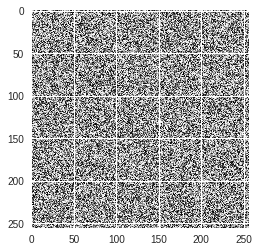

In [15]:
#plotting only
superResolutionInput = superResolutionBase.data[0,:,:,:]
#print(superResolutionInput)
plt.imshow(np.array(superResolutionInput)[30])

In [16]:
#size is [1, channels, height, width]
lowres_image = Variable(torch.Tensor(get_image('einstein.jpg')))
img = get_image('einstein.jpg')
img.shape
#plt.imshow(img)

(3, 64, 64)

Naturally training is testing here, so we save outputs to images and upload these images to gdrive

In [0]:
net = Net()
net.cuda()

criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)

Started Training


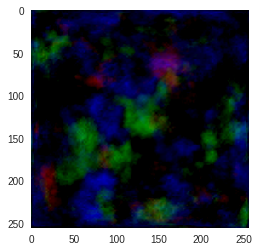

[1, 2 s] loss: 0.396 
[2, 2 s] loss: 0.400 
[3, 2 s] loss: 0.140 
[4, 2 s] loss: 0.298 
[5, 2 s] loss: 0.083 
[6, 3 s] loss: 0.084 
[7, 3 s] loss: 0.071 
[8, 3 s] loss: 0.051 
[9, 3 s] loss: 0.042 
[10, 3 s] loss: 0.038 
[11, 3 s] loss: 0.035 
[12, 3 s] loss: 0.033 
[13, 3 s] loss: 0.033 
[14, 3 s] loss: 0.032 
[15, 3 s] loss: 0.029 
[16, 3 s] loss: 0.029 
[17, 3 s] loss: 0.026 
[18, 3 s] loss: 0.025 
[19, 3 s] loss: 0.023 
[20, 4 s] loss: 0.022 


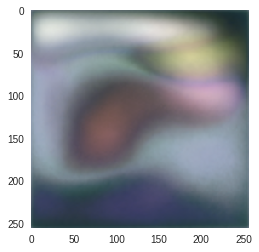

[21, 5 s] loss: 0.022 
[22, 5 s] loss: 0.021 
[23, 5 s] loss: 0.020 
[24, 5 s] loss: 0.018 
[25, 5 s] loss: 0.019 
[26, 5 s] loss: 0.018 
[27, 5 s] loss: 0.017 
[28, 5 s] loss: 0.017 
[29, 6 s] loss: 0.017 
[30, 6 s] loss: 0.016 
[31, 6 s] loss: 0.016 
[32, 6 s] loss: 0.015 
[33, 6 s] loss: 0.016 
[34, 6 s] loss: 0.014 
[35, 6 s] loss: 0.013 
[36, 6 s] loss: 0.013 
[37, 6 s] loss: 0.013 
[38, 6 s] loss: 0.012 
[39, 6 s] loss: 0.012 
[40, 6 s] loss: 0.011 


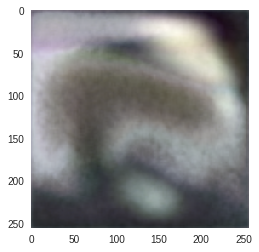

[41, 8 s] loss: 0.011 
[42, 8 s] loss: 0.011 
[43, 8 s] loss: 0.012 
[44, 8 s] loss: 0.011 
[45, 8 s] loss: 0.011 
[46, 8 s] loss: 0.011 
[47, 8 s] loss: 0.010 
[48, 8 s] loss: 0.010 
[49, 8 s] loss: 0.010 
[50, 8 s] loss: 0.009 
[51, 9 s] loss: 0.010 
[52, 9 s] loss: 0.010 
[53, 9 s] loss: 0.009 
[54, 9 s] loss: 0.010 
[55, 9 s] loss: 0.009 
[56, 9 s] loss: 0.009 
[57, 9 s] loss: 0.008 
[58, 9 s] loss: 0.008 
[59, 9 s] loss: 0.008 
[60, 9 s] loss: 0.009 


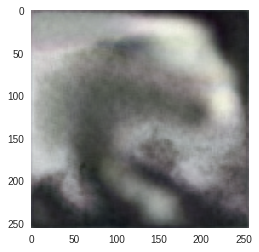

[61, 10 s] loss: 0.008 
[62, 10 s] loss: 0.008 
[63, 11 s] loss: 0.007 
[64, 11 s] loss: 0.007 
[65, 11 s] loss: 0.007 
[66, 11 s] loss: 0.007 
[67, 11 s] loss: 0.007 
[68, 11 s] loss: 0.007 
[69, 11 s] loss: 0.007 
[70, 11 s] loss: 0.007 
[71, 11 s] loss: 0.006 
[72, 11 s] loss: 0.006 
[73, 11 s] loss: 0.006 
[74, 11 s] loss: 0.007 
[75, 11 s] loss: 0.006 
[76, 12 s] loss: 0.006 
[77, 12 s] loss: 0.007 
[78, 12 s] loss: 0.006 
[79, 12 s] loss: 0.006 
[80, 12 s] loss: 0.006 


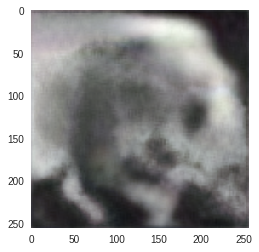

[81, 13 s] loss: 0.005 
[82, 13 s] loss: 0.007 
[83, 13 s] loss: 0.006 
[84, 13 s] loss: 0.006 
[85, 13 s] loss: 0.006 
[86, 14 s] loss: 0.005 
[87, 14 s] loss: 0.006 
[88, 14 s] loss: 0.006 
[89, 14 s] loss: 0.006 
[90, 14 s] loss: 0.005 
[91, 14 s] loss: 0.005 
[92, 14 s] loss: 0.006 
[93, 14 s] loss: 0.006 
[94, 14 s] loss: 0.005 
[95, 14 s] loss: 0.005 
[96, 14 s] loss: 0.005 
[97, 14 s] loss: 0.005 
[98, 14 s] loss: 0.005 
[99, 15 s] loss: 0.005 
[100, 15 s] loss: 0.005 


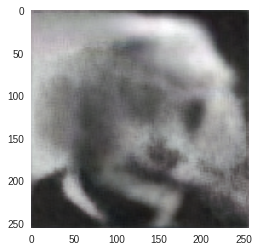

[101, 16 s] loss: 0.005 
[102, 16 s] loss: 0.005 
[103, 16 s] loss: 0.004 
[104, 16 s] loss: 0.004 
[105, 16 s] loss: 0.004 
[106, 16 s] loss: 0.005 
[107, 16 s] loss: 0.005 
[108, 16 s] loss: 0.004 
[109, 16 s] loss: 0.004 
[110, 16 s] loss: 0.004 
[111, 17 s] loss: 0.004 
[112, 17 s] loss: 0.004 
[113, 17 s] loss: 0.004 
[114, 17 s] loss: 0.005 
[115, 17 s] loss: 0.004 
[116, 17 s] loss: 0.004 
[117, 17 s] loss: 0.004 
[118, 17 s] loss: 0.004 
[119, 17 s] loss: 0.004 
[120, 17 s] loss: 0.004 


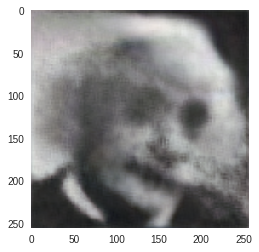

[121, 18 s] loss: 0.004 
[122, 19 s] loss: 0.004 
[123, 19 s] loss: 0.004 
[124, 19 s] loss: 0.004 
[125, 19 s] loss: 0.004 
[126, 19 s] loss: 0.004 
[127, 19 s] loss: 0.004 
[128, 19 s] loss: 0.004 
[129, 19 s] loss: 0.004 
[130, 19 s] loss: 0.004 
[131, 19 s] loss: 0.004 
[132, 19 s] loss: 0.004 
[133, 19 s] loss: 0.004 
[134, 19 s] loss: 0.004 
[135, 20 s] loss: 0.004 
[136, 20 s] loss: 0.003 
[137, 20 s] loss: 0.004 
[138, 20 s] loss: 0.004 
[139, 20 s] loss: 0.003 
[140, 20 s] loss: 0.004 


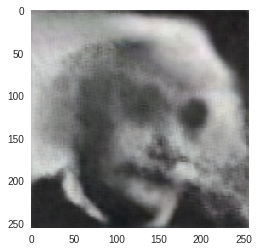

[141, 21 s] loss: 0.003 
[142, 21 s] loss: 0.003 
[143, 21 s] loss: 0.004 
[144, 21 s] loss: 0.003 
[145, 21 s] loss: 0.003 
[146, 21 s] loss: 0.003 
[147, 22 s] loss: 0.004 
[148, 22 s] loss: 0.003 
[149, 22 s] loss: 0.003 
[150, 22 s] loss: 0.003 
[151, 22 s] loss: 0.003 
[152, 22 s] loss: 0.003 
[153, 22 s] loss: 0.003 
[154, 22 s] loss: 0.003 
[155, 22 s] loss: 0.003 
[156, 22 s] loss: 0.003 
[157, 22 s] loss: 0.003 
[158, 22 s] loss: 0.003 
[159, 22 s] loss: 0.003 
[160, 23 s] loss: 0.003 


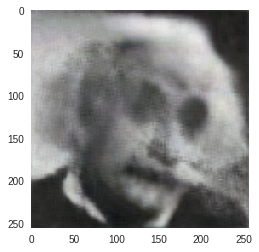

[161, 24 s] loss: 0.003 
[162, 24 s] loss: 0.003 
[163, 24 s] loss: 0.003 
[164, 24 s] loss: 0.003 
[165, 24 s] loss: 0.003 
[166, 24 s] loss: 0.003 
[167, 25 s] loss: 0.003 
[168, 25 s] loss: 0.003 
[169, 25 s] loss: 0.003 
[170, 25 s] loss: 0.003 
[171, 25 s] loss: 0.003 
[172, 25 s] loss: 0.003 
[173, 25 s] loss: 0.003 
[174, 25 s] loss: 0.003 
[175, 25 s] loss: 0.003 
[176, 25 s] loss: 0.003 
[177, 25 s] loss: 0.003 
[178, 25 s] loss: 0.003 
[179, 25 s] loss: 0.003 
[180, 25 s] loss: 0.003 


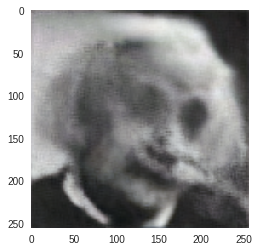

[181, 27 s] loss: 0.003 
[182, 27 s] loss: 0.003 
[183, 27 s] loss: 0.003 
[184, 27 s] loss: 0.002 
[185, 27 s] loss: 0.003 
[186, 27 s] loss: 0.003 
[187, 27 s] loss: 0.002 
[188, 27 s] loss: 0.003 
[189, 27 s] loss: 0.003 
[190, 27 s] loss: 0.003 
[191, 27 s] loss: 0.002 
[192, 28 s] loss: 0.003 
[193, 28 s] loss: 0.003 
[194, 28 s] loss: 0.002 
[195, 28 s] loss: 0.003 
[196, 28 s] loss: 0.002 
[197, 28 s] loss: 0.003 
[198, 28 s] loss: 0.003 
[199, 28 s] loss: 0.003 
[200, 28 s] loss: 0.002 


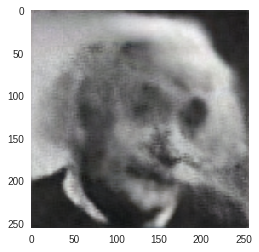

[201, 30 s] loss: 0.002 
[202, 30 s] loss: 0.002 
[203, 30 s] loss: 0.003 
[204, 30 s] loss: 0.002 
[205, 30 s] loss: 0.003 
[206, 30 s] loss: 0.002 
[207, 31 s] loss: 0.002 
[208, 31 s] loss: 0.002 
[209, 31 s] loss: 0.002 
[210, 31 s] loss: 0.002 
[211, 31 s] loss: 0.002 
[212, 31 s] loss: 0.003 
[213, 31 s] loss: 0.002 
[214, 31 s] loss: 0.003 
[215, 31 s] loss: 0.002 
[216, 31 s] loss: 0.003 
[217, 31 s] loss: 0.002 
[218, 31 s] loss: 0.002 
[219, 31 s] loss: 0.002 
[220, 32 s] loss: 0.002 


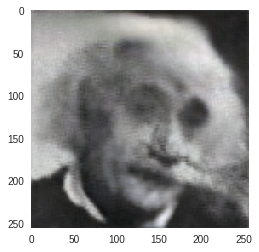

[221, 33 s] loss: 0.002 
[222, 33 s] loss: 0.002 
[223, 33 s] loss: 0.002 
[224, 33 s] loss: 0.002 
[225, 33 s] loss: 0.002 
[226, 33 s] loss: 0.002 
[227, 33 s] loss: 0.002 
[228, 34 s] loss: 0.002 
[229, 34 s] loss: 0.002 
[230, 34 s] loss: 0.002 
[231, 34 s] loss: 0.002 
[232, 34 s] loss: 0.002 
[233, 34 s] loss: 0.002 
[234, 34 s] loss: 0.002 
[235, 34 s] loss: 0.002 
[236, 34 s] loss: 0.002 
[237, 34 s] loss: 0.002 
[238, 34 s] loss: 0.002 
[239, 34 s] loss: 0.002 
[240, 34 s] loss: 0.002 


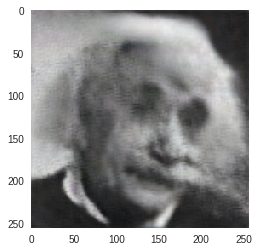

[241, 36 s] loss: 0.002 
[242, 36 s] loss: 0.002 
[243, 36 s] loss: 0.002 
[244, 36 s] loss: 0.002 
[245, 36 s] loss: 0.002 
[246, 36 s] loss: 0.002 
[247, 36 s] loss: 0.002 
[248, 36 s] loss: 0.002 
[249, 36 s] loss: 0.002 
[250, 36 s] loss: 0.002 
[251, 37 s] loss: 0.002 
[252, 37 s] loss: 0.002 
[253, 37 s] loss: 0.002 
[254, 37 s] loss: 0.002 
[255, 37 s] loss: 0.002 
[256, 37 s] loss: 0.002 
[257, 37 s] loss: 0.002 
[258, 37 s] loss: 0.002 
[259, 37 s] loss: 0.002 
[260, 37 s] loss: 0.002 


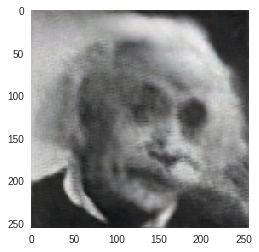

[261, 39 s] loss: 0.002 
[262, 39 s] loss: 0.002 
[263, 39 s] loss: 0.002 
[264, 39 s] loss: 0.002 
[265, 39 s] loss: 0.002 
[266, 39 s] loss: 0.002 
[267, 39 s] loss: 0.002 
[268, 39 s] loss: 0.002 
[269, 39 s] loss: 0.002 
[270, 39 s] loss: 0.002 
[271, 39 s] loss: 0.002 
[272, 39 s] loss: 0.002 
[273, 40 s] loss: 0.002 
[274, 40 s] loss: 0.002 
[275, 40 s] loss: 0.002 
[276, 40 s] loss: 0.002 
[277, 40 s] loss: 0.002 
[278, 40 s] loss: 0.002 
[279, 40 s] loss: 0.002 
[280, 40 s] loss: 0.002 


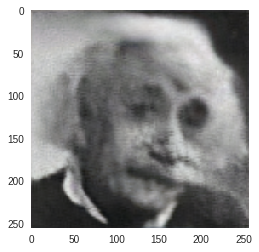

[281, 41 s] loss: 0.002 
[282, 41 s] loss: 0.002 
[283, 42 s] loss: 0.002 
[284, 42 s] loss: 0.002 
[285, 42 s] loss: 0.002 
[286, 42 s] loss: 0.002 
[287, 42 s] loss: 0.002 
[288, 42 s] loss: 0.002 
[289, 42 s] loss: 0.002 
[290, 42 s] loss: 0.002 
[291, 42 s] loss: 0.002 
[292, 42 s] loss: 0.002 
[293, 42 s] loss: 0.002 
[294, 42 s] loss: 0.002 
[295, 42 s] loss: 0.002 
[296, 42 s] loss: 0.002 
[297, 43 s] loss: 0.001 
[298, 43 s] loss: 0.002 
[299, 43 s] loss: 0.002 
[300, 43 s] loss: 0.002 


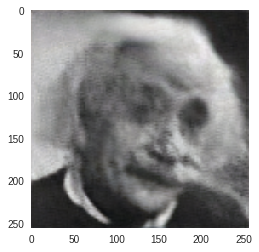

[301, 44 s] loss: 0.002 
[302, 44 s] loss: 0.002 
[303, 44 s] loss: 0.002 
[304, 44 s] loss: 0.002 
[305, 44 s] loss: 0.002 
[306, 44 s] loss: 0.002 
[307, 45 s] loss: 0.002 
[308, 45 s] loss: 0.002 
[309, 45 s] loss: 0.002 
[310, 45 s] loss: 0.002 
[311, 45 s] loss: 0.002 
[312, 45 s] loss: 0.002 
[313, 45 s] loss: 0.002 
[314, 45 s] loss: 0.001 
[315, 45 s] loss: 0.002 
[316, 45 s] loss: 0.002 
[317, 45 s] loss: 0.001 
[318, 45 s] loss: 0.001 
[319, 45 s] loss: 0.001 
[320, 46 s] loss: 0.001 


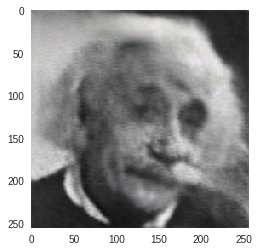

[321, 47 s] loss: 0.001 
[322, 47 s] loss: 0.002 
[323, 47 s] loss: 0.001 
[324, 48 s] loss: 0.001 
[325, 48 s] loss: 0.001 
[326, 48 s] loss: 0.001 
[327, 48 s] loss: 0.001 
[328, 48 s] loss: 0.001 
[329, 48 s] loss: 0.001 
[330, 48 s] loss: 0.001 
[331, 48 s] loss: 0.001 
[332, 48 s] loss: 0.001 
[333, 48 s] loss: 0.001 
[334, 48 s] loss: 0.001 
[335, 48 s] loss: 0.001 
[336, 48 s] loss: 0.001 
[337, 48 s] loss: 0.001 
[338, 49 s] loss: 0.002 
[339, 49 s] loss: 0.001 
[340, 49 s] loss: 0.001 


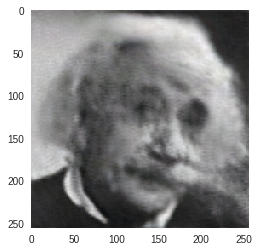

[341, 50 s] loss: 0.001 
[342, 50 s] loss: 0.001 
[343, 50 s] loss: 0.001 
[344, 50 s] loss: 0.001 
[345, 50 s] loss: 0.002 
[346, 50 s] loss: 0.001 
[347, 50 s] loss: 0.001 
[348, 50 s] loss: 0.002 
[349, 51 s] loss: 0.001 
[350, 51 s] loss: 0.001 
[351, 51 s] loss: 0.001 
[352, 51 s] loss: 0.001 
[353, 51 s] loss: 0.001 
[354, 51 s] loss: 0.001 
[355, 51 s] loss: 0.001 
[356, 51 s] loss: 0.001 
[357, 51 s] loss: 0.001 
[358, 51 s] loss: 0.002 
[359, 51 s] loss: 0.001 
[360, 51 s] loss: 0.001 


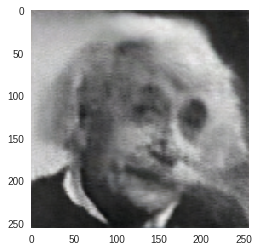

[361, 53 s] loss: 0.001 
[362, 53 s] loss: 0.001 
[363, 53 s] loss: 0.001 
[364, 53 s] loss: 0.001 
[365, 53 s] loss: 0.001 
[366, 53 s] loss: 0.001 
[367, 53 s] loss: 0.001 
[368, 53 s] loss: 0.001 
[369, 54 s] loss: 0.001 
[370, 54 s] loss: 0.001 
[371, 54 s] loss: 0.001 
[372, 54 s] loss: 0.001 
[373, 54 s] loss: 0.001 
[374, 54 s] loss: 0.001 
[375, 54 s] loss: 0.001 
[376, 54 s] loss: 0.001 
[377, 54 s] loss: 0.001 
[378, 54 s] loss: 0.001 
[379, 54 s] loss: 0.001 
[380, 54 s] loss: 0.001 


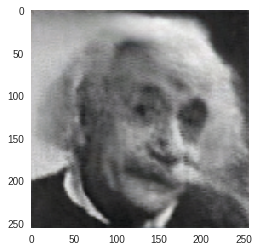

[381, 56 s] loss: 0.001 
[382, 56 s] loss: 0.001 
[383, 56 s] loss: 0.001 
[384, 56 s] loss: 0.001 
[385, 56 s] loss: 0.001 
[386, 56 s] loss: 0.001 
[387, 56 s] loss: 0.001 
[388, 56 s] loss: 0.001 
[389, 56 s] loss: 0.001 
[390, 56 s] loss: 0.001 
[391, 56 s] loss: 0.001 
[392, 56 s] loss: 0.001 
[393, 57 s] loss: 0.001 
[394, 57 s] loss: 0.001 
[395, 57 s] loss: 0.001 
[396, 57 s] loss: 0.001 
[397, 57 s] loss: 0.001 
[398, 57 s] loss: 0.001 
[399, 57 s] loss: 0.001 
[400, 57 s] loss: 0.001 


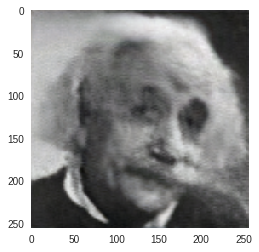

[401, 58 s] loss: 0.001 
[402, 59 s] loss: 0.001 
[403, 59 s] loss: 0.001 
[404, 59 s] loss: 0.001 
[405, 59 s] loss: 0.001 
[406, 59 s] loss: 0.001 
[407, 59 s] loss: 0.001 
[408, 59 s] loss: 0.001 
[409, 59 s] loss: 0.001 
[410, 59 s] loss: 0.001 
[411, 59 s] loss: 0.001 
[412, 59 s] loss: 0.001 
[413, 59 s] loss: 0.001 
[414, 59 s] loss: 0.001 
[415, 59 s] loss: 0.001 
[416, 60 s] loss: 0.001 
[417, 60 s] loss: 0.001 
[418, 60 s] loss: 0.001 
[419, 60 s] loss: 0.001 
[420, 60 s] loss: 0.001 


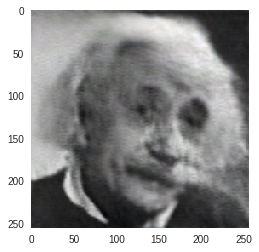

[421, 61 s] loss: 0.001 
[422, 61 s] loss: 0.001 
[423, 61 s] loss: 0.001 
[424, 61 s] loss: 0.001 
[425, 61 s] loss: 0.001 
[426, 62 s] loss: 0.001 
[427, 62 s] loss: 0.001 
[428, 62 s] loss: 0.001 
[429, 62 s] loss: 0.001 
[430, 62 s] loss: 0.001 
[431, 62 s] loss: 0.001 
[432, 62 s] loss: 0.001 
[433, 62 s] loss: 0.001 
[434, 62 s] loss: 0.001 
[435, 62 s] loss: 0.001 
[436, 62 s] loss: 0.001 
[437, 62 s] loss: 0.001 
[438, 62 s] loss: 0.001 
[439, 63 s] loss: 0.001 
[440, 63 s] loss: 0.001 


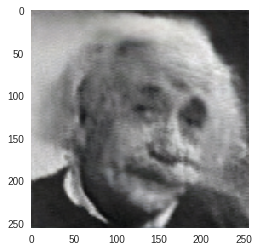

[441, 64 s] loss: 0.001 
[442, 64 s] loss: 0.001 
[443, 64 s] loss: 0.001 
[444, 64 s] loss: 0.001 
[445, 64 s] loss: 0.001 
[446, 64 s] loss: 0.001 
[447, 64 s] loss: 0.001 
[448, 65 s] loss: 0.001 
[449, 65 s] loss: 0.001 
[450, 65 s] loss: 0.001 
[451, 65 s] loss: 0.001 
[452, 65 s] loss: 0.001 
[453, 65 s] loss: 0.001 
[454, 65 s] loss: 0.001 
[455, 65 s] loss: 0.001 
[456, 65 s] loss: 0.001 
[457, 65 s] loss: 0.001 
[458, 65 s] loss: 0.001 
[459, 65 s] loss: 0.001 
[460, 65 s] loss: 0.001 


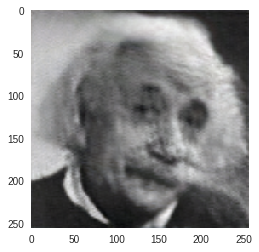

[461, 67 s] loss: 0.001 
[462, 67 s] loss: 0.001 
[463, 67 s] loss: 0.001 
[464, 67 s] loss: 0.001 
[465, 67 s] loss: 0.001 
[466, 67 s] loss: 0.001 
[467, 68 s] loss: 0.001 
[468, 68 s] loss: 0.001 
[469, 68 s] loss: 0.001 
[470, 68 s] loss: 0.001 
[471, 68 s] loss: 0.001 
[472, 68 s] loss: 0.001 
[473, 68 s] loss: 0.001 
[474, 68 s] loss: 0.001 
[475, 68 s] loss: 0.001 
[476, 68 s] loss: 0.001 
[477, 68 s] loss: 0.001 
[478, 68 s] loss: 0.001 
[479, 68 s] loss: 0.001 
[480, 68 s] loss: 0.001 


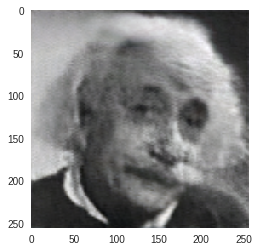

[481, 70 s] loss: 0.001 
[482, 70 s] loss: 0.001 
[483, 70 s] loss: 0.001 
[484, 70 s] loss: 0.001 
[485, 70 s] loss: 0.001 
[486, 70 s] loss: 0.001 
[487, 70 s] loss: 0.001 
[488, 70 s] loss: 0.001 
[489, 70 s] loss: 0.001 
[490, 70 s] loss: 0.001 
[491, 70 s] loss: 0.001 
[492, 71 s] loss: 0.001 
[493, 71 s] loss: 0.001 
[494, 71 s] loss: 0.001 
[495, 71 s] loss: 0.001 
[496, 71 s] loss: 0.001 
[497, 71 s] loss: 0.001 
[498, 71 s] loss: 0.001 
[499, 71 s] loss: 0.001 
[500, 71 s] loss: 0.001 


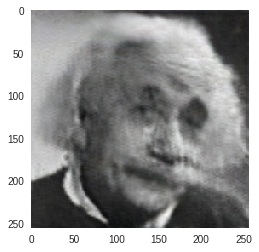

[501, 73 s] loss: 0.001 
[502, 73 s] loss: 0.001 
[503, 73 s] loss: 0.001 
[504, 73 s] loss: 0.001 
[505, 73 s] loss: 0.001 
[506, 73 s] loss: 0.001 
[507, 73 s] loss: 0.001 
[508, 73 s] loss: 0.001 
[509, 73 s] loss: 0.001 
[510, 73 s] loss: 0.001 
[511, 73 s] loss: 0.001 
[512, 73 s] loss: 0.001 
[513, 73 s] loss: 0.001 
[514, 73 s] loss: 0.001 
[515, 74 s] loss: 0.001 
[516, 74 s] loss: 0.001 
[517, 74 s] loss: 0.001 
[518, 74 s] loss: 0.001 
[519, 74 s] loss: 0.001 
[520, 74 s] loss: 0.001 


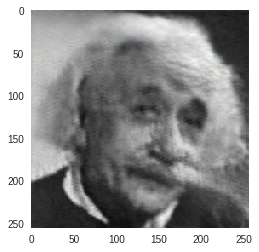

[521, 75 s] loss: 0.001 
[522, 75 s] loss: 0.001 
[523, 75 s] loss: 0.001 
[524, 75 s] loss: 0.001 
[525, 75 s] loss: 0.001 
[526, 75 s] loss: 0.001 
[527, 76 s] loss: 0.001 
[528, 76 s] loss: 0.001 
[529, 76 s] loss: 0.001 
[530, 76 s] loss: 0.001 
[531, 76 s] loss: 0.001 
[532, 76 s] loss: 0.001 
[533, 76 s] loss: 0.001 
[534, 76 s] loss: 0.001 
[535, 76 s] loss: 0.001 
[536, 76 s] loss: 0.001 
[537, 76 s] loss: 0.001 
[538, 76 s] loss: 0.001 
[539, 76 s] loss: 0.001 
[540, 76 s] loss: 0.001 


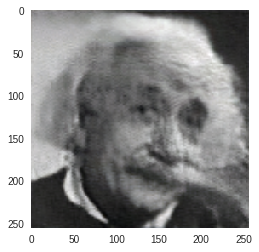

[541, 78 s] loss: 0.001 
[542, 78 s] loss: 0.001 
[543, 78 s] loss: 0.001 
[544, 78 s] loss: 0.001 
[545, 78 s] loss: 0.001 
[546, 78 s] loss: 0.001 
[547, 78 s] loss: 0.001 
[548, 78 s] loss: 0.001 
[549, 78 s] loss: 0.001 
[550, 78 s] loss: 0.001 
[551, 78 s] loss: 0.001 
[552, 79 s] loss: 0.001 
[553, 79 s] loss: 0.001 
[554, 79 s] loss: 0.001 
[555, 79 s] loss: 0.001 
[556, 79 s] loss: 0.001 
[557, 79 s] loss: 0.001 
[558, 79 s] loss: 0.001 
[559, 79 s] loss: 0.001 
[560, 79 s] loss: 0.001 


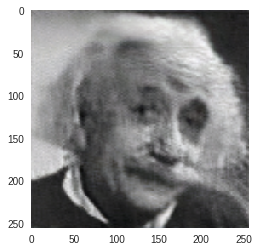

[561, 80 s] loss: 0.001 
[562, 81 s] loss: 0.001 
[563, 81 s] loss: 0.001 
[564, 81 s] loss: 0.001 
[565, 81 s] loss: 0.001 
[566, 81 s] loss: 0.001 
[567, 81 s] loss: 0.001 
[568, 81 s] loss: 0.001 
[569, 81 s] loss: 0.001 
[570, 81 s] loss: 0.001 
[571, 81 s] loss: 0.001 
[572, 81 s] loss: 0.001 
[573, 81 s] loss: 0.001 
[574, 81 s] loss: 0.001 
[575, 82 s] loss: 0.001 
[576, 82 s] loss: 0.001 
[577, 82 s] loss: 0.001 
[578, 82 s] loss: 0.001 
[579, 82 s] loss: 0.001 
[580, 82 s] loss: 0.001 


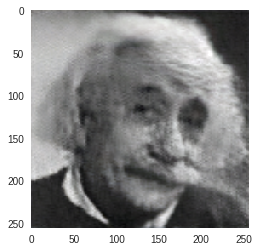

[581, 83 s] loss: 0.001 
[582, 83 s] loss: 0.001 
[583, 83 s] loss: 0.001 
[584, 83 s] loss: 0.001 
[585, 84 s] loss: 0.001 
[586, 84 s] loss: 0.001 
[587, 84 s] loss: 0.001 
[588, 84 s] loss: 0.001 
[589, 84 s] loss: 0.001 
[590, 84 s] loss: 0.001 
[591, 84 s] loss: 0.001 
[592, 84 s] loss: 0.001 
[593, 84 s] loss: 0.001 
[594, 84 s] loss: 0.001 
[595, 84 s] loss: 0.001 
[596, 84 s] loss: 0.001 
[597, 84 s] loss: 0.001 
[598, 84 s] loss: 0.001 
[599, 85 s] loss: 0.001 
[600, 85 s] loss: 0.001 


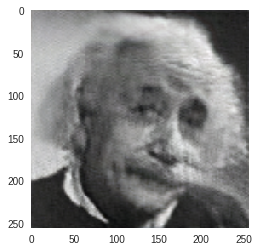

[601, 86 s] loss: 0.001 
[602, 86 s] loss: 0.001 
[603, 86 s] loss: 0.001 
[604, 86 s] loss: 0.001 
[605, 86 s] loss: 0.001 
[606, 86 s] loss: 0.001 
[607, 86 s] loss: 0.001 
[608, 86 s] loss: 0.001 
[609, 86 s] loss: 0.001 
[610, 86 s] loss: 0.001 
[611, 87 s] loss: 0.001 
[612, 87 s] loss: 0.001 
[613, 87 s] loss: 0.001 
[614, 87 s] loss: 0.001 
[615, 87 s] loss: 0.001 
[616, 87 s] loss: 0.001 
[617, 87 s] loss: 0.001 
[618, 87 s] loss: 0.001 
[619, 87 s] loss: 0.001 
[620, 87 s] loss: 0.001 


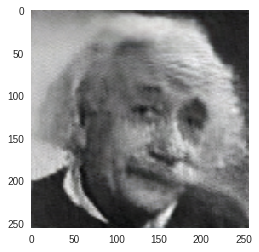

[621, 89 s] loss: 0.001 
[622, 89 s] loss: 0.001 
[623, 89 s] loss: 0.001 
[624, 89 s] loss: 0.001 
[625, 89 s] loss: 0.001 
[626, 89 s] loss: 0.001 
[627, 89 s] loss: 0.001 
[628, 89 s] loss: 0.001 
[629, 89 s] loss: 0.001 
[630, 89 s] loss: 0.001 
[631, 89 s] loss: 0.001 
[632, 89 s] loss: 0.001 
[633, 89 s] loss: 0.001 
[634, 90 s] loss: 0.001 
[635, 90 s] loss: 0.001 
[636, 90 s] loss: 0.001 
[637, 90 s] loss: 0.001 
[638, 90 s] loss: 0.001 
[639, 90 s] loss: 0.001 
[640, 90 s] loss: 0.001 


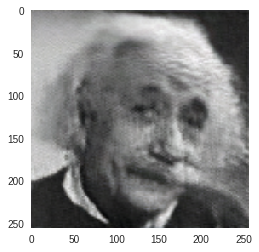

[641, 91 s] loss: 0.001 
[642, 91 s] loss: 0.001 
[643, 91 s] loss: 0.001 
[644, 91 s] loss: 0.001 
[645, 91 s] loss: 0.001 
[646, 92 s] loss: 0.001 
[647, 92 s] loss: 0.001 
[648, 92 s] loss: 0.001 
[649, 92 s] loss: 0.001 
[650, 92 s] loss: 0.001 
[651, 92 s] loss: 0.001 
[652, 92 s] loss: 0.001 
[653, 92 s] loss: 0.001 
[654, 92 s] loss: 0.001 
[655, 92 s] loss: 0.001 
[656, 92 s] loss: 0.001 
[657, 92 s] loss: 0.001 
[658, 92 s] loss: 0.001 
[659, 93 s] loss: 0.001 
[660, 93 s] loss: 0.001 


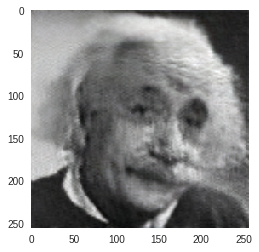

[661, 94 s] loss: 0.001 
[662, 94 s] loss: 0.001 
[663, 94 s] loss: 0.001 
[664, 94 s] loss: 0.001 
[665, 94 s] loss: 0.001 
[666, 94 s] loss: 0.001 
[667, 94 s] loss: 0.001 
[668, 95 s] loss: 0.001 
[669, 95 s] loss: 0.001 
[670, 95 s] loss: 0.001 
[671, 95 s] loss: 0.001 
[672, 95 s] loss: 0.001 
[673, 95 s] loss: 0.001 
[674, 95 s] loss: 0.001 
[675, 95 s] loss: 0.001 
[676, 95 s] loss: 0.001 
[677, 95 s] loss: 0.001 
[678, 95 s] loss: 0.001 
[679, 95 s] loss: 0.001 
[680, 95 s] loss: 0.001 


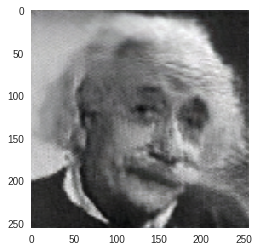

[681, 97 s] loss: 0.001 
[682, 97 s] loss: 0.001 
[683, 97 s] loss: 0.001 
[684, 97 s] loss: 0.001 
[685, 97 s] loss: 0.001 
[686, 97 s] loss: 0.001 
[687, 97 s] loss: 0.001 
[688, 97 s] loss: 0.001 
[689, 97 s] loss: 0.001 
[690, 97 s] loss: 0.001 
[691, 97 s] loss: 0.001 
[692, 98 s] loss: 0.001 
[693, 98 s] loss: 0.001 
[694, 98 s] loss: 0.001 
[695, 98 s] loss: 0.001 
[696, 98 s] loss: 0.001 
[697, 98 s] loss: 0.001 
[698, 98 s] loss: 0.001 
[699, 98 s] loss: 0.001 
[700, 98 s] loss: 0.001 


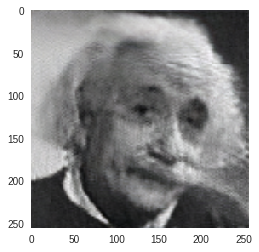

[701, 100 s] loss: 0.001 
[702, 100 s] loss: 0.001 
[703, 100 s] loss: 0.001 
[704, 100 s] loss: 0.001 
[705, 100 s] loss: 0.001 
[706, 100 s] loss: 0.001 
[707, 100 s] loss: 0.001 
[708, 100 s] loss: 0.001 
[709, 100 s] loss: 0.001 
[710, 100 s] loss: 0.001 
[711, 100 s] loss: 0.001 
[712, 100 s] loss: 0.001 
[713, 100 s] loss: 0.001 
[714, 101 s] loss: 0.001 
[715, 101 s] loss: 0.001 
[716, 101 s] loss: 0.001 
[717, 101 s] loss: 0.001 
[718, 101 s] loss: 0.001 
[719, 101 s] loss: 0.001 
[720, 101 s] loss: 0.001 


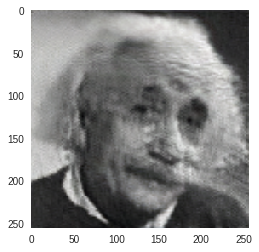

[721, 102 s] loss: 0.001 
[722, 102 s] loss: 0.001 
[723, 102 s] loss: 0.001 
[724, 103 s] loss: 0.001 
[725, 103 s] loss: 0.001 
[726, 103 s] loss: 0.001 
[727, 103 s] loss: 0.001 
[728, 103 s] loss: 0.001 
[729, 103 s] loss: 0.001 
[730, 103 s] loss: 0.001 
[731, 103 s] loss: 0.001 
[732, 103 s] loss: 0.001 
[733, 103 s] loss: 0.001 
[734, 103 s] loss: 0.001 
[735, 103 s] loss: 0.001 
[736, 103 s] loss: 0.001 
[737, 103 s] loss: 0.001 
[738, 104 s] loss: 0.001 
[739, 104 s] loss: 0.001 
[740, 104 s] loss: 0.001 


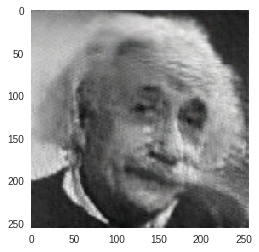

[741, 105 s] loss: 0.001 
[742, 105 s] loss: 0.001 
[743, 105 s] loss: 0.001 
[744, 105 s] loss: 0.001 
[745, 105 s] loss: 0.001 
[746, 105 s] loss: 0.001 
[747, 105 s] loss: 0.001 
[748, 106 s] loss: 0.001 
[749, 106 s] loss: 0.001 
[750, 106 s] loss: 0.001 
[751, 106 s] loss: 0.001 
[752, 106 s] loss: 0.001 
[753, 106 s] loss: 0.001 
[754, 106 s] loss: 0.001 
[755, 106 s] loss: 0.001 
[756, 106 s] loss: 0.001 
[757, 106 s] loss: 0.001 
[758, 106 s] loss: 0.001 
[759, 106 s] loss: 0.001 
[760, 106 s] loss: 0.001 


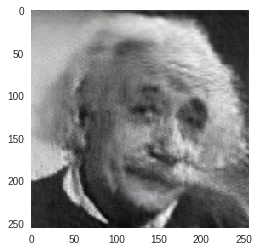

[761, 108 s] loss: 0.001 
[762, 108 s] loss: 0.001 
[763, 108 s] loss: 0.001 
[764, 108 s] loss: 0.001 
[765, 108 s] loss: 0.001 
[766, 108 s] loss: 0.001 
[767, 108 s] loss: 0.001 
[768, 108 s] loss: 0.001 
[769, 109 s] loss: 0.001 
[770, 109 s] loss: 0.001 
[771, 109 s] loss: 0.001 
[772, 109 s] loss: 0.001 
[773, 109 s] loss: 0.001 
[774, 109 s] loss: 0.001 
[775, 109 s] loss: 0.001 
[776, 109 s] loss: 0.001 
[777, 109 s] loss: 0.001 
[778, 109 s] loss: 0.001 
[779, 109 s] loss: 0.001 
[780, 109 s] loss: 0.001 


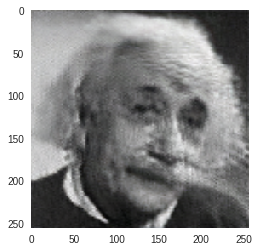

[781, 111 s] loss: 0.001 
[782, 111 s] loss: 0.001 
[783, 111 s] loss: 0.001 
[784, 111 s] loss: 0.001 
[785, 111 s] loss: 0.001 
[786, 111 s] loss: 0.001 
[787, 111 s] loss: 0.001 
[788, 111 s] loss: 0.001 
[789, 111 s] loss: 0.001 
[790, 111 s] loss: 0.001 
[791, 111 s] loss: 0.001 
[792, 111 s] loss: 0.001 
[793, 112 s] loss: 0.001 
[794, 112 s] loss: 0.001 
[795, 112 s] loss: 0.001 
[796, 112 s] loss: 0.001 
[797, 112 s] loss: 0.001 
[798, 112 s] loss: 0.001 
[799, 112 s] loss: 0.001 
[800, 112 s] loss: 0.001 


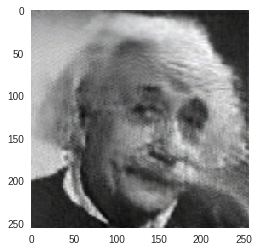

[801, 113 s] loss: 0.001 
[802, 114 s] loss: 0.001 
[803, 114 s] loss: 0.001 
[804, 114 s] loss: 0.001 
[805, 114 s] loss: 0.001 
[806, 114 s] loss: 0.001 
[807, 114 s] loss: 0.001 
[808, 114 s] loss: 0.001 
[809, 114 s] loss: 0.001 
[810, 114 s] loss: 0.001 
[811, 114 s] loss: 0.001 
[812, 114 s] loss: 0.001 
[813, 114 s] loss: 0.001 
[814, 114 s] loss: 0.001 
[815, 114 s] loss: 0.001 
[816, 115 s] loss: 0.001 
[817, 115 s] loss: 0.001 
[818, 115 s] loss: 0.001 
[819, 115 s] loss: 0.001 
[820, 115 s] loss: 0.001 


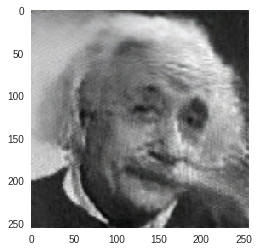

[821, 116 s] loss: 0.001 
[822, 116 s] loss: 0.001 
[823, 116 s] loss: 0.001 
[824, 116 s] loss: 0.001 
[825, 116 s] loss: 0.001 
[826, 116 s] loss: 0.001 
[827, 117 s] loss: 0.001 
[828, 117 s] loss: 0.001 
[829, 117 s] loss: 0.001 
[830, 117 s] loss: 0.001 
[831, 117 s] loss: 0.001 
[832, 117 s] loss: 0.001 
[833, 117 s] loss: 0.001 
[834, 117 s] loss: 0.001 
[835, 117 s] loss: 0.001 
[836, 117 s] loss: 0.001 
[837, 117 s] loss: 0.001 
[838, 117 s] loss: 0.001 
[839, 117 s] loss: 0.001 
[840, 118 s] loss: 0.001 


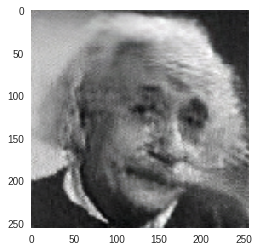

[841, 119 s] loss: 0.001 
[842, 119 s] loss: 0.001 
[843, 119 s] loss: 0.001 
[844, 119 s] loss: 0.001 
[845, 119 s] loss: 0.001 
[846, 119 s] loss: 0.001 
[847, 119 s] loss: 0.001 
[848, 119 s] loss: 0.001 
[849, 119 s] loss: 0.001 
[850, 120 s] loss: 0.001 
[851, 120 s] loss: 0.001 
[852, 120 s] loss: 0.001 
[853, 120 s] loss: 0.001 
[854, 120 s] loss: 0.001 
[855, 120 s] loss: 0.001 
[856, 120 s] loss: 0.001 
[857, 120 s] loss: 0.001 
[858, 120 s] loss: 0.001 
[859, 120 s] loss: 0.001 
[860, 120 s] loss: 0.001 


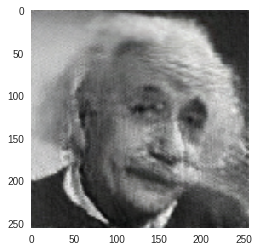

[861, 122 s] loss: 0.001 
[862, 122 s] loss: 0.001 
[863, 122 s] loss: 0.001 
[864, 122 s] loss: 0.001 
[865, 122 s] loss: 0.001 
[866, 122 s] loss: 0.001 
[867, 122 s] loss: 0.001 
[868, 122 s] loss: 0.001 
[869, 122 s] loss: 0.001 
[870, 122 s] loss: 0.001 
[871, 122 s] loss: 0.001 
[872, 122 s] loss: 0.001 
[873, 123 s] loss: 0.001 
[874, 123 s] loss: 0.001 
[875, 123 s] loss: 0.001 
[876, 123 s] loss: 0.001 
[877, 123 s] loss: 0.001 
[878, 123 s] loss: 0.001 
[879, 123 s] loss: 0.001 
[880, 123 s] loss: 0.001 


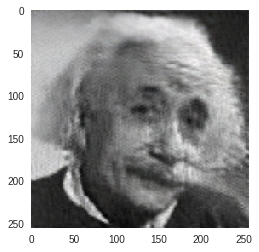

[881, 124 s] loss: 0.001 
[882, 124 s] loss: 0.001 
[883, 124 s] loss: 0.001 
[884, 124 s] loss: 0.001 
[885, 124 s] loss: 0.001 
[886, 125 s] loss: 0.001 
[887, 125 s] loss: 0.001 
[888, 125 s] loss: 0.001 
[889, 125 s] loss: 0.001 
[890, 125 s] loss: 0.001 
[891, 125 s] loss: 0.001 
[892, 125 s] loss: 0.001 
[893, 125 s] loss: 0.001 
[894, 125 s] loss: 0.001 
[895, 125 s] loss: 0.001 
[896, 125 s] loss: 0.001 
[897, 125 s] loss: 0.001 
[898, 125 s] loss: 0.001 
[899, 126 s] loss: 0.001 
[900, 126 s] loss: 0.001 


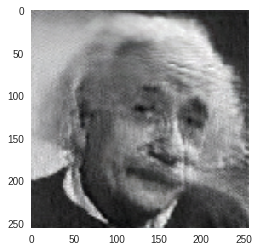

[901, 127 s] loss: 0.001 
[902, 127 s] loss: 0.001 
[903, 127 s] loss: 0.001 
[904, 127 s] loss: 0.001 
[905, 127 s] loss: 0.001 
[906, 127 s] loss: 0.001 
[907, 127 s] loss: 0.000 
[908, 127 s] loss: 0.001 
[909, 128 s] loss: 0.001 
[910, 128 s] loss: 0.000 
[911, 128 s] loss: 0.001 
[912, 128 s] loss: 0.001 
[913, 128 s] loss: 0.001 
[914, 128 s] loss: 0.001 
[915, 128 s] loss: 0.001 
[916, 128 s] loss: 0.001 
[917, 128 s] loss: 0.001 
[918, 128 s] loss: 0.001 
[919, 128 s] loss: 0.000 
[920, 128 s] loss: 0.000 


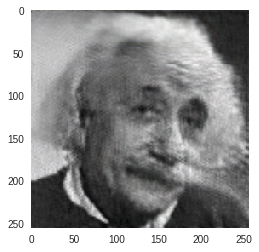

[921, 130 s] loss: 0.000 
[922, 130 s] loss: 0.001 
[923, 130 s] loss: 0.001 
[924, 130 s] loss: 0.000 
[925, 130 s] loss: 0.001 
[926, 130 s] loss: 0.001 
[927, 130 s] loss: 0.001 
[928, 130 s] loss: 0.001 
[929, 131 s] loss: 0.001 
[930, 131 s] loss: 0.001 
[931, 131 s] loss: 0.001 
[932, 131 s] loss: 0.001 
[933, 131 s] loss: 0.001 
[934, 131 s] loss: 0.001 
[935, 131 s] loss: 0.001 
[936, 131 s] loss: 0.001 
[937, 131 s] loss: 0.001 
[938, 131 s] loss: 0.001 
[939, 131 s] loss: 0.000 
[940, 131 s] loss: 0.001 


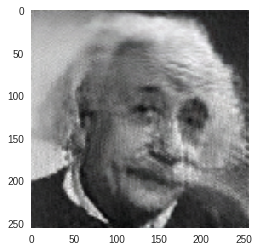

[941, 133 s] loss: 0.001 
[942, 133 s] loss: 0.000 
[943, 133 s] loss: 0.001 
[944, 133 s] loss: 0.000 
[945, 133 s] loss: 0.001 
[946, 133 s] loss: 0.001 
[947, 133 s] loss: 0.001 
[948, 133 s] loss: 0.001 
[949, 133 s] loss: 0.001 
[950, 133 s] loss: 0.000 
[951, 133 s] loss: 0.001 
[952, 133 s] loss: 0.001 
[953, 134 s] loss: 0.001 
[954, 134 s] loss: 0.001 
[955, 134 s] loss: 0.001 
[956, 134 s] loss: 0.001 
[957, 134 s] loss: 0.001 
[958, 134 s] loss: 0.000 
[959, 134 s] loss: 0.001 
[960, 134 s] loss: 0.001 


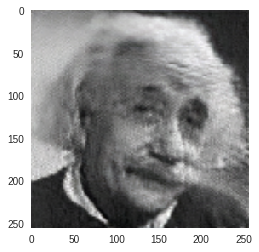

[961, 136 s] loss: 0.000 
[962, 136 s] loss: 0.001 
[963, 136 s] loss: 0.000 
[964, 136 s] loss: 0.000 
[965, 136 s] loss: 0.001 
[966, 136 s] loss: 0.000 
[967, 136 s] loss: 0.000 
[968, 137 s] loss: 0.000 
[969, 137 s] loss: 0.000 
[970, 137 s] loss: 0.001 
[971, 137 s] loss: 0.001 
[972, 137 s] loss: 0.000 
[973, 137 s] loss: 0.000 
[974, 137 s] loss: 0.000 
[975, 137 s] loss: 0.000 
[976, 137 s] loss: 0.000 
[977, 137 s] loss: 0.000 
[978, 137 s] loss: 0.000 
[979, 137 s] loss: 0.000 
[980, 137 s] loss: 0.000 


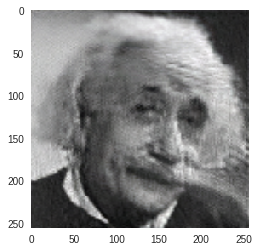

[981, 139 s] loss: 0.000 
[982, 139 s] loss: 0.000 
[983, 139 s] loss: 0.000 
[984, 139 s] loss: 0.000 
[985, 139 s] loss: 0.000 
[986, 139 s] loss: 0.000 
[987, 139 s] loss: 0.000 
[988, 139 s] loss: 0.000 
[989, 139 s] loss: 0.000 
[990, 139 s] loss: 0.000 
[991, 140 s] loss: 0.000 
[992, 140 s] loss: 0.001 
[993, 140 s] loss: 0.000 
[994, 140 s] loss: 0.000 
[995, 140 s] loss: 0.001 
[996, 140 s] loss: 0.000 
[997, 140 s] loss: 0.000 
[998, 140 s] loss: 0.000 
[999, 140 s] loss: 0.000 
[1000, 140 s] loss: 0.000 
Final train loss
0.00045144432806409895
Finished Training. See training time on next line
140


In [18]:
#Set up Training
#Loss Function = MSE
#Get image in Tensor form. This is the label
dtype = torch.cuda.FloatTensor

print('Started Training')
startime = time.time();

maxepochs = 1000
numepochs = 0

# horizon = 5

acc = []
trainLoss = []

downsampler = Downsample(n_planes=3, factor=4, preserve_size=True).type(dtype)

for epoch in range(maxepochs):  # loop over the data multiple times  
  
    # get the input
    inputs = superResolutionBase #this is the z = uniform noise input
    
    # get the label
    label = lowres_image

    # wrap them in Variable
    inputs, label = inputs.cuda(), label.cuda()

    # zero the parameter gradients
    optimizer.zero_grad()
    
    inputs = addRandomNoise(inputs)
    
    # forward + backward + optimize
    outputs = net(inputs)
    downsampledOutputs = downsampler(outputs)
    loss = criterion(downsampledOutputs[0], label)
    loss.backward()
    optimizer.step()
    
    #save the image every 20 epochs
    if epoch%20==0:
        pp = PdfPages('einstein' + str(epoch) + '.pdf')
        
        arr = np.array(outputs[0].data)
        arr = arr.transpose((1,2,0))
        arr = np.clip(arr, 0, 1)
        plt.rcParams["axes.grid"] = False
        plt.imshow(arr)
        plt.savefig(pp, format='pdf')
        pp.close()
        
        file1 = drive.CreateFile()
        file1.SetContentFile('einstein' + str(epoch) + '.pdf')
        file1.Upload() # Upload the file.
        plt.show()
        
    #print some results
    if epoch == 0:
        k = -1
    else:
        k = -2
    print('[%d, %d s] loss: %.3f '% (epoch + 1, int(time.time() - startime), loss.data[0]))
    numepochs = numepochs + 1
    
    trainLoss.append(loss.data[0])

print("Final train loss")
print(trainLoss[len(trainLoss)-1])

print('Finished Training. See training time on next line')
print(int(time.time() - startime))

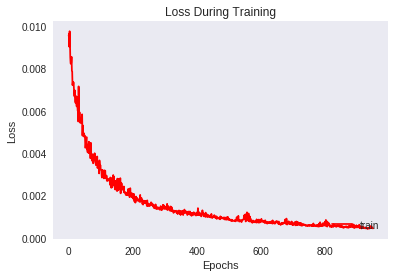

In [19]:
plt.figure()
plt.title('Loss During Training')
plt.xlabel('Epochs')
plt.ylabel('Loss')
#because loss is very high in the early iteration,
#we cut off the first 50 to make the graph meaningful
plt.plot(trainLoss[50:], 'r', label="train")
plt.legend(loc=4)
plt.show()

# Subtitle extraction for subtitle inpainting dip network (SIDN)

We are creating the masks used in inpainting dip.
Specifically, we are creating filters for subtitle extracting.
The original images themselves are frames from the movie Annie Hall: https://www.youtube.com/watch?v=3tcH2zSqVCc

In [0]:
#1AY63mgg2926Z2XtxXvzez3hxdWhU0KDb -- main folder (no useful files in there)
  #1gNp7MLzRkLDOwgmdT-j0XLAVQ9zACR_z -- original8frames
  #1n7iCwVNkUtMZE9TyRMXvo2bCPn82-Od1 -- 8otherframes (not used yet!), these frames don't have any subtitles on them
  #1KqhEYNBtiQRsM-WmoWcSEdt1V5iprxFc -- contains original8frames plus processed data (mask, nosubs, subsnoimage) all in 1, used in next section

# Fetch the folder with all the annie hall images
file_list = drive.ListFile({'q': "'1gNp7MLzRkLDOwgmdT-j0XLAVQ9zACR_z' in parents and trashed=false"}).GetList()

In [21]:
i = 1
for file1 in sorted(file_list, key = lambda x: x['title']):
    print('Downloading {} from GDrive ({}/{})'.format(file1['title'], i, len(file_list)))
    file1.GetContentFile(file1['title'])
    i += 1

In [0]:
#This function makes a mask from an image where the pixels corresponding to
#the subtitles in the image are 1 in the mask, and other pixels are 0

#This algorithm is general enough that it works as long as:
  # The pixels from the subtitles are (relatively) uniform in color
  # The range of pixels across the rest of the pictures excludes the uniform color used for the subtitles (it's yellow in this case)
  
#The two paramters to set are
  # The color of the subtitles (see comments lines 18-19 and line 22)
  # The radius of pixels you want to mask around detected subtitle pixels (line 26)

#This is not perfect, but we were not very conservative around the subtitles but very conservative around the image
#The dataset (this scene from Annie Hall: https://www.youtube.com/watch?v=3tcH2zSqVCc) this was designed for fulfills the conditions well :)
def makeMask(img):
  out1 = np.zeros(img[:,:,0].shape)
  out2 = np.zeros(img[:,:,0].shape)
  
  #catch yellow ones (by yellow we mean our mildly arbitrary range)
  #we used https://imagecolorpicker.com/
  for i in range(500,img.shape[0]):
    for j in range(img.shape[1]):
      if img[i,j,0]>.9 and img[i,j,1]>.9 and img[i,j,2]>.05 and img[i,j,2]<.6:
        out1[i,j] = 1.
  
  #make everyone within radius of yellow one yellow
  radius = 5 #higher is more liberal with masking nonsubtitle pixels, but if it's too low doesn't catch them all :(
  for i in range(radius,img.shape[0]-radius-1):
    for j in range(radius,img.shape[1]-radius-1):
      for k in range(-radius,radius+1):
        for l in range(-radius,radius+1):
          if out1[i+k,j+l]==1:
            out2[i,j] = 1.
  
  #apply the same mask on 3 channels
  finalOut = np.zeros(img.shape)
  finalOut[:,:,0] = 1-out2
  finalOut[:,:,1] = 1-out2
  finalOut[:,:,2] = 1-out2
  
  return finalOut

Dealing with image 1


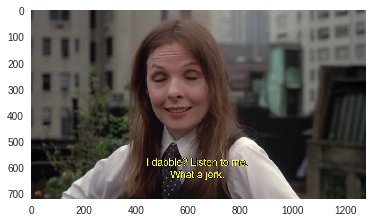

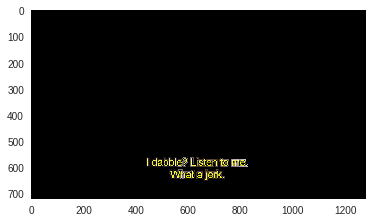

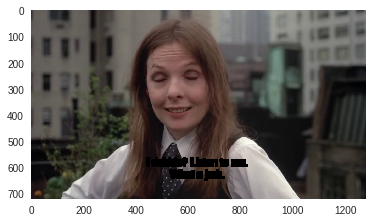

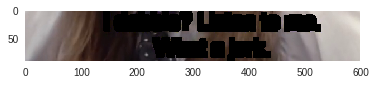

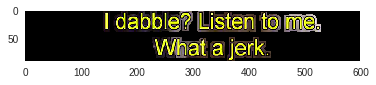

Dealing with image 2


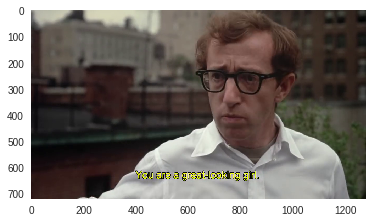

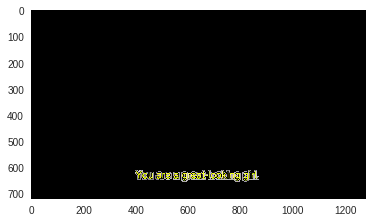

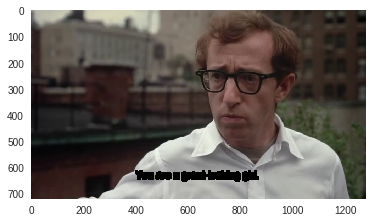

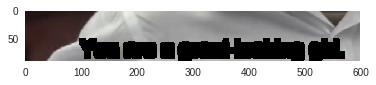

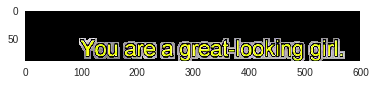

Dealing with image 3


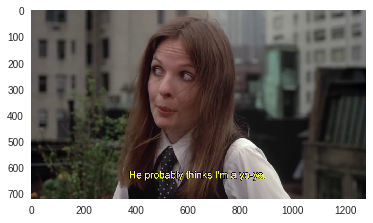

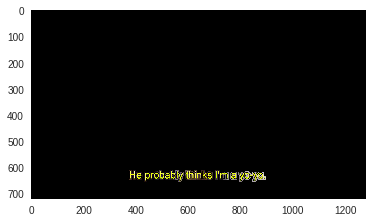

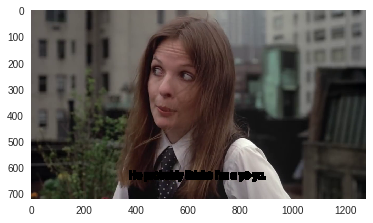

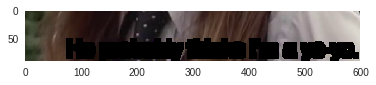

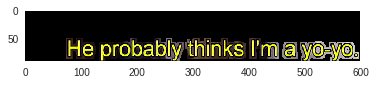

Dealing with image 4


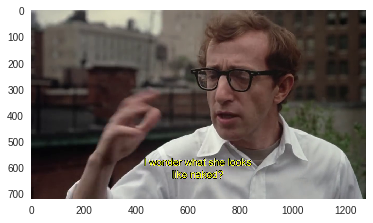

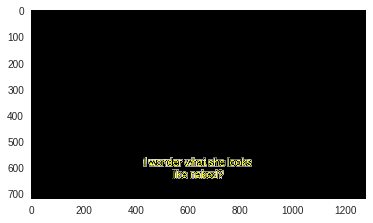

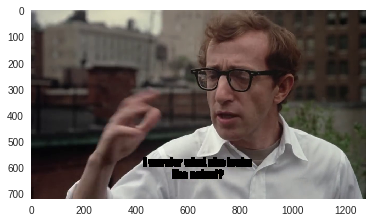

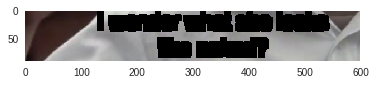

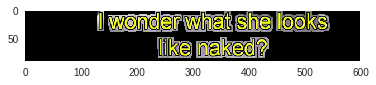

Dealing with image 5


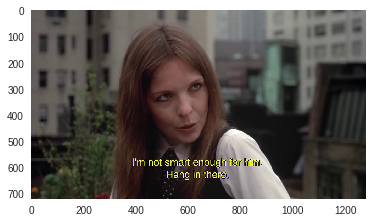

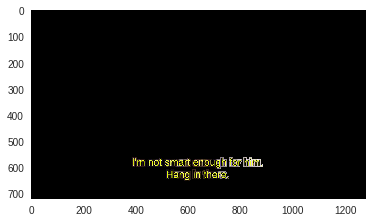

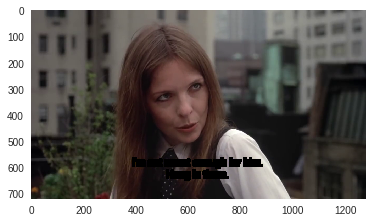

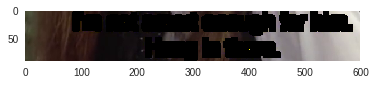

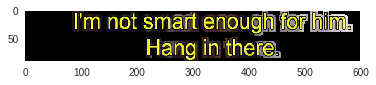

Dealing with image 6


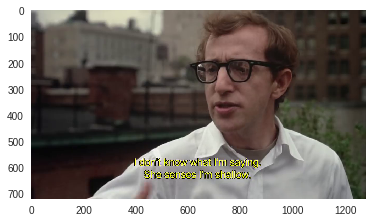

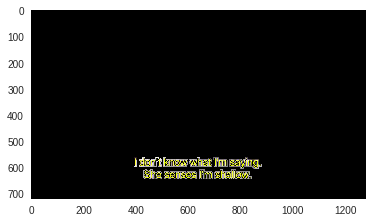

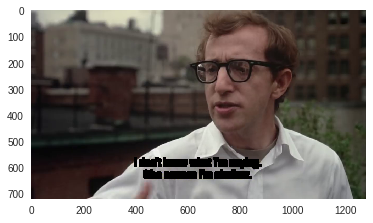

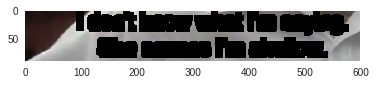

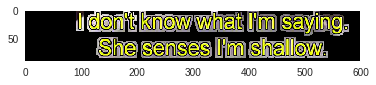

Dealing with image 7


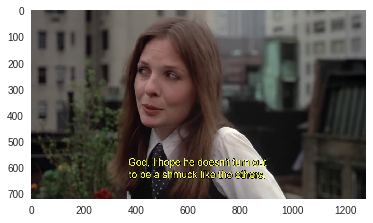

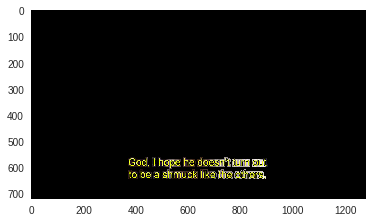

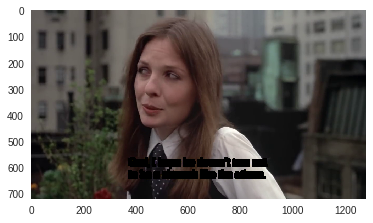

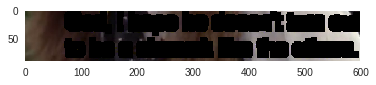

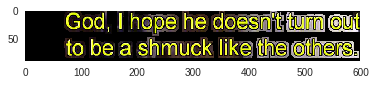

Dealing with image 8


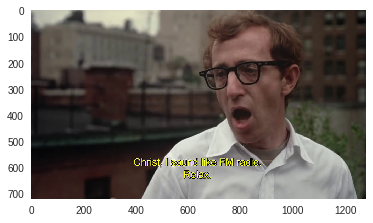

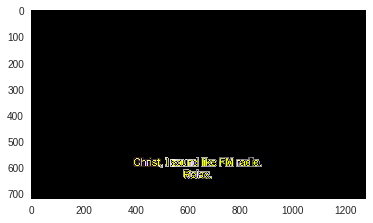

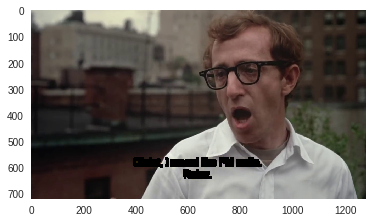

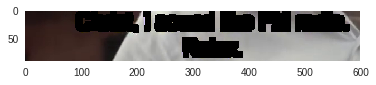

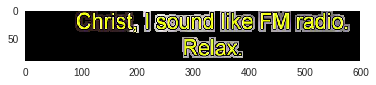

In [23]:
#Do NOT run this again -- it takes a lot of itme and we have the outputs saved in gdrive
#This code is used both for testing and saving stuff, you can comment stuff out

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import scipy.misc

for i in range(1,9):
  print("Dealing with image " + str(i))
  
  #show original picture
  image = mpimg.imread('snapshot' + str(i) + '.png')
  plt.rcParams["axes.grid"] = False
  plt.imshow(image)
  plt.show()

  #make mask and subs/nosubs image
  myMask = makeMask(image)
  onlysubs = np.multiply(image, 1-myMask) #use this if you wanna see just the subs!
  withoutsubs = np.multiply(image, myMask) #use this if you wanna see img without subs!

  #show subs/nosubs image
  plt.imshow(onlysubs)
  plt.show()
  plt.imshow(withoutsubs)
  plt.show()
  
  #check and diagnose in more depth
  plt.imshow(withoutsubs[560:650,300:900,:])
  plt.show()
  plt.imshow(onlysubs[560:650,300:900,:])
  plt.show()
  
  #save the images
  scipy.misc.imsave('snapshot' + str(i) + '_mask.png', myMask)
  scipy.misc.imsave('snapshot' + str(i) + '_withoutsubs.png', withoutsubs)  
  scipy.misc.imsave('snapshot' + str(i) + '_onlysubs.png', onlysubs)

In [24]:
#make sure we have all the files
dir = os.listdir('.')
dir.sort()
print(dir)

['.config', 'adc.json', 'einstein0.pdf', 'einstein100.pdf', 'einstein120.pdf', 'einstein140.pdf', 'einstein160.pdf', 'einstein180.pdf', 'einstein20.pdf', 'einstein200.pdf', 'einstein220.pdf', 'einstein240.pdf', 'einstein260.pdf', 'einstein280.pdf', 'einstein300.pdf', 'einstein320.pdf', 'einstein340.pdf', 'einstein360.pdf', 'einstein380.pdf', 'einstein40.pdf', 'einstein400.pdf', 'einstein420.pdf', 'einstein440.pdf', 'einstein460.pdf', 'einstein480.pdf', 'einstein500.pdf', 'einstein520.pdf', 'einstein540.pdf', 'einstein560.pdf', 'einstein580.pdf', 'einstein60.pdf', 'einstein600.pdf', 'einstein620.pdf', 'einstein640.pdf', 'einstein660.pdf', 'einstein680.pdf', 'einstein700.pdf', 'einstein720.pdf', 'einstein740.pdf', 'einstein760.pdf', 'einstein780.pdf', 'einstein80.pdf', 'einstein800.pdf', 'einstein820.pdf', 'einstein840.pdf', 'einstein860.pdf', 'einstein880.pdf', 'einstein900.pdf', 'einstein920.pdf', 'einstein940.pdf', 'einstein960.pdf', 'einstein980.pdf', 'input', 'sample_data', 'snapsho

In [0]:
for i in range(1,9):
  file1 = drive.CreateFile()
  file2 = drive.CreateFile()
  file3 = drive.CreateFile()
  
  file1.SetContentFile('snapshot' + str(i) + '_mask.png')
  file2.SetContentFile('snapshot' + str(i) + '_withoutsubs.png')
  file3.SetContentFile('snapshot' + str(i) + '_onlysubs.png')
  
  file1.Upload()
  file2.Upload()
  file3.Upload()

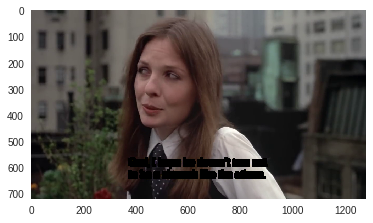

In [26]:
#show any image to make sure it got saved
image = mpimg.imread('snapshot7_withoutsubs.png')
plt.imshow(image)

# Load 8frames processed data for SIDN

In [12]:
#Download the original and processed 8frames data
file_list = drive.ListFile({'q': "'1KqhEYNBtiQRsM-WmoWcSEdt1V5iprxFc' in parents and trashed=false"}).GetList()
i = 1
for file1 in sorted(file_list, key = lambda x: x['title']):
    print('Downloading {} from GDrive ({}/{})'.format(file1['title'], i, len(file_list)))
    file1.GetContentFile(file1['title'])
    i += 1

(720, 1280, 3)

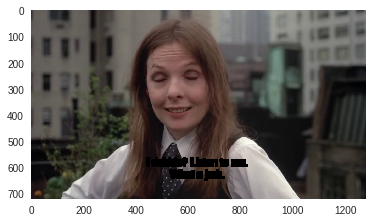

In [13]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams["axes.grid"] = False
import matplotlib.image as mpimg
import numpy as np
import scipy.misc

#for loop to loop through dataset
#for i in range(1,9):
i = 1
original = mpimg.imread('snapshot' + str(i) + '.png')
mask = mpimg.imread('snapshot' + str(i) + '_mask.png')
withoutsubs = mpimg.imread('snapshot' + str(i) + '_withoutsubs.png')
onlysubs = mpimg.imread('snapshot' + str(i) + '_onlysubs.png')

#plot any of the extracted images
plt.imshow(withoutsubs)
mask.shape

In [0]:
#crop withoutsubs and mask to make both axes a multiple of 32
withoutsubsCropped = withoutsubs[8:712,:,:]
maskCropped = mask[8:712,:,:]

# Build SIDN

In [0]:
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

LeakyReLU = nn.LeakyReLU(0.2, inplace=True)

num_channels_down=[16, 32, 64, 128, 128]
num_channels_up=[16, 32, 64, 128, 128]
num_channels_skip=[0, 0, 0, 0, 4]
num_channels_input = 32
k_down = 7
k_up = 7
k_skip = 1

padding_down = int((k_down-1)/2)
padding_up = int((k_up-1)/2)
padding_skip = int((k_skip-1)/2)

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        #-----------------------------------------------------------------------
        #----------------------------- Down blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 0 # for first
        #first down block, others are copypaste
        self.down1_downsample = nn.Conv2d(num_channels_input, num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down1_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down1_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down1_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 1
        self.down2_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down2_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down2_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down2_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 2
        self.down3_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down3_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down3_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down3_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 3
        self.down4_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down4_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down4_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down4_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 4
        self.down5_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down5_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down5_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down5_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        #-----------------------------------------------------------------------
        #----------------------------- Skip blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 4 # for 5th
        #first skip block, others are copypaste
        self.skip5_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip5_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        #-----------------------------------------------------------------------
        #--------------------------- Misc but needed ---------------------------
        #-----------------------------------------------------------------------
        
        #will need this for the up layers
        self.upsample = nn.Upsample(scale_factor=2, mode='nearest') #at the end
        num_channels_up.append(0) #this way for the fifth layers the combined is just the skip
        #will need this at the end of network
        self.makeFinalOutput = nn.Conv2d(num_channels_up[0],3,1)
        
        #-----------------------------------------------------------------------
        #------------------------------ Up blocks ------------------------------
        #-----------------------------------------------------------------------
        
        i=4 # for fifth
        #fifth up block, others are copypaste
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i]; #num_channels_up[5] is 0
        self.up5_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up5_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up5_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up5_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up5_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=3
        self.up4_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up4_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up4_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up4_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up4_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=2
        self.up3_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up3_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up3_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up3_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up3_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=1;
        self.up2_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up2_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up2_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up2_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up2_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=0
        self.up1_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up1_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up1_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up1_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up1_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
    def forward(self, x):
        #-----------------------------------------------------------------------
        #-------------------- Downsampling and recording skip ------------------
        #-----------------------------------------------------------------------
        x = LeakyReLU(self.down1_bn_downsample(self.down1_downsample(x)))
        x = LeakyReLU(self.down1_bn_justconv(self.down1_justconv(x)))
        
        x = LeakyReLU(self.down2_bn_downsample(self.down2_downsample(x)))
        x = LeakyReLU(self.down2_bn_justconv(self.down2_justconv(x)))
        
        x = LeakyReLU(self.down3_bn_downsample(self.down3_downsample(x)))
        x = LeakyReLU(self.down3_bn_justconv(self.down3_justconv(x)))
        
        x = LeakyReLU(self.down4_bn_downsample(self.down4_downsample(x)))
        x = LeakyReLU(self.down4_bn_justconv(self.down4_justconv(x)))
        
        x = LeakyReLU(self.down5_bn_downsample(self.down5_downsample(x)))
        x = LeakyReLU(self.down5_bn_justconv(self.down5_justconv(x)))
        x = self.skip5_conv(x)
        skips5 = LeakyReLU(self.skip5_bn(x))
        
        #-----------------------------------------------------------------------
        #------------------------------ Upsampling -----------------------------
        #-----------------------------------------------------------------------
        
        #we start at the fifth layer (layers have reverse order)
        x = self.up5_bn_initial(skips5) #notice no concatenation here
        x = LeakyReLU(self.up5_bn1(self.up5_conv1(x)))
        x = LeakyReLU(self.up5_bn2(self.up5_conv2(x)))
        x = self.upsample(x)
        
        #now we upsample all the other layers
        #print("up4")
        #print(x.size())
        #print(skips4.size())
        x = self.up4_bn_initial(x)
        x = LeakyReLU(self.up4_bn1(self.up4_conv1(x)))
        x = LeakyReLU(self.up4_bn2(self.up4_conv2(x)))
        x = self.upsample(x)
        
        #print("up3")
        #print(x.size())
        #print(skips3.size())
        x = self.up3_bn_initial(x)
        x = LeakyReLU(self.up3_bn1(self.up3_conv1(x)))
        x = LeakyReLU(self.up3_bn2(self.up3_conv2(x)))
        x = self.upsample(x)
        
        #print("up2")
        #print(x.size())
        #print(skips2.size())
        x = self.up2_bn_initial(x)
        x = LeakyReLU(self.up2_bn1(self.up2_conv1(x)))
        x = LeakyReLU(self.up2_bn2(self.up2_conv2(x)))
        x = self.upsample(x)
        
        #print("up1")
        #print(x.size())
        #print(skips1.size())
        x = self.up1_bn_initial(x)
        x = LeakyReLU(self.up1_bn1(self.up1_conv1(x)))
        x = LeakyReLU(self.up1_bn2(self.up1_conv2(x)))
        x = self.upsample(x)
        
        
        #-----------------------------------------------------------------------
        #------------------------------- Finalize ------------------------------
        #-----------------------------------------------------------------------

        #now we get x to the right dimensions
        x = self.makeFinalOutput(x) #not sure if we need the leaky ReLU here
        
        return x

In [0]:
#generate noisy image as input
#noiseType = "uniform"

def createNoisyImage(input_depth,dimensions,var=0.1,noiseType='uniform'):
  tensorShape = [1,input_depth,dimensions[0],dimensions[1]]
  networkInput = Variable(torch.zeros(tensorShape))
  
  if noiseType == "uniform":
    networkInput.data.uniform_()
  elif noiseType == "normal":
    networkInput.data.normal_()
  
  networkInput.data = networkInput.data * var
  
  return networkInput

#this needs to be image size times 4!
superResolutionBase = createNoisyImage(32,[maskCropped.shape[0],maskCropped.shape[1]],0.1,"uniform")
#inputs are: input_depth, [img.shape[1],img.shape[2]], var, noiseType

base = superResolutionBase.type(torch.cuda.FloatTensor).detach()
savedBase = base.data.clone()
baseNoise = base.data.clone()

In [17]:
maskCropped.shape[0]

704

In [0]:
def addRandomNoise(inputs): #we don't add noise this time!
  inputs.data = savedBase #+ baseNoise.normal_()*1.0/30
  return inputs

# Train SIDN

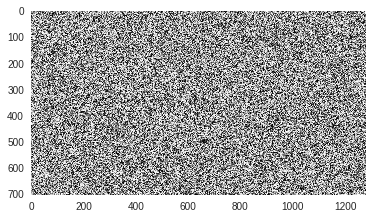

In [19]:
#plotting only
superResolutionInput = superResolutionBase.data[0,:,:,:]
#print(superResolutionInput)
plt.imshow(np.array(superResolutionInput)[30])

In [0]:
#size is [1, channels, height, width
maskedTarget = Variable(torch.Tensor(withoutsubsCropped))
maskCroppedTensor = Variable(torch.Tensor(maskCropped))

maskedTarget = maskedTarget.cuda()
maskCroppedTensor = maskCroppedTensor.cuda()

Naturally training is testing here, so we save outputs to images and upload these images to gdrive

In [0]:
# Saving any model
def save_model(model, filename):
  torch.save(model, filename)

def load_model(filename):
  model = torch.load(filename)
  model.cuda()
  return model

In [37]:
#Saving a random model
net = Net()
net.cuda()
save_model(net, 'random_init.pt')

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [0]:
net = Net()
net.cuda()

criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)

In [0]:
def train_model(net, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=3000, fname='output', inputs=superResolutionBase):
  mask = mpimg.imread(mask_fname)
  withoutsubs = mpimg.imread(withoutsubs_fname)
  withoutsubsCropped = withoutsubs[8:712,:,:]
  maskCropped = mask[8:712,:,:]
  maskedTarget = Variable(torch.Tensor(withoutsubsCropped))
  maskCroppedTensor = Variable(torch.Tensor(maskCropped))

  maskedTarget = maskedTarget.cuda()
  maskCroppedTensor = maskCroppedTensor.cuda()
  
  startime = int(time.time())
  trainLoss = []
  
  for epoch in range(maxepochs):  # loop over the data multiple times  

      # get the input
      inputs = superResolutionBase #this is the z = uniform noise input

      # get the label
      label = maskedTarget

      # wrap them in Variable
      inputs, label = inputs.cuda(), label.cuda()

      # zero the parameter gradients
      optimizer.zero_grad()

      inputs = addRandomNoise(inputs)

      #print("backpropagation time")
      # forward + backward + optimize
      outputs = net(inputs)
      outputs=outputs[0]
      outputs = outputs.permute(1,2,0)
      loss = criterion(torch.mul(outputs, maskCroppedTensor), label)
      loss.backward()
      optimizer.step()

      #if epoch%5==0:
        #print("We are at epoch " + str(epoch))

      #save the image every 100 epochs
      if epoch%100==0:
          print(epoch)
  #         pp = PdfPages('subsTest' + str(epoch) + '.pdf')

          arr = np.array(outputs.data)
          arr = np.clip(arr, 0, 1)
          plt.rcParams["axes.grid"] = False
          plt.imshow(arr)
  #         plt.savefig(pp, format='pdf')
  #         pp.close()
          plt.imsave(fname + 'subsTest' + str(epoch) + '.png', arr)
          file1 = drive.CreateFile()
          file1.SetContentFile(fname + 'subsTest' + str(epoch) + '.png')
          file1.Upload() # Upload the file.
          plt.show()

      #print some results
      if epoch == 0:
          k = -1
      else:
          k = -2
      print('[%d, %d s] loss: %.3f '% (epoch + 1, int(time.time() - startime), loss.data[0]), '\r', end='')
      trainLoss.append(loss.data[0])

  print("Final train loss")
  print(trainLoss[len(trainLoss)-1])

  print('Finished Training. See training time on next line')
  print(int(time.time() - startime))
  save_model(net, fname+'trained.pt')
  file1 = drive.CreateFile()
  file1.SetContentFile(fname+'trained.pt')
  file1.Upload() # Upload the file.
  return net

Started Training


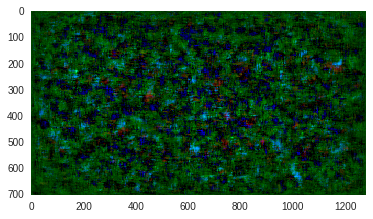

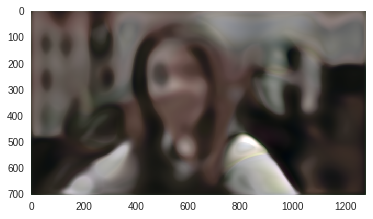

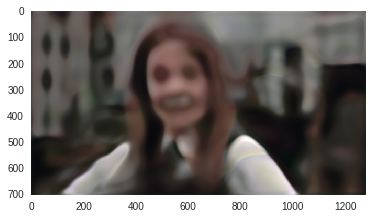

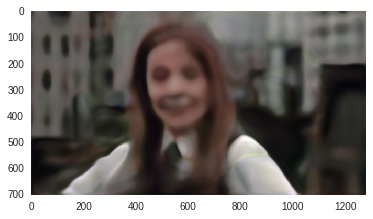

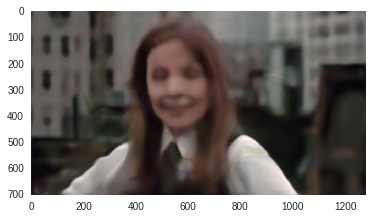

...

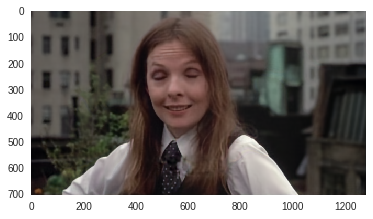

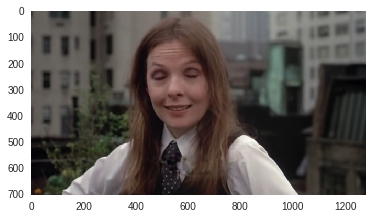

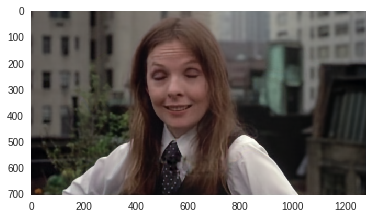

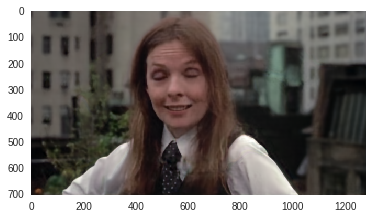

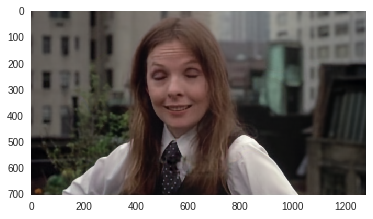

Final train loss
0.00011302519124001265
Finished Training. See training time on next line
2128


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


Net(
  (down1_downsample): Conv2d (32, 16, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down1_bn_downsample): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down1_justconv): Conv2d (16, 16, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down1_bn_justconv): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down2_downsample): Conv2d (16, 32, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down2_bn_downsample): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down2_justconv): Conv2d (32, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down2_bn_justconv): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down3_downsample): Conv2d (32, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down3_bn_downsample): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
  (down3_justconv): Conv2d (64, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down3_bn_justconv): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)

In [40]:
#Set up Training
#Loss Function = MSE
#Get image in Tensor form. This is the label
dtype = torch.cuda.FloatTensor

print('Started Training')
startime = time.time();

maxepochs = 3000
numepochs = 0

# horizon = 5

acc = []
trainLoss = []
criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)
i=1
mask_fname = 'snapshot' + str(i) + '_mask.png'
withoutsubs_fname = 'snapshot' + str(i) + '_withoutsubs.png'
train_model(net, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=3000, fname='first_train')

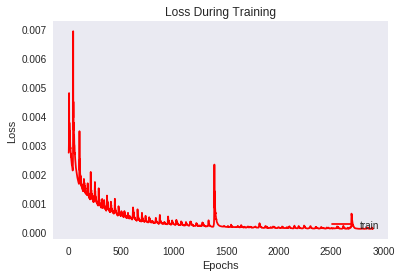

In [42]:
plt.figure()
plt.title('Loss During Training')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.plot(trainLoss[100:], 'r', label="train")
plt.legend(loc=4)
plt.show()

0


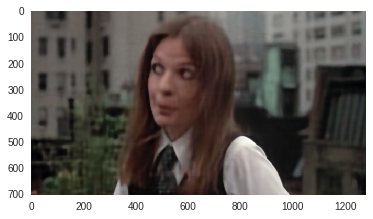

100


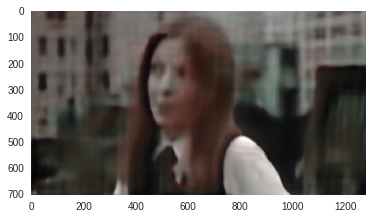

200


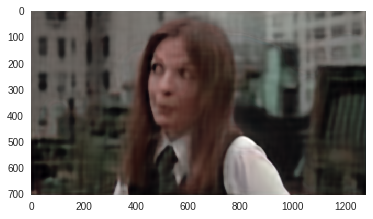

300


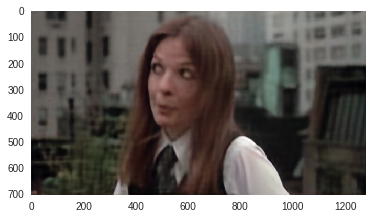

400


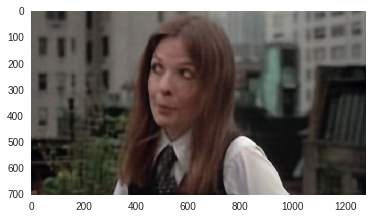

500


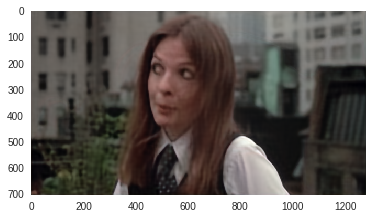

600


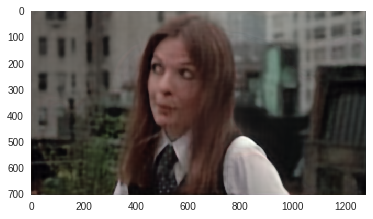

700


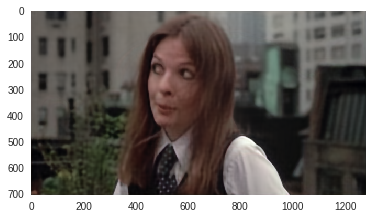

800


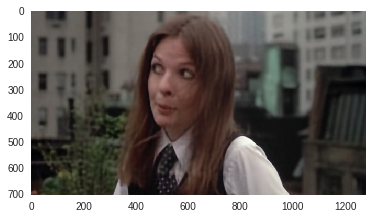

900


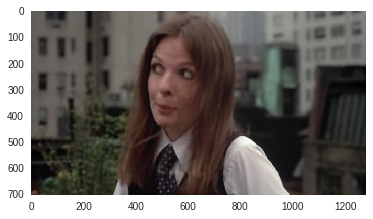

1000


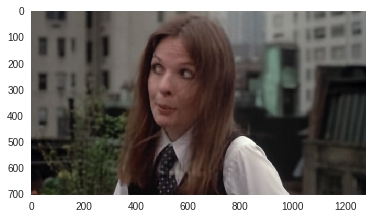

1100


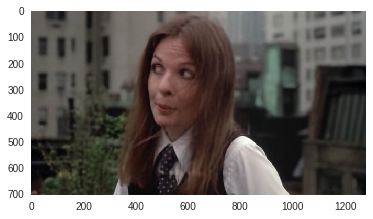

1200


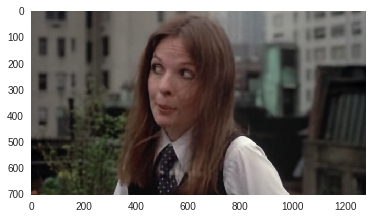

1300


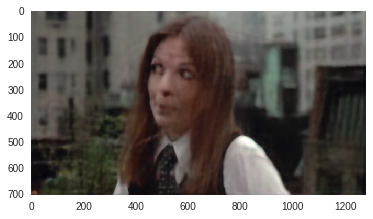

1400


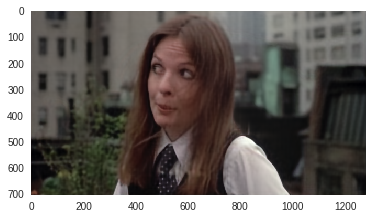

1500


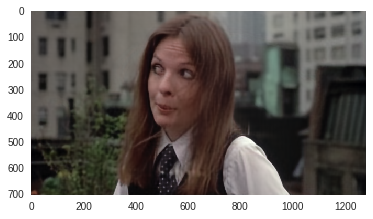

1600


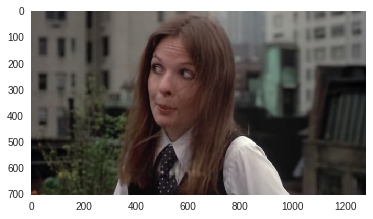

1700


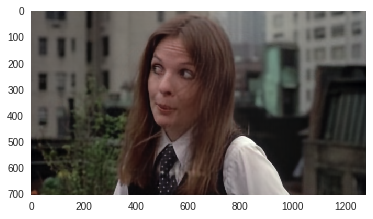

1800


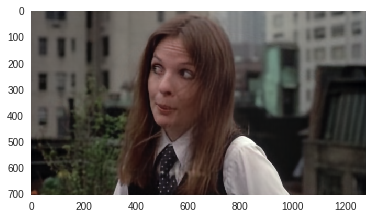

1900


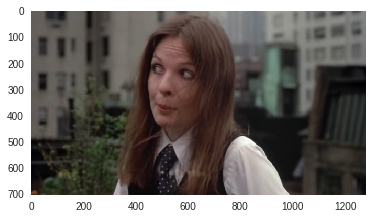

2000


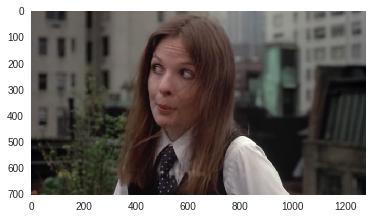

2100


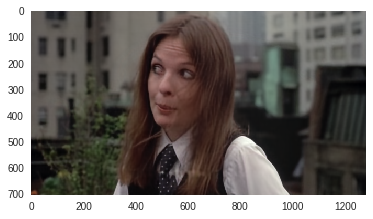

2200


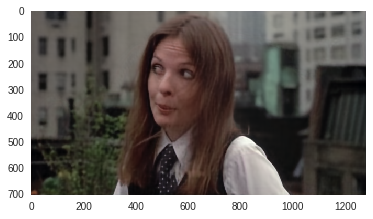

2300


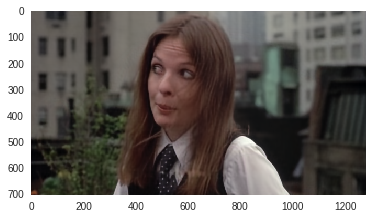

2400


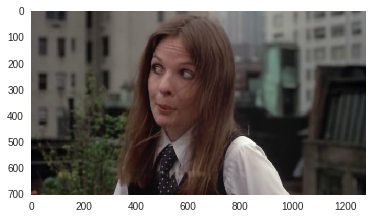

2500


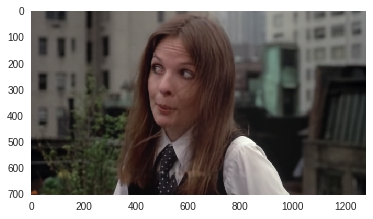

2600


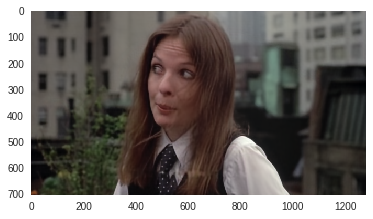

2700


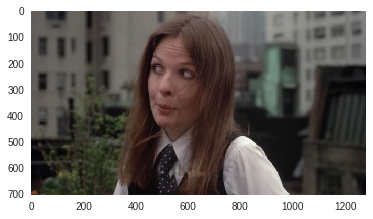

2800


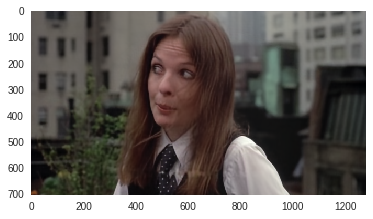

2900


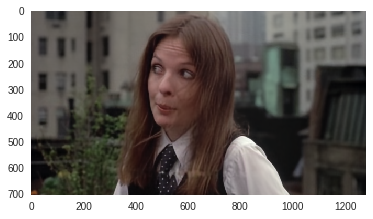

Final train loss
0.00011246116628171876
Finished Training. See training time on next line
4939


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [47]:
# Transfer Learning
model = load_model('first_traintrained.pt')
acc = []
trainLoss = []

criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)
i=3
mask_fname = 'snapshot' + str(i) + '_mask.png'
withoutsubs_fname = 'snapshot' + str(i) + '_withoutsubs.png'
model_after_transfer = train_model(net, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=3000, fname='3_transfer')

0


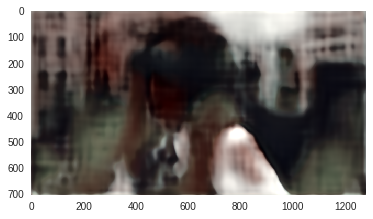

100


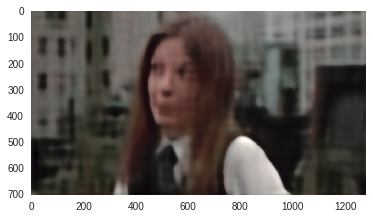

200


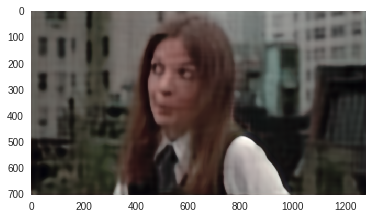

300


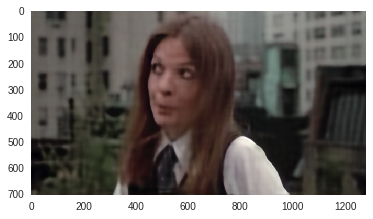

400


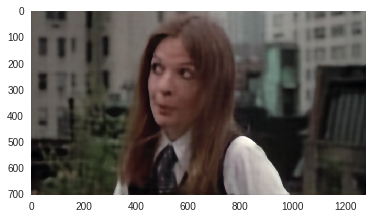

500


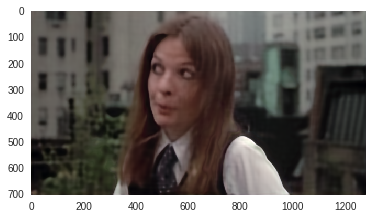

600


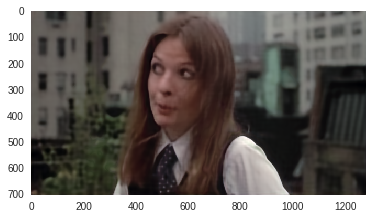

700


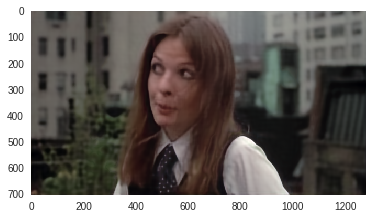

800


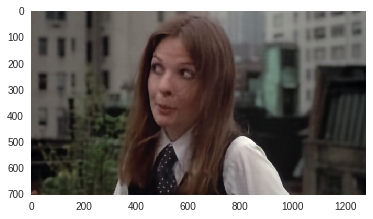

900


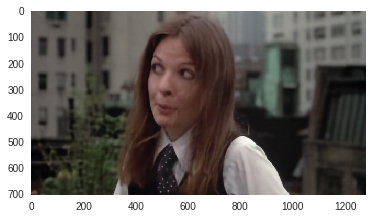

1000


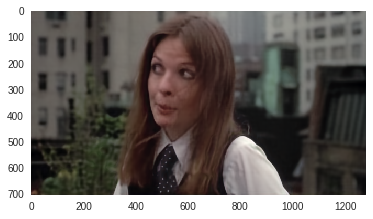

1100


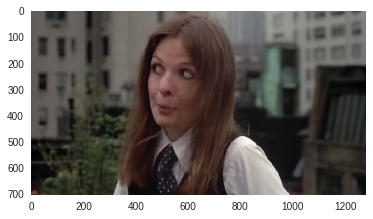

1200


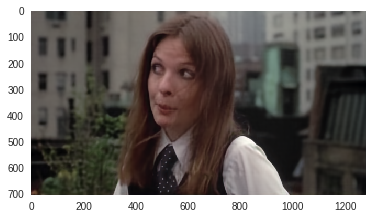

1300


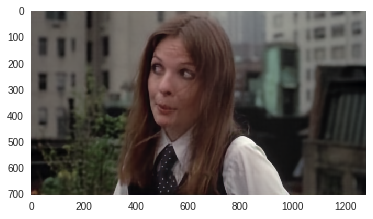

1400


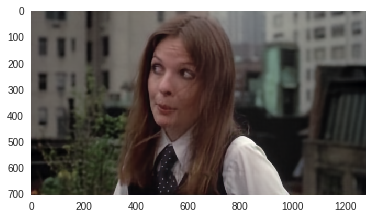

1500


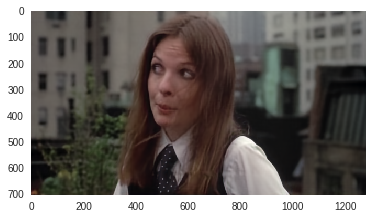

1600


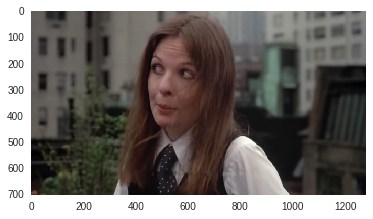

1700


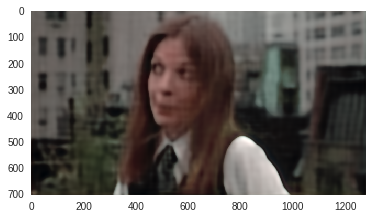

1800


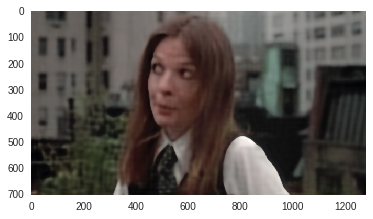

1900


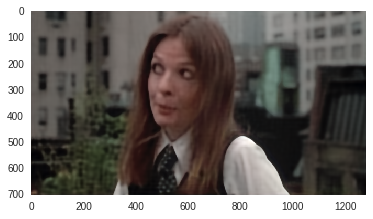

2000


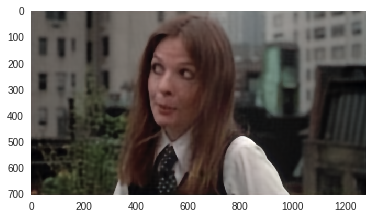

2100


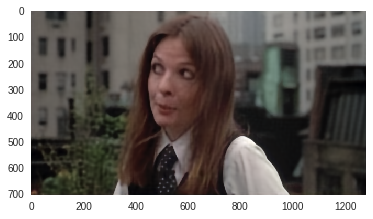

2200


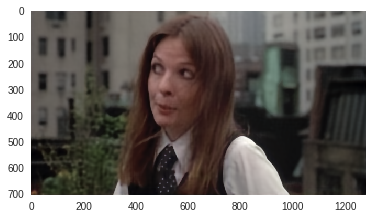

2300


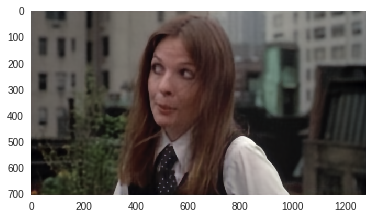

2400


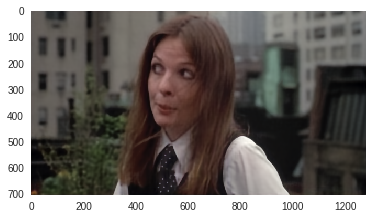

2500


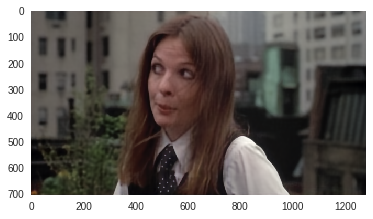

2600


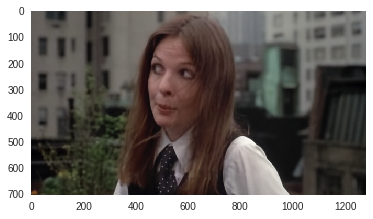

2700


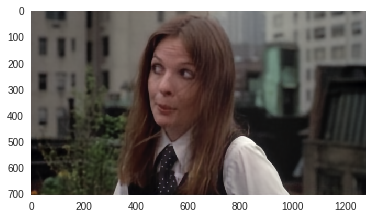

2800


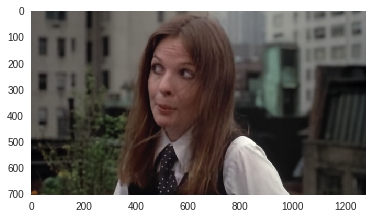

2900


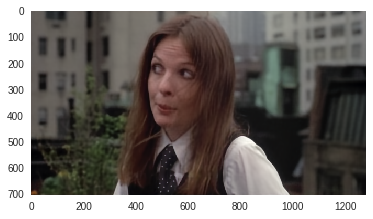

Final train loss
0.00011829738650703803
Finished Training. See training time on next line
2026


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [32]:
#training from scratch is slower to produce good inpainting
model = Net()
model.cuda()
criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)
i=3
mask_fname = 'snapshot' + str(i) + '_mask.png'
withoutsubs_fname = 'snapshot' + str(i) + '_withoutsubs.png'
model_without_transfer = train_model(net, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=3000, fname='3_scratch')

# Creating and Saving Masks for Report

In [0]:
def makeCustomMask(img, radius):
  out1 = np.zeros(img[:,:,0].shape)
  out2 = np.zeros(img[:,:,0].shape)
  
  #catch yellow ones (by yellow we mean our mildly arbitrary range)
  #we used https://imagecolorpicker.com/
  for i in range(500,img.shape[0]):
    for j in range(img.shape[1]):
      if img[i,j,0]>.9 and img[i,j,1]>.9 and img[i,j,2]>.05 and img[i,j,2]<.6:
        out1[i,j] = 1.
  
  #make everyone within radius of yellow one yellow
  #radius = 5 #higher is more liberal with masking nonsubtitle pixels, but if it's too low doesn't catch them all :(
  for i in range(radius,img.shape[0]-radius-1):
    for j in range(radius,img.shape[1]-radius-1):
      for k in range(-radius,radius+1):
        for l in range(-radius,radius+1):
          if out1[i+k,j+l]==1:
            out2[i,j] = 1.
  
  #apply the same mask on 3 channels
  finalOut = np.zeros(img.shape)
  finalOut[:,:,0] = 1-out2
  finalOut[:,:,1] = 1-out2
  finalOut[:,:,2] = 1-out2
  
  return finalOut

In [0]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import scipy.misc

#get portion of image for zoomed in mask results
i = 7

#Do NOT run this again -- it takes a lot of itme and we have the outputs saved in gdrive
#This code is used both for testing and saving stuff, you can comment stuff out
print("Dealing with image " + str(i))
  
#show original picture
image = mpimg.imread('snapshot' + str(i) + '.png')
plt.rcParams["axes.grid"] = False
plt.imshow(image)
plt.show()

#make mask and subs/nosubs image
myMaskr1 = makeCustomMask(image,1)
myMaskr3 = makeCustomMask(image,3)
myMaskr5 = makeCustomMask(image,5)

#show subs/nosubs image
plt.imshow(myMaskr1)
plt.show()
plt.imshow(myMaskr3)
plt.show()
plt.imshow(myMaskr5)
plt.show()

smallerOriginal = image[560:650,300:1000,:]
smaller1 = myMaskr1[560:650,300:1000,:]
smaller3 = myMaskr3[560:650,300:1000,:]
smaller5 = myMaskr5[560:650,300:1000,:]
#check and diagnose in more depth
plt.imshow(smallerOriginal)
plt.show()
plt.imshow(smaller1)
plt.show()
plt.imshow(smaller3)
plt.show()
plt.imshow(smaller5)
plt.show()
  
#save the images
scipy.misc.imsave('img7_maskOriginalRegion.png', smallerOriginal)
scipy.misc.imsave('img7_maskRadius1.png', smaller1)
scipy.misc.imsave('img7_maskRadius3.png', smaller3)
scipy.misc.imsave('img7_maskRadius5.png', smaller5)


In [0]:
a = 'img7_maskOriginalRegion.png';
b = 'img7_maskRadius1.png';
c = 'img7_maskRadius3.png';
d = 'img7_maskRadius5.png';

file1 = drive.CreateFile()
file1.SetContentFile(a)
file1.Upload() # Upload the file.

file2 = drive.CreateFile()
file2.SetContentFile(b)
file2.Upload() # Upload the file.

file3 = drive.CreateFile()
file3.SetContentFile(c)
file3.Upload() # Upload the file.

file4 = drive.CreateFile()
file4.SetContentFile(d)
file4.Upload() # Upload the file.

# Build Autoencoder SIDN

In [0]:
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

LeakyReLU = nn.LeakyReLU(0.2, inplace=True)

num_channels_down=[16, 32, 64, 128, 128]
num_channels_up=[16, 32, 64, 128, 128]
num_channels_skip=[0, 0, 0, 0, 4]
num_channels_input = 32
num_train_images = 4
k_down = 7
k_up = 7
k_skip = 1

padding_down = int((k_down-1)/2)
padding_up = int((k_up-1)/2)
padding_skip = int((k_skip-1)/2)

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        #-----------------------------------------------------------------------
        #----------------------------- Down blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 0 # for first
        #first down block, others are copypaste
        self.down1_downsample = nn.Conv2d(num_channels_input+num_train_images, num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down1_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down1_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down1_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 1
        self.down2_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down2_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down2_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down2_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 2
        self.down3_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down3_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down3_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down3_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 3
        self.down4_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down4_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down4_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down4_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 4
        self.down5_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down5_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down5_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down5_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        #-----------------------------------------------------------------------
        #----------------------------- Skip blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 4 # for 5th
        #first skip block, others are copypaste
        self.skip5_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
        self.skip5_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        #-----------------------------------------------------------------------
        #--------------------------- Misc but needed ---------------------------
        #-----------------------------------------------------------------------
        
        #will need this for the up layers
        self.upsample = nn.Upsample(scale_factor=2, mode='nearest') #at the end
        num_channels_up.append(0) #this way for the fifth layers the combined is just the skip
        #will need this at the end of network
        self.makeFinalOutput = nn.Conv2d(num_channels_up[0],3,1)
        
        #-----------------------------------------------------------------------
        #------------------------------ Up blocks ------------------------------
        #-----------------------------------------------------------------------
        
        i=4 # for fifth
        #fifth up block, others are copypaste
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i]; #num_channels_up[5] is 0
        self.up5_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up5_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up5_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up5_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up5_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=3
        self.up4_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up4_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up4_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up4_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up4_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=2
        self.up3_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up3_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up3_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up3_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up3_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=1;
        self.up2_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up2_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up2_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up2_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up2_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=0
        self.up1_bn_initial = nn.BatchNorm2d(num_channels_up[i+1])
        self.up1_conv1 = nn.Conv2d(num_channels_up[i+1], num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up1_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up1_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up1_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
    def forward(self, x):
        #-----------------------------------------------------------------------
        #-------------------- Downsampling and recording skip ------------------
        #-----------------------------------------------------------------------
        x = LeakyReLU(self.down1_bn_downsample(self.down1_downsample(x)))
        x = LeakyReLU(self.down1_bn_justconv(self.down1_justconv(x)))
        
        x = LeakyReLU(self.down2_bn_downsample(self.down2_downsample(x)))
        x = LeakyReLU(self.down2_bn_justconv(self.down2_justconv(x)))
        
        x = LeakyReLU(self.down3_bn_downsample(self.down3_downsample(x)))
        x = LeakyReLU(self.down3_bn_justconv(self.down3_justconv(x)))
        
        x = LeakyReLU(self.down4_bn_downsample(self.down4_downsample(x)))
        x = LeakyReLU(self.down4_bn_justconv(self.down4_justconv(x)))
        
        x = LeakyReLU(self.down5_bn_downsample(self.down5_downsample(x)))
        x = LeakyReLU(self.down5_bn_justconv(self.down5_justconv(x)))
        x = self.skip5_conv(x)
        skips5 = LeakyReLU(self.skip5_bn(x))
        
        #-----------------------------------------------------------------------
        #------------------------------ Upsampling -----------------------------
        #-----------------------------------------------------------------------
        
        #we start at the fifth layer (layers have reverse order)
        x = self.up5_bn_initial(skips5) #notice no concatenation here
        x = LeakyReLU(self.up5_bn1(self.up5_conv1(x)))
        x = LeakyReLU(self.up5_bn2(self.up5_conv2(x)))
        x = self.upsample(x)
        
        #now we upsample all the other layers
        #print("up4")
        #print(x.size())
        #print(skips4.size())
        x = self.up4_bn_initial(x)
        x = LeakyReLU(self.up4_bn1(self.up4_conv1(x)))
        x = LeakyReLU(self.up4_bn2(self.up4_conv2(x)))
        x = self.upsample(x)
        
        #print("up3")
        #print(x.size())
        #print(skips3.size())
        x = self.up3_bn_initial(x)
        x = LeakyReLU(self.up3_bn1(self.up3_conv1(x)))
        x = LeakyReLU(self.up3_bn2(self.up3_conv2(x)))
        x = self.upsample(x)
        
        #print("up2")
        #print(x.size())
        #print(skips2.size())
        x = self.up2_bn_initial(x)
        x = LeakyReLU(self.up2_bn1(self.up2_conv1(x)))
        x = LeakyReLU(self.up2_bn2(self.up2_conv2(x)))
        x = self.upsample(x)
        
        #print("up1")
        #print(x.size())
        #print(skips1.size())
        x = self.up1_bn_initial(x)
        x = LeakyReLU(self.up1_bn1(self.up1_conv1(x)))
        x = LeakyReLU(self.up1_bn2(self.up1_conv2(x)))
        x = self.upsample(x)
        
        
        #-----------------------------------------------------------------------
        #------------------------------- Finalize ------------------------------
        #-----------------------------------------------------------------------

        #now we get x to the right dimensions
        x = self.makeFinalOutput(x) #not sure if we need the leaky ReLU here
        
        return x

In [0]:
#generate noisy image as input
#noiseType = "uniform"
from torch.autograd import Variable

def createNoisyImage(input_depth,dimensions,var=0.1,noiseType='uniform'):
  tensorShape = [1,input_depth,dimensions[0],dimensions[1]]
  networkInput = Variable(torch.zeros(tensorShape))
  
  if noiseType == "uniform":
    networkInput.data.uniform_()
  elif noiseType == "normal":
    networkInput.data.normal_()
  
  networkInput.data = networkInput.data * var
  
  return networkInput

def createNoisyImagesWithOneHot(numImages, input_depth,dimensions,var=0.1,noiseType='uniform'):
  mynoisy = createNoisyImage(input_depth,dimensions,var,noiseType)
  
  tensorShape = [numImages,input_depth+numImages,dimensions[0],dimensions[1]]
  fourDinput = Variable(torch.zeros(tensorShape))
  
  for i in range(0, numImages):
      ithoutput = mynoisy
      ithoutput = padit(mynoisy, numImages, i)
      fourDinput[i] = ithoutput[0]
  
  return fourDinput

def padit(originalImage, numImages, padIndex):
  outImage = originalImage
  
  oneImageShape = [1,1,originalImage.shape[2],originalImage.shape[3]]
  myzeros = Variable(torch.zeros(oneImageShape))
  myones = Variable(torch.ones(oneImageShape))
  
  for j in range(0,numImages):
    if j==padIndex:
      outImage = torch.cat((outImage, myones),1)
    else:
      outImage = torch.cat((outImage, myzeros),1)
  return outImage

oneHotInput = createNoisyImagesWithOneHot(4, 32,[maskCropped.shape[0],maskCropped.shape[1]],0.1,"uniform")

In [59]:
#Checking that we have the right 0 and 1 images at the right places
print(oneHotInput.shape)

samInput = oneHotInput.data[2,:,:,:]
print(samInput[34])
#plt.imshow(np.array(samInput)[33])

torch.Size([4, 36, 704, 1280])

    1     1     1  ...      1     1     1
    1     1     1  ...      1     1     1
    1     1     1  ...      1     1     1
       ...          ⋱          ...       
    1     1     1  ...      1     1     1
    1     1     1  ...      1     1     1
    1     1     1  ...      1     1     1
[torch.FloatTensor of size 704x1280]



In [0]:
#size is [1, channels, height, width
maskedTarget = Variable(torch.Tensor(withoutsubsCropped))
maskCroppedTensor = Variable(torch.Tensor(maskCropped))

maskedTarget = maskedTarget.cuda()
maskCroppedTensor = maskCroppedTensor.cuda()

# Train Autoencoder SIDN

This has different attempts to do transfer learning. See report for details.

Naturally training is testing here, so we save outputs to images and upload these images to gdrive

In [0]:
# Saving any model
def save_model(model, filename):
  torch.save(model, filename)
  
def save_model_statedict(model, filename):
  torch.save(model.state_dict(), filename)
  
def load_model(filename):
  model = torch.load(filename)
  model.cuda()
  return model

In [39]:
#Saving a random model
net = Net()
net.cuda()
save_model(net, 'random_init.pt')

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [40]:
#reset your net
net = Net()
net.cuda()

Net(
  (down1_downsample): Conv2d (36, 16, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down1_bn_downsample): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down1_justconv): Conv2d (16, 16, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down1_bn_justconv): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down2_downsample): Conv2d (16, 32, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down2_bn_downsample): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down2_justconv): Conv2d (32, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down2_bn_justconv): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down3_downsample): Conv2d (32, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down3_bn_downsample): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
  (down3_justconv): Conv2d (64, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down3_bn_justconv): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)

In [41]:
#Download the original and processed 8frames data
file_list = drive.ListFile({'q': "'1n7iCwVNkUtMZE9TyRMXvo2bCPn82-Od1' in parents and trashed=false"}).GetList()
i = 1
for file1 in sorted(file_list, key = lambda x: x['title']):
    print('Downloading {} from GDrive ({}/{})'.format(file1['title'], i, len(file_list)))
    file1.GetContentFile(file1['title'])
    i += 1

In [0]:
her1 = mpimg.imread('her1.png')[8:712,:,:]
her2 = mpimg.imread('her2.png')[8:712,:,:]
her3 = mpimg.imread('her3.png')[8:712,:,:]
her4 = mpimg.imread('her4.png')[8:712,:,:]
images = [her1, her2, her3, her4]
images = np.array(images)
multiTarget = Variable(torch.Tensor(images))

fname = "multiTraining3k"

torch.save(oneHotInput, fname+'oneHotVariable.pt')
file1 = drive.CreateFile()
file1.SetContentFile(fname+'oneHotVariable.pt')
file1.Upload() # Upload the file.

In [0]:
#changing the epochs to 1000 for the sake of this file
def train_model_multiImage(net, oneHotInput, target, numImages, criterion, optimizer, maxepochs=1000, fname='output'):
  target = target.cuda()
  oneHotInput = oneHotInput.cuda()
  
  for epoch in range(maxepochs):  # loop over the data multiple times  
      # zero the parameter gradients
      optimizer.zero_grad()

      #print("backpropagation time")
      # forward + backward + optimize
      #THIS SHOULD BE A LOOP
      loss = 0
      #for i in range(0, numImages):
      outputs = net(oneHotInput)
      #outputs = outputs[0]
      outputs = outputs.permute(0,2,3,1)
      loss = criterion(outputs, target)
      loss.backward()
      
      optimizer.step()

      #print some results
      if epoch == 0:
          k = -1
      else:
          k = -2
      print('[%d, %d s] loss: %.3f '% (epoch + 1, int(time.time() - startime), loss.data[0]))
      trainLoss.append(loss.data[0])

  print("Final train loss")
  print(trainLoss[len(trainLoss)-1])

  print('Finished Training. See training time on next line')
  print(int(time.time() - startime))
  save_model(net, fname+'trained.pt')
  file1 = drive.CreateFile()
  file1.SetContentFile(fname+'trained.pt')
  file1.Upload() # Upload the file.
  return net

In [0]:
#changing the epochs to 1000 for the sake of this file
def train_model_loadMultiModel(net, numImages, inputs, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=1000, fname='output'):
  mask = mpimg.imread(mask_fname)
  withoutsubs = mpimg.imread(withoutsubs_fname)
  withoutsubsCropped = withoutsubs[8:712,:,:]
  maskCropped = mask[8:712,:,:]
  maskedTarget = Variable(torch.Tensor(withoutsubsCropped))
  maskCroppedTensor = Variable(torch.Tensor(maskCropped))

  maskedTarget = maskedTarget.cuda()
  maskCroppedTensor = maskCroppedTensor.cuda()
  inputs = inputs.cuda()
  
  for epoch in range(maxepochs):  # loop over the data multiple times  
      # get the label #NEEDS TO BE 4D TENSOR
      label = maskedTarget

      # wrap them in Variable
      inputs, label = inputs.cuda(), label.cuda()

      # zero the parameter gradients
      optimizer.zero_grad()

      #print("backpropagation time")
      # forward + backward + optimize
      #THIS SHOULD BE A LOOP
      loss = 0
      outputs = net(inputs)
      outputs = outputs[0]
      outputs = outputs.permute(1,2,0)
      loss = criterion(torch.mul(outputs, maskCroppedTensor), label)
      loss.backward()
      
      optimizer.step()

      #if epoch%5==0:
        #print("We are at epoch " + str(epoch))

      #save the image every 100 epochs
      if epoch%50==0:
  #         pp = PdfPages('subsTest' + str(epoch) + '.pdf')

          arr = np.array(outputs.data)
          arr = np.clip(arr, 0, 1)
          plt.rcParams["axes.grid"] = False
          plt.imshow(arr)
  #         plt.savefig(pp, format='pdf')
  #         pp.close()
          plt.imsave(fname + 'subsTest' + str(epoch) + '.png', arr)
          file1 = drive.CreateFile()
          file1.SetContentFile(fname + 'subsTest' + str(epoch) + '.png')
          file1.Upload() # Upload the file.
          plt.show()

      #print some results
      if epoch == 0:
          k = -1
      else:
          k = -2
      print('[%d, %d s] loss: %.3f '% (epoch + 1, int(time.time() - startime), loss.data[0]))
      trainLoss.append(loss.data[0])

  print("Final train loss")
  print(trainLoss[len(trainLoss)-1])

  print('Finished Training. See training time on next line')
  print(int(time.time() - startime))
  save_model(net, fname+'trained.pt')
  file1 = drive.CreateFile()
  file1.SetContentFile(fname+'trained.pt')
  file1.Upload() # Upload the file.
  return net

In [45]:
#Set up Training
#Loss Function = MSE
#Get image in Tensor form. This is the label
dtype = torch.cuda.FloatTensor

print('Started Training')
startime = time.time();

numepochs = 0

acc = []
trainLoss = []
criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)

train_model_multiImage(net, oneHotInput, multiTarget, 4, criterion, optimizer, maxepochs=1000, fname='multiTrain3k')

Started Training
[1, 1 s] loss: 0.286 
[2, 2 s] loss: 0.239 
[3, 4 s] loss: 0.180 
[4, 5 s] loss: 0.147 
[5, 7 s] loss: 0.120 
[6, 8 s] loss: 0.096 
[7, 10 s] loss: 0.078 
[8, 11 s] loss: 0.064 
[9, 13 s] loss: 0.053 
[10, 14 s] loss: 0.044 
[11, 16 s] loss: 0.038 
[12, 17 s] loss: 0.035 
[13, 19 s] loss: 0.033 
[14, 20 s] loss: 0.034 
[15, 21 s] loss: 0.035 
[16, 23 s] loss: 0.037 
[17, 24 s] loss: 0.038 
[18, 26 s] loss: 0.038 
[19, 27 s] loss: 0.038 
[20, 29 s] loss: 0.037 
[21, 30 s] loss: 0.036 
[22, 32 s] loss: 0.035 
[23, 33 s] loss: 0.035 
[24, 35 s] loss: 0.034 
[25, 36 s] loss: 0.032 
[26, 38 s] loss: 0.032 
[27, 39 s] loss: 0.031 
[28, 41 s] loss: 0.031 
[29, 42 s] loss: 0.030 
[30, 44 s] loss: 0.030 
[31, 45 s] loss: 0.030 
[32, 46 s] loss: 0.030 
[33, 48 s] loss: 0.030 
[34, 49 s] loss: 0.029 
[35, 51 s] loss: 0.029 
[36, 52 s] loss: 0.029 
[37, 54 s] loss: 0.029 
[38, 55 s] loss: 0.029 
[39, 57 s] loss: 0.029 
[40, 58 s] loss: 0.029 
[41, 60 s] loss: 0.029 
[42, 61 s] los

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


Net(
  (down1_downsample): Conv2d (36, 16, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down1_bn_downsample): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down1_justconv): Conv2d (16, 16, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down1_bn_justconv): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down2_downsample): Conv2d (16, 32, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down2_bn_downsample): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down2_justconv): Conv2d (32, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down2_bn_justconv): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down3_downsample): Conv2d (32, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
  (down3_bn_downsample): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
  (down3_justconv): Conv2d (64, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
  (down3_bn_justconv): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)

In [0]:
save_model_statedict(net, fname+'m1_3k_initTraining.pt')
file1 = drive.CreateFile()
file1.SetContentFile('multiTrain3ktrained.pt')
file1.Upload() # Upload the file.

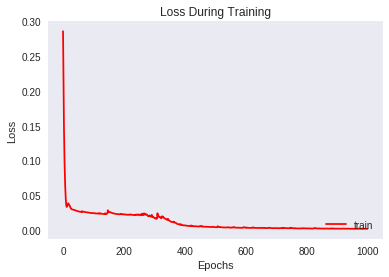

In [57]:
plt.figure()
plt.title('Loss During Training')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.plot(trainLoss, 'r', label="train")
plt.legend(loc=4)
plt.show()

In [0]:
oneHotInput = createNoisyImagesWithOneHot(4, 36,[maskCropped.shape[0],maskCropped.shape[1]],0.1,"uniform")

In [0]:
#initial training (not shown)
model = Net()
model.cuda()
criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)
i=3
mask_fname = 'snapshot' + str(i) + '_mask.png'
withoutsubs_fname = 'snapshot' + str(i) + '_withoutsubs.png'
model_without_transfer = train_model(net, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=1000, fname='3_scratch', inputs=oneHotInput)

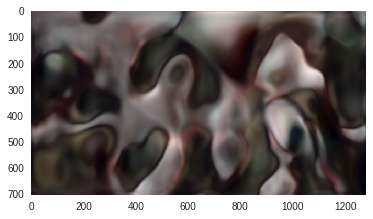

[1, 2983 s] loss: 0.044 
[2, 2983 s] loss: 0.035 
[3, 2984 s] loss: 0.026 
[4, 2984 s] loss: 0.022 
[5, 2985 s] loss: 0.020 
[6, 2986 s] loss: 0.018 
[7, 2986 s] loss: 0.016 
[8, 2987 s] loss: 0.015 
[9, 2988 s] loss: 0.013 
[10, 2988 s] loss: 0.012 
[11, 2989 s] loss: 0.012 
[12, 2989 s] loss: 0.011 
[13, 2990 s] loss: 0.010 
[14, 2991 s] loss: 0.010 
[15, 2991 s] loss: 0.009 
[16, 2992 s] loss: 0.009 
[17, 2993 s] loss: 0.009 
[18, 2993 s] loss: 0.008 
[19, 2994 s] loss: 0.008 
[20, 2995 s] loss: 0.008 
[21, 2995 s] loss: 0.007 
[22, 2996 s] loss: 0.007 
[23, 2996 s] loss: 0.007 
[24, 2997 s] loss: 0.007 
[25, 2998 s] loss: 0.007 
[26, 2998 s] loss: 0.006 
[27, 2999 s] loss: 0.006 
[28, 3000 s] loss: 0.006 
[29, 3000 s] loss: 0.006 
[30, 3001 s] loss: 0.006 
[31, 3002 s] loss: 0.006 
[32, 3002 s] loss: 0.006 
[33, 3003 s] loss: 0.006 
[34, 3003 s] loss: 0.006 
[35, 3004 s] loss: 0.005 
[36, 3005 s] loss: 0.005 
[37, 3005 s] loss: 0.006 
[38, 3006 s] loss: 0.005 
[39, 3007 s] loss: 0.

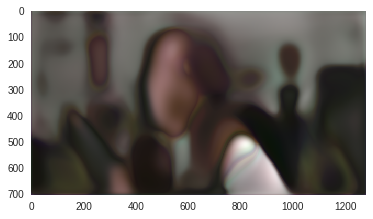

[51, 3018 s] loss: 0.004 
[52, 3018 s] loss: 0.004 
[53, 3019 s] loss: 0.004 
[54, 3019 s] loss: 0.004 
[55, 3020 s] loss: 0.004 
[56, 3020 s] loss: 0.003 
[57, 3021 s] loss: 0.003 
[58, 3022 s] loss: 0.003 
[59, 3022 s] loss: 0.003 
[60, 3023 s] loss: 0.003 
[61, 3024 s] loss: 0.003 
[62, 3024 s] loss: 0.003 
[63, 3025 s] loss: 0.003 
[64, 3026 s] loss: 0.003 
[65, 3026 s] loss: 0.003 
[66, 3027 s] loss: 0.004 
[67, 3027 s] loss: 0.003 
[68, 3028 s] loss: 0.004 
[69, 3029 s] loss: 0.003 
[70, 3029 s] loss: 0.003 
[71, 3030 s] loss: 0.003 
[72, 3031 s] loss: 0.003 
[73, 3031 s] loss: 0.003 
[74, 3032 s] loss: 0.003 
[75, 3033 s] loss: 0.003 
[76, 3033 s] loss: 0.003 
[77, 3034 s] loss: 0.003 
[78, 3034 s] loss: 0.003 
[79, 3035 s] loss: 0.003 
[80, 3036 s] loss: 0.003 
[81, 3036 s] loss: 0.003 
[82, 3037 s] loss: 0.003 
[83, 3038 s] loss: 0.003 
[84, 3038 s] loss: 0.003 
[85, 3039 s] loss: 0.003 
[86, 3040 s] loss: 0.003 
[87, 3040 s] loss: 0.003 
[88, 3041 s] loss: 0.003 
[89, 3041 s]

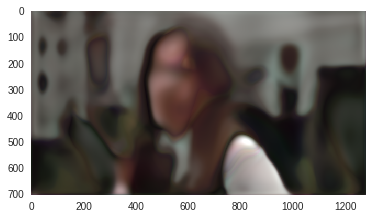

[101, 3052 s] loss: 0.002 
[102, 3053 s] loss: 0.002 
[103, 3053 s] loss: 0.002 
[104, 3054 s] loss: 0.002 
[105, 3055 s] loss: 0.002 
[106, 3055 s] loss: 0.003 
[107, 3056 s] loss: 0.002 
[108, 3056 s] loss: 0.003 
[109, 3057 s] loss: 0.002 
[110, 3058 s] loss: 0.002 
[111, 3058 s] loss: 0.002 
[112, 3059 s] loss: 0.002 
[113, 3060 s] loss: 0.002 
[114, 3060 s] loss: 0.002 
[115, 3061 s] loss: 0.002 
[116, 3062 s] loss: 0.002 
[117, 3062 s] loss: 0.002 
[118, 3063 s] loss: 0.002 
[119, 3064 s] loss: 0.002 
[120, 3064 s] loss: 0.002 
[121, 3065 s] loss: 0.002 
[122, 3065 s] loss: 0.002 
[123, 3066 s] loss: 0.002 
[124, 3067 s] loss: 0.002 
[125, 3067 s] loss: 0.002 
[126, 3068 s] loss: 0.002 
[127, 3069 s] loss: 0.002 
[128, 3069 s] loss: 0.002 
[129, 3070 s] loss: 0.002 
[130, 3071 s] loss: 0.002 
[131, 3071 s] loss: 0.002 
[132, 3072 s] loss: 0.003 
[133, 3072 s] loss: 0.003 
[134, 3073 s] loss: 0.002 
[135, 3074 s] loss: 0.002 
[136, 3074 s] loss: 0.002 
[137, 3075 s] loss: 0.002 
[

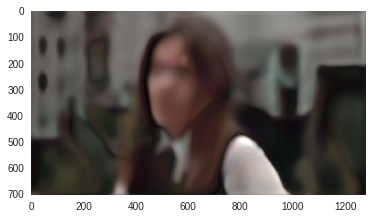

[151, 3087 s] loss: 0.002 
[152, 3088 s] loss: 0.002 
[153, 3088 s] loss: 0.002 
[154, 3089 s] loss: 0.002 
[155, 3090 s] loss: 0.002 
[156, 3090 s] loss: 0.002 
[157, 3091 s] loss: 0.002 
[158, 3091 s] loss: 0.002 
[159, 3092 s] loss: 0.002 
[160, 3093 s] loss: 0.002 
[161, 3093 s] loss: 0.002 
[162, 3094 s] loss: 0.002 
[163, 3095 s] loss: 0.002 
[164, 3095 s] loss: 0.002 
[165, 3096 s] loss: 0.002 
[166, 3097 s] loss: 0.002 
[167, 3097 s] loss: 0.002 
[168, 3098 s] loss: 0.002 
[169, 3098 s] loss: 0.002 
[170, 3099 s] loss: 0.002 
[171, 3100 s] loss: 0.002 
[172, 3100 s] loss: 0.002 
[173, 3101 s] loss: 0.002 
[174, 3102 s] loss: 0.002 
[175, 3102 s] loss: 0.002 
[176, 3103 s] loss: 0.002 
[177, 3104 s] loss: 0.002 
[178, 3104 s] loss: 0.002 
[179, 3105 s] loss: 0.002 
[180, 3105 s] loss: 0.002 
[181, 3106 s] loss: 0.002 
[182, 3107 s] loss: 0.002 
[183, 3107 s] loss: 0.002 
[184, 3108 s] loss: 0.002 
[185, 3109 s] loss: 0.002 
[186, 3109 s] loss: 0.002 
[187, 3110 s] loss: 0.002 
[

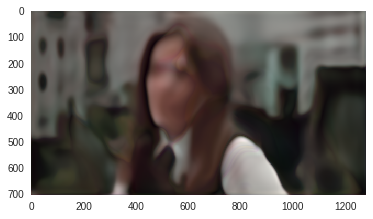

[201, 3123 s] loss: 0.002 
[202, 3123 s] loss: 0.002 
[203, 3124 s] loss: 0.002 
[204, 3124 s] loss: 0.002 
[205, 3125 s] loss: 0.002 
[206, 3125 s] loss: 0.002 
[207, 3126 s] loss: 0.002 
[208, 3127 s] loss: 0.002 
[209, 3127 s] loss: 0.002 
[210, 3128 s] loss: 0.002 
[211, 3129 s] loss: 0.002 
[212, 3129 s] loss: 0.001 
[213, 3130 s] loss: 0.001 
[214, 3131 s] loss: 0.002 
[215, 3131 s] loss: 0.001 
[216, 3132 s] loss: 0.001 
[217, 3132 s] loss: 0.001 
[218, 3133 s] loss: 0.001 
[219, 3134 s] loss: 0.001 
[220, 3134 s] loss: 0.001 
[221, 3135 s] loss: 0.001 
[222, 3136 s] loss: 0.001 
[223, 3136 s] loss: 0.002 
[224, 3137 s] loss: 0.002 
[225, 3138 s] loss: 0.002 
[226, 3138 s] loss: 0.001 
[227, 3139 s] loss: 0.001 
[228, 3139 s] loss: 0.002 
[229, 3140 s] loss: 0.001 
[230, 3141 s] loss: 0.001 
[231, 3141 s] loss: 0.002 
[232, 3142 s] loss: 0.001 
[233, 3143 s] loss: 0.001 
[234, 3143 s] loss: 0.001 
[235, 3144 s] loss: 0.001 
[236, 3145 s] loss: 0.001 
[237, 3145 s] loss: 0.001 
[

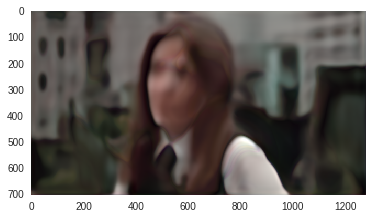

[251, 3157 s] loss: 0.001 
[252, 3157 s] loss: 0.002 
[253, 3158 s] loss: 0.002 
[254, 3159 s] loss: 0.001 
[255, 3159 s] loss: 0.002 
[256, 3160 s] loss: 0.002 
[257, 3161 s] loss: 0.001 
[258, 3161 s] loss: 0.001 
[259, 3162 s] loss: 0.001 
[260, 3163 s] loss: 0.001 
[261, 3163 s] loss: 0.001 
[262, 3164 s] loss: 0.001 
[263, 3164 s] loss: 0.001 
[264, 3165 s] loss: 0.001 
[265, 3166 s] loss: 0.001 
[266, 3166 s] loss: 0.001 
[267, 3167 s] loss: 0.001 
[268, 3168 s] loss: 0.001 
[269, 3168 s] loss: 0.001 
[270, 3169 s] loss: 0.001 
[271, 3170 s] loss: 0.001 
[272, 3170 s] loss: 0.001 
[273, 3171 s] loss: 0.001 
[274, 3171 s] loss: 0.001 
[275, 3172 s] loss: 0.001 
[276, 3173 s] loss: 0.001 
[277, 3173 s] loss: 0.001 
[278, 3174 s] loss: 0.001 
[279, 3175 s] loss: 0.001 
[280, 3175 s] loss: 0.001 
[281, 3176 s] loss: 0.001 
[282, 3177 s] loss: 0.001 
[283, 3177 s] loss: 0.001 
[284, 3178 s] loss: 0.001 
[285, 3178 s] loss: 0.001 
[286, 3179 s] loss: 0.001 
[287, 3180 s] loss: 0.001 
[

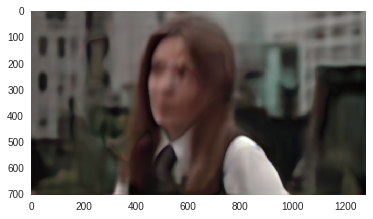

[301, 3192 s] loss: 0.001 
[302, 3192 s] loss: 0.001 
[303, 3193 s] loss: 0.001 
[304, 3194 s] loss: 0.001 
[305, 3194 s] loss: 0.002 
[306, 3195 s] loss: 0.002 
[307, 3195 s] loss: 0.001 
[308, 3196 s] loss: 0.002 
[309, 3197 s] loss: 0.002 
[310, 3197 s] loss: 0.002 
[311, 3198 s] loss: 0.001 
[312, 3199 s] loss: 0.001 
[313, 3199 s] loss: 0.001 
[314, 3200 s] loss: 0.001 
[315, 3201 s] loss: 0.001 
[316, 3201 s] loss: 0.001 
[317, 3202 s] loss: 0.001 
[318, 3202 s] loss: 0.001 
[319, 3203 s] loss: 0.001 
[320, 3204 s] loss: 0.001 
[321, 3204 s] loss: 0.001 
[322, 3205 s] loss: 0.001 
[323, 3206 s] loss: 0.001 
[324, 3206 s] loss: 0.001 
[325, 3207 s] loss: 0.001 
[326, 3208 s] loss: 0.001 
[327, 3208 s] loss: 0.001 
[328, 3209 s] loss: 0.001 
[329, 3209 s] loss: 0.001 
[330, 3210 s] loss: 0.001 
[331, 3211 s] loss: 0.001 
[332, 3211 s] loss: 0.001 
[333, 3212 s] loss: 0.001 
[334, 3213 s] loss: 0.001 
[335, 3213 s] loss: 0.001 
[336, 3214 s] loss: 0.001 
[337, 3215 s] loss: 0.001 
[

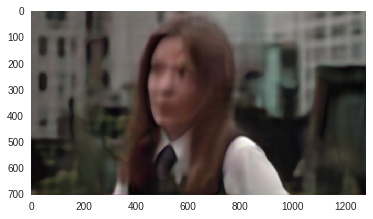

[351, 3227 s] loss: 0.001 
[352, 3227 s] loss: 0.001 
[353, 3228 s] loss: 0.001 
[354, 3228 s] loss: 0.001 
[355, 3229 s] loss: 0.001 
[356, 3230 s] loss: 0.001 
[357, 3230 s] loss: 0.001 
[358, 3231 s] loss: 0.001 
[359, 3232 s] loss: 0.001 
[360, 3232 s] loss: 0.001 
[361, 3233 s] loss: 0.001 
[362, 3234 s] loss: 0.001 
[363, 3234 s] loss: 0.001 
[364, 3235 s] loss: 0.001 
[365, 3236 s] loss: 0.001 
[366, 3236 s] loss: 0.001 
[367, 3237 s] loss: 0.001 
[368, 3237 s] loss: 0.001 
[369, 3238 s] loss: 0.001 
[370, 3239 s] loss: 0.001 
[371, 3239 s] loss: 0.001 
[372, 3240 s] loss: 0.001 
[373, 3241 s] loss: 0.001 
[374, 3241 s] loss: 0.001 
[375, 3242 s] loss: 0.001 
[376, 3243 s] loss: 0.001 
[377, 3243 s] loss: 0.001 
[378, 3244 s] loss: 0.001 
[379, 3244 s] loss: 0.001 
[380, 3245 s] loss: 0.001 
[381, 3246 s] loss: 0.001 
[382, 3246 s] loss: 0.001 
[383, 3247 s] loss: 0.001 
[384, 3248 s] loss: 0.001 
[385, 3248 s] loss: 0.001 
[386, 3249 s] loss: 0.001 
[387, 3250 s] loss: 0.001 
[

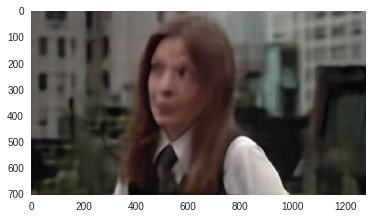

[401, 3262 s] loss: 0.001 
[402, 3262 s] loss: 0.001 
[403, 3263 s] loss: 0.001 
[404, 3263 s] loss: 0.001 
[405, 3264 s] loss: 0.001 
[406, 3265 s] loss: 0.001 
[407, 3265 s] loss: 0.001 
[408, 3266 s] loss: 0.001 
[409, 3266 s] loss: 0.001 
[410, 3267 s] loss: 0.001 
[411, 3268 s] loss: 0.001 
[412, 3268 s] loss: 0.001 
[413, 3269 s] loss: 0.001 
[414, 3270 s] loss: 0.001 
[415, 3270 s] loss: 0.001 
[416, 3271 s] loss: 0.001 
[417, 3272 s] loss: 0.001 
[418, 3272 s] loss: 0.001 
[419, 3273 s] loss: 0.001 
[420, 3273 s] loss: 0.001 
[421, 3274 s] loss: 0.001 
[422, 3275 s] loss: 0.001 
[423, 3275 s] loss: 0.001 
[424, 3276 s] loss: 0.001 
[425, 3277 s] loss: 0.001 
[426, 3277 s] loss: 0.001 
[427, 3278 s] loss: 0.001 
[428, 3279 s] loss: 0.001 
[429, 3279 s] loss: 0.001 
[430, 3280 s] loss: 0.001 
[431, 3280 s] loss: 0.001 
[432, 3281 s] loss: 0.001 
[433, 3282 s] loss: 0.001 
[434, 3282 s] loss: 0.001 
[435, 3283 s] loss: 0.001 
[436, 3284 s] loss: 0.001 
[437, 3284 s] loss: 0.001 
[

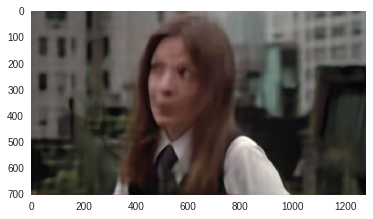

[451, 3297 s] loss: 0.001 
[452, 3297 s] loss: 0.001 
[453, 3297 s] loss: 0.001 
[454, 3298 s] loss: 0.001 
[455, 3299 s] loss: 0.001 
[456, 3299 s] loss: 0.001 
[457, 3300 s] loss: 0.001 
[458, 3301 s] loss: 0.001 
[459, 3301 s] loss: 0.001 
[460, 3302 s] loss: 0.001 
[461, 3303 s] loss: 0.001 
[462, 3303 s] loss: 0.001 
[463, 3304 s] loss: 0.001 
[464, 3305 s] loss: 0.001 
[465, 3305 s] loss: 0.001 
[466, 3306 s] loss: 0.001 
[467, 3306 s] loss: 0.001 
[468, 3307 s] loss: 0.001 
[469, 3308 s] loss: 0.001 
[470, 3308 s] loss: 0.001 
[471, 3309 s] loss: 0.001 
[472, 3310 s] loss: 0.001 
[473, 3310 s] loss: 0.001 
[474, 3311 s] loss: 0.001 
[475, 3312 s] loss: 0.001 
[476, 3312 s] loss: 0.001 
[477, 3313 s] loss: 0.001 
[478, 3313 s] loss: 0.001 
[479, 3314 s] loss: 0.001 
[480, 3315 s] loss: 0.001 
[481, 3315 s] loss: 0.001 
[482, 3316 s] loss: 0.001 
[483, 3317 s] loss: 0.001 
[484, 3317 s] loss: 0.001 
[485, 3318 s] loss: 0.001 
[486, 3319 s] loss: 0.001 
[487, 3319 s] loss: 0.001 
[

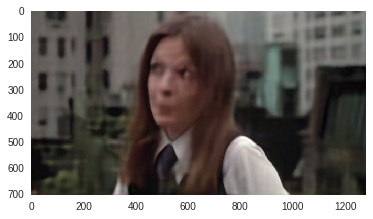

[501, 3331 s] loss: 0.001 
[502, 3332 s] loss: 0.001 
[503, 3332 s] loss: 0.001 
[504, 3333 s] loss: 0.001 
[505, 3334 s] loss: 0.001 
[506, 3334 s] loss: 0.001 
[507, 3335 s] loss: 0.001 
[508, 3336 s] loss: 0.001 
[509, 3336 s] loss: 0.001 
[510, 3337 s] loss: 0.001 
[511, 3337 s] loss: 0.001 
[512, 3338 s] loss: 0.001 
[513, 3339 s] loss: 0.001 
[514, 3339 s] loss: 0.001 
[515, 3340 s] loss: 0.001 
[516, 3341 s] loss: 0.001 
[517, 3341 s] loss: 0.001 
[518, 3342 s] loss: 0.001 
[519, 3343 s] loss: 0.001 
[520, 3343 s] loss: 0.001 
[521, 3344 s] loss: 0.001 
[522, 3344 s] loss: 0.001 
[523, 3345 s] loss: 0.001 
[524, 3346 s] loss: 0.001 
[525, 3346 s] loss: 0.001 
[526, 3347 s] loss: 0.001 
[527, 3348 s] loss: 0.001 
[528, 3348 s] loss: 0.001 
[529, 3349 s] loss: 0.001 
[530, 3350 s] loss: 0.001 
[531, 3350 s] loss: 0.001 
[532, 3351 s] loss: 0.001 
[533, 3351 s] loss: 0.001 
[534, 3352 s] loss: 0.001 
[535, 3353 s] loss: 0.001 
[536, 3353 s] loss: 0.001 
[537, 3354 s] loss: 0.001 
[

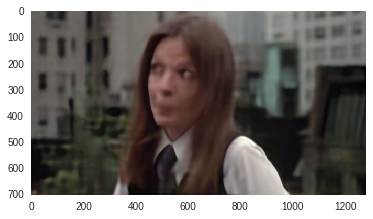

[551, 3366 s] loss: 0.001 
[552, 3366 s] loss: 0.000 
[553, 3367 s] loss: 0.000 
[554, 3368 s] loss: 0.000 
[555, 3368 s] loss: 0.000 
[556, 3369 s] loss: 0.000 
[557, 3370 s] loss: 0.000 
[558, 3370 s] loss: 0.000 
[559, 3371 s] loss: 0.000 
[560, 3372 s] loss: 0.000 
[561, 3372 s] loss: 0.000 
[562, 3373 s] loss: 0.000 
[563, 3373 s] loss: 0.000 
[564, 3374 s] loss: 0.000 
[565, 3375 s] loss: 0.000 
[566, 3375 s] loss: 0.000 
[567, 3376 s] loss: 0.001 
[568, 3377 s] loss: 0.001 
[569, 3377 s] loss: 0.001 
[570, 3378 s] loss: 0.001 
[571, 3379 s] loss: 0.001 
[572, 3379 s] loss: 0.001 
[573, 3380 s] loss: 0.001 
[574, 3380 s] loss: 0.001 
[575, 3381 s] loss: 0.001 
[576, 3382 s] loss: 0.001 
[577, 3382 s] loss: 0.001 
[578, 3383 s] loss: 0.001 
[579, 3384 s] loss: 0.001 
[580, 3384 s] loss: 0.001 
[581, 3385 s] loss: 0.001 
[582, 3386 s] loss: 0.001 
[583, 3386 s] loss: 0.001 
[584, 3387 s] loss: 0.001 
[585, 3387 s] loss: 0.001 
[586, 3388 s] loss: 0.001 
[587, 3389 s] loss: 0.000 
[

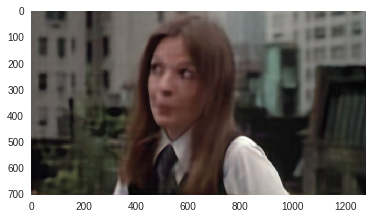

[601, 3401 s] loss: 0.000 
[602, 3401 s] loss: 0.000 
[603, 3402 s] loss: 0.000 
[604, 3402 s] loss: 0.000 
[605, 3403 s] loss: 0.000 
[606, 3404 s] loss: 0.000 
[607, 3404 s] loss: 0.000 
[608, 3405 s] loss: 0.000 
[609, 3406 s] loss: 0.000 
[610, 3406 s] loss: 0.001 
[611, 3407 s] loss: 0.001 
[612, 3408 s] loss: 0.001 
[613, 3408 s] loss: 0.001 
[614, 3409 s] loss: 0.001 
[615, 3409 s] loss: 0.001 
[616, 3410 s] loss: 0.001 
[617, 3411 s] loss: 0.001 
[618, 3411 s] loss: 0.001 
[619, 3412 s] loss: 0.001 
[620, 3413 s] loss: 0.001 
[621, 3413 s] loss: 0.001 
[622, 3414 s] loss: 0.001 
[623, 3415 s] loss: 0.001 
[624, 3415 s] loss: 0.001 
[625, 3416 s] loss: 0.001 
[626, 3416 s] loss: 0.001 
[627, 3417 s] loss: 0.001 
[628, 3418 s] loss: 0.000 
[629, 3418 s] loss: 0.000 
[630, 3419 s] loss: 0.000 
[631, 3420 s] loss: 0.000 
[632, 3420 s] loss: 0.000 
[633, 3421 s] loss: 0.000 
[634, 3422 s] loss: 0.000 
[635, 3422 s] loss: 0.000 
[636, 3423 s] loss: 0.000 
[637, 3423 s] loss: 0.000 
[

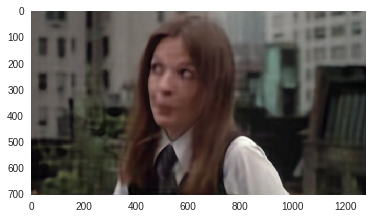

[651, 3435 s] loss: 0.000 
[652, 3436 s] loss: 0.000 
[653, 3436 s] loss: 0.000 
[654, 3437 s] loss: 0.000 
[655, 3438 s] loss: 0.001 
[656, 3438 s] loss: 0.001 
[657, 3439 s] loss: 0.001 
[658, 3440 s] loss: 0.001 
[659, 3440 s] loss: 0.001 
[660, 3441 s] loss: 0.001 
[661, 3441 s] loss: 0.000 
[662, 3442 s] loss: 0.000 
[663, 3443 s] loss: 0.001 
[664, 3443 s] loss: 0.000 
[665, 3444 s] loss: 0.000 
[666, 3445 s] loss: 0.000 
[667, 3445 s] loss: 0.000 
[668, 3446 s] loss: 0.000 
[669, 3447 s] loss: 0.000 
[670, 3447 s] loss: 0.000 
[671, 3448 s] loss: 0.000 
[672, 3448 s] loss: 0.000 
[673, 3449 s] loss: 0.000 
[674, 3450 s] loss: 0.000 
[675, 3450 s] loss: 0.000 
[676, 3451 s] loss: 0.000 
[677, 3452 s] loss: 0.000 
[678, 3452 s] loss: 0.000 
[679, 3453 s] loss: 0.000 
[680, 3454 s] loss: 0.000 
[681, 3454 s] loss: 0.000 
[682, 3455 s] loss: 0.000 
[683, 3455 s] loss: 0.000 
[684, 3456 s] loss: 0.000 
[685, 3457 s] loss: 0.000 
[686, 3457 s] loss: 0.000 
[687, 3458 s] loss: 0.000 
[

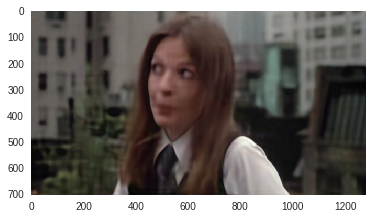

[701, 3470 s] loss: 0.000 
[702, 3471 s] loss: 0.000 
[703, 3471 s] loss: 0.000 
[704, 3472 s] loss: 0.000 
[705, 3473 s] loss: 0.000 
[706, 3473 s] loss: 0.000 
[707, 3474 s] loss: 0.000 
[708, 3474 s] loss: 0.000 
[709, 3475 s] loss: 0.000 
[710, 3476 s] loss: 0.000 
[711, 3476 s] loss: 0.000 
[712, 3477 s] loss: 0.000 
[713, 3478 s] loss: 0.000 
[714, 3478 s] loss: 0.000 
[715, 3479 s] loss: 0.000 
[716, 3480 s] loss: 0.000 
[717, 3480 s] loss: 0.000 
[718, 3481 s] loss: 0.000 
[719, 3481 s] loss: 0.000 
[720, 3482 s] loss: 0.000 
[721, 3483 s] loss: 0.000 
[722, 3483 s] loss: 0.000 
[723, 3484 s] loss: 0.000 
[724, 3485 s] loss: 0.000 
[725, 3485 s] loss: 0.000 
[726, 3486 s] loss: 0.000 
[727, 3487 s] loss: 0.000 
[728, 3487 s] loss: 0.000 
[729, 3488 s] loss: 0.000 
[730, 3488 s] loss: 0.000 
[731, 3489 s] loss: 0.000 
[732, 3490 s] loss: 0.000 
[733, 3490 s] loss: 0.000 
[734, 3491 s] loss: 0.000 
[735, 3492 s] loss: 0.000 
[736, 3492 s] loss: 0.000 
[737, 3493 s] loss: 0.000 
[

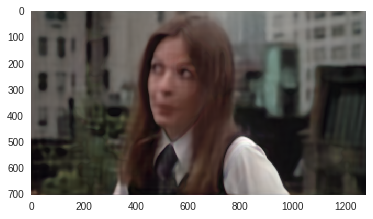

[751, 3505 s] loss: 0.001 
[752, 3505 s] loss: 0.001 
[753, 3506 s] loss: 0.001 
[754, 3507 s] loss: 0.001 
[755, 3507 s] loss: 0.001 
[756, 3508 s] loss: 0.001 
[757, 3509 s] loss: 0.001 
[758, 3509 s] loss: 0.000 
[759, 3510 s] loss: 0.000 
[760, 3511 s] loss: 0.000 
[761, 3511 s] loss: 0.000 
[762, 3512 s] loss: 0.000 
[763, 3513 s] loss: 0.000 
[764, 3513 s] loss: 0.000 
[765, 3514 s] loss: 0.000 
[766, 3514 s] loss: 0.000 
[767, 3515 s] loss: 0.000 
[768, 3516 s] loss: 0.000 
[769, 3516 s] loss: 0.000 
[770, 3517 s] loss: 0.000 
[771, 3518 s] loss: 0.000 
[772, 3518 s] loss: 0.000 
[773, 3519 s] loss: 0.000 
[774, 3520 s] loss: 0.000 
[775, 3520 s] loss: 0.000 
[776, 3521 s] loss: 0.000 
[777, 3521 s] loss: 0.000 
[778, 3522 s] loss: 0.000 
[779, 3523 s] loss: 0.000 
[780, 3523 s] loss: 0.000 
[781, 3524 s] loss: 0.000 
[782, 3525 s] loss: 0.000 
[783, 3525 s] loss: 0.000 
[784, 3526 s] loss: 0.000 
[785, 3527 s] loss: 0.000 
[786, 3527 s] loss: 0.000 
[787, 3528 s] loss: 0.000 
[

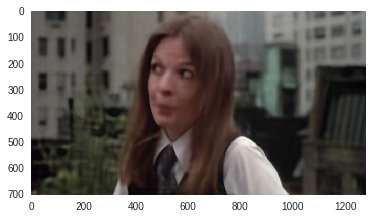

[801, 3540 s] loss: 0.001 
[802, 3540 s] loss: 0.000 
[803, 3541 s] loss: 0.000 
[804, 3541 s] loss: 0.000 
[805, 3542 s] loss: 0.000 
[806, 3543 s] loss: 0.000 
[807, 3543 s] loss: 0.000 
[808, 3544 s] loss: 0.000 
[809, 3545 s] loss: 0.000 
[810, 3545 s] loss: 0.000 
[811, 3546 s] loss: 0.000 
[812, 3547 s] loss: 0.000 
[813, 3547 s] loss: 0.000 
[814, 3548 s] loss: 0.000 
[815, 3549 s] loss: 0.000 
[816, 3549 s] loss: 0.000 
[817, 3550 s] loss: 0.000 
[818, 3550 s] loss: 0.000 
[819, 3551 s] loss: 0.000 
[820, 3552 s] loss: 0.000 
[821, 3552 s] loss: 0.000 
[822, 3553 s] loss: 0.000 
[823, 3554 s] loss: 0.000 
[824, 3554 s] loss: 0.000 
[825, 3555 s] loss: 0.000 
[826, 3556 s] loss: 0.000 
[827, 3556 s] loss: 0.000 
[828, 3557 s] loss: 0.000 
[829, 3557 s] loss: 0.000 
[830, 3558 s] loss: 0.000 
[831, 3559 s] loss: 0.000 
[832, 3559 s] loss: 0.000 
[833, 3560 s] loss: 0.000 
[834, 3561 s] loss: 0.000 
[835, 3561 s] loss: 0.000 
[836, 3562 s] loss: 0.000 
[837, 3563 s] loss: 0.000 
[

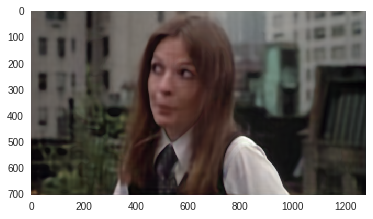

[851, 3575 s] loss: 0.000 
[852, 3575 s] loss: 0.000 
[853, 3576 s] loss: 0.000 
[854, 3576 s] loss: 0.000 
[855, 3577 s] loss: 0.000 
[856, 3578 s] loss: 0.000 
[857, 3578 s] loss: 0.000 
[858, 3579 s] loss: 0.000 
[859, 3579 s] loss: 0.000 
[860, 3580 s] loss: 0.000 
[861, 3581 s] loss: 0.000 
[862, 3581 s] loss: 0.000 
[863, 3582 s] loss: 0.000 
[864, 3583 s] loss: 0.000 
[865, 3583 s] loss: 0.000 
[866, 3584 s] loss: 0.000 
[867, 3585 s] loss: 0.000 
[868, 3585 s] loss: 0.000 
[869, 3586 s] loss: 0.000 
[870, 3586 s] loss: 0.000 
[871, 3587 s] loss: 0.000 
[872, 3588 s] loss: 0.000 
[873, 3588 s] loss: 0.000 
[874, 3589 s] loss: 0.000 
[875, 3590 s] loss: 0.000 
[876, 3590 s] loss: 0.000 
[877, 3591 s] loss: 0.000 
[878, 3592 s] loss: 0.000 
[879, 3592 s] loss: 0.000 
[880, 3593 s] loss: 0.000 
[881, 3593 s] loss: 0.000 
[882, 3594 s] loss: 0.000 
[883, 3595 s] loss: 0.000 
[884, 3595 s] loss: 0.000 
[885, 3596 s] loss: 0.000 
[886, 3597 s] loss: 0.000 
[887, 3597 s] loss: 0.000 
[

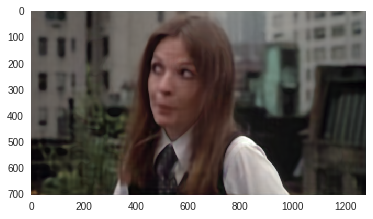

[901, 3609 s] loss: 0.000 
[902, 3609 s] loss: 0.000 
[903, 3610 s] loss: 0.000 
[904, 3611 s] loss: 0.000 
[905, 3611 s] loss: 0.000 
[906, 3612 s] loss: 0.000 
[907, 3613 s] loss: 0.000 
[908, 3613 s] loss: 0.000 
[909, 3614 s] loss: 0.000 
[910, 3615 s] loss: 0.000 
[911, 3615 s] loss: 0.000 
[912, 3616 s] loss: 0.000 
[913, 3617 s] loss: 0.000 
[914, 3617 s] loss: 0.000 
[915, 3618 s] loss: 0.000 
[916, 3618 s] loss: 0.000 
[917, 3619 s] loss: 0.000 
[918, 3620 s] loss: 0.000 
[919, 3620 s] loss: 0.000 
[920, 3621 s] loss: 0.000 
[921, 3622 s] loss: 0.000 
[922, 3622 s] loss: 0.000 
[923, 3623 s] loss: 0.000 
[924, 3624 s] loss: 0.000 
[925, 3624 s] loss: 0.000 
[926, 3625 s] loss: 0.000 
[927, 3625 s] loss: 0.000 
[928, 3626 s] loss: 0.001 
[929, 3627 s] loss: 0.001 
[930, 3627 s] loss: 0.001 
[931, 3628 s] loss: 0.001 
[932, 3629 s] loss: 0.001 
[933, 3629 s] loss: 0.001 
[934, 3630 s] loss: 0.001 
[935, 3631 s] loss: 0.001 
[936, 3631 s] loss: 0.001 
[937, 3632 s] loss: 0.001 
[

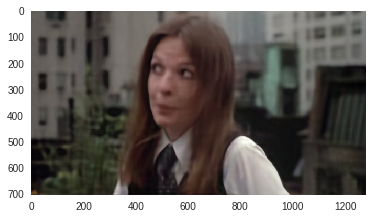

[951, 3644 s] loss: 0.000 
[952, 3644 s] loss: 0.000 
[953, 3645 s] loss: 0.000 
[954, 3646 s] loss: 0.000 
[955, 3646 s] loss: 0.000 
[956, 3647 s] loss: 0.000 
[957, 3647 s] loss: 0.000 
[958, 3648 s] loss: 0.000 
[959, 3649 s] loss: 0.000 
[960, 3649 s] loss: 0.000 
[961, 3650 s] loss: 0.000 
[962, 3651 s] loss: 0.000 
[963, 3651 s] loss: 0.000 
[964, 3652 s] loss: 0.000 
[965, 3653 s] loss: 0.000 
[966, 3653 s] loss: 0.000 
[967, 3654 s] loss: 0.000 
[968, 3654 s] loss: 0.000 
[969, 3655 s] loss: 0.000 
[970, 3656 s] loss: 0.000 
[971, 3656 s] loss: 0.000 
[972, 3657 s] loss: 0.000 
[973, 3658 s] loss: 0.000 
[974, 3658 s] loss: 0.000 
[975, 3659 s] loss: 0.000 
[976, 3660 s] loss: 0.000 
[977, 3660 s] loss: 0.000 
[978, 3661 s] loss: 0.000 
[979, 3661 s] loss: 0.000 
[980, 3662 s] loss: 0.000 
[981, 3663 s] loss: 0.000 
[982, 3663 s] loss: 0.000 
[983, 3664 s] loss: 0.000 
[984, 3665 s] loss: 0.000 
[985, 3665 s] loss: 0.000 
[986, 3666 s] loss: 0.000 
[987, 3667 s] loss: 0.000 
[

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:158: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


PicklingError: ignored

In [72]:
#main training with transfer

def makeInputsWithZeroOneHot(onehotinput, numImages):
  #assumes 32 channels in noisy input
  noisyImage = onehotinput[0:1,0:32,:,:]
  outImage = padit(noisyImage, numImages, -1)
  return outImage
  
zeroOneHotInput = makeInputsWithZeroOneHot(oneHotInput, 4)

# Try multi
#model = load_model('multiTraintrained.pt')
acc = []
trainLoss = []

criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)
i=3
mask_fname = 'snapshot' + str(i) + '_mask.png'
withoutsubs_fname = 'snapshot' + str(i) + '_withoutsubs.png'
model_after_transfer = train_model_loadMultiModel(net, 4, zeroOneHotInput, mask_fname, withoutsubs_fname, criterion, optimizer, maxepochs=1000, fname='m1_3k_transfer')

# General Inpainting (not text inpaining)

In [0]:
import requests
import shutil
path = 'library.png'
r = requests.get('https://github.com/DmitryUlyanov/deep-image-prior/raw/master/data/inpainting/1.png', stream=True)
if r.status_code == 200:
    with open(path, 'wb') as f:
        r.raw.decode_content = True
        shutil.copyfileobj(r.raw, f)    
path = 'library_mask.png'
r = requests.get('https://github.com/DmitryUlyanov/deep-image-prior/raw/master/data/inpainting/1_mask.png', stream=True)
if r.status_code == 200:
    with open(path, 'wb') as f:
        r.raw.decode_content = True
        shutil.copyfileobj(r.raw, f)    

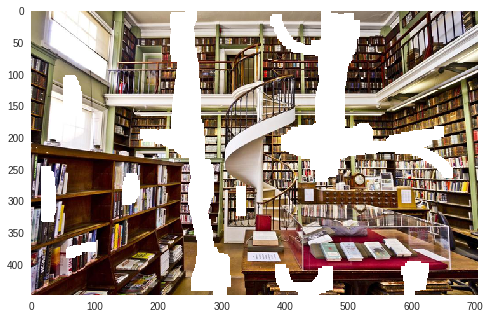

In [91]:
mask = mpimg.imread(mask_fname)
mask = mask[:, :, None]
image = mpimg.imread(image_fname)
mask = 1 - mask
out = np.clip(mask+image,0,1)
plt.imshow(out)
plt.imsave('masked_image.png', out)

In [0]:
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

LeakyReLU = nn.LeakyReLU(0.2, inplace=True)

num_channels_down=[16, 32, 64, 128, 128, 128]
num_channels_up=[16, 32, 64, 128, 128, 128]
num_channels_skip=[0, 0, 0, 0, 0, 0]
num_channels_input = 1
k_down = 5
k_up = 3

padding_down = int((k_down-1)/2)
padding_up = int((k_up-1)/2)
# padding_skip = int((k_skip-1)/2)

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        #-----------------------------------------------------------------------
        #----------------------------- Down blocks -----------------------------
        #-----------------------------------------------------------------------
        
        i = 0 # for first
        #first down block, others are copypaste
        self.down1_downsample = nn.Conv2d(num_channels_input, num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down1_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down1_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down1_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 1
        self.down2_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down2_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down2_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down2_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 2
        self.down3_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down3_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down3_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down3_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 3
        self.down4_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down4_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down4_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down4_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 4
        self.down5_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down5_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down5_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down5_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        
        i = 5
        self.down6_downsample = nn.Conv2d(num_channels_down[i-1], num_channels_down[i], k_down, stride=2, padding=padding_down)
        self.down6_bn_downsample = nn.BatchNorm2d(num_channels_down[i])
        self.down6_justconv = nn.Conv2d(num_channels_down[i], num_channels_down[i], k_down, stride=1, padding=padding_down)
        self.down6_bn_justconv = nn.BatchNorm2d(num_channels_down[i])
        #-----------------------------------------------------------------------
        #----------------------------- Skip blocks -----------------------------
        #-----------------------------------------------------------------------
        
#         i = 0 # for first
#         #first skip block, others are copypaste
#         self.skip1_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
#         self.skip1_bn = nn.BatchNorm2d(num_channels_skip[i])
        
#         i = 1
#         self.skip2_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
#         self.skip2_bn = nn.BatchNorm2d(num_channels_skip[i])
        
#         i = 2
#         self.skip3_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
#         self.skip3_bn = nn.BatchNorm2d(num_channels_skip[i])
        
#         i = 3
#         self.skip4_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
#         self.skip4_bn = nn.BatchNorm2d(num_channels_skip[i])
        
#         i = 4
#         self.skip5_conv = nn.Conv2d(num_channels_down[i], num_channels_skip[i], k_skip, stride=1, padding=padding_skip)
#         self.skip5_bn = nn.BatchNorm2d(num_channels_skip[i])
        
        #-----------------------------------------------------------------------
        #--------------------------- Misc but needed ---------------------------
        #-----------------------------------------------------------------------
        
        #will need this for the up layers
        self.upsample = nn.Upsample(scale_factor=2, mode='nearest') #at the end
        num_channels_up.append(num_channels_down[i]) #this way for the fifth layers the combined is just the skip
        #will need this at the end of network
        self.makeFinalOutput = nn.Conv2d(num_channels_up[0],3,1)
        
        #-----------------------------------------------------------------------
        #------------------------------ Up blocks ------------------------------
        #-----------------------------------------------------------------------
        
        i=5 # for fifth
        #fifth up block, others are copypaste
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i]; #num_channels_up[5] is 0
        self.up6_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up6_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up6_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up6_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up6_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=4 # for fifth
        #fifth up block, others are copypaste
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i]; #num_channels_up[5] is 0
        self.up5_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up5_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up5_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up5_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up5_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=3
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up4_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up4_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up4_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up4_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up4_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=2
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up3_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up3_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up3_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up3_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up3_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=1
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up2_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up2_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up2_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up2_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up2_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
        i=0
        combinedNumChannels = num_channels_up[i+1] + num_channels_skip[i];
        self.up1_bn_initial = nn.BatchNorm2d(combinedNumChannels)
        self.up1_conv1 = nn.Conv2d(combinedNumChannels, num_channels_up[i], k_up, stride=1, padding=padding_up)
        self.up1_bn1 = nn.BatchNorm2d(num_channels_up[i])
        self.up1_conv2 = nn.Conv2d(num_channels_up[i], num_channels_up[i], 1, stride=1, padding=0)
        self.up1_bn2 = nn.BatchNorm2d(num_channels_up[i])
        
    def forward(self, x):
        #-----------------------------------------------------------------------
        #-------------------- Downsampling and recording skip ------------------
        #-----------------------------------------------------------------------
        x = LeakyReLU(self.down1_bn_downsample(self.down1_downsample(x)))
        x = LeakyReLU(self.down1_bn_justconv(self.down1_justconv(x)))
#         skips1 = LeakyReLU(self.skip1_bn(self.skip1_conv(x)))
        
        x = LeakyReLU(self.down2_bn_downsample(self.down2_downsample(x)))
        x = LeakyReLU(self.down2_bn_justconv(self.down2_justconv(x)))
#         skips2 = LeakyReLU(self.skip2_bn(self.skip2_conv(x)))
        
        x = LeakyReLU(self.down3_bn_downsample(self.down3_downsample(x)))
        x = LeakyReLU(self.down3_bn_justconv(self.down3_justconv(x)))
#         skips3 = LeakyReLU(self.skip3_bn(self.skip3_conv(x)))
        
        x = LeakyReLU(self.down4_bn_downsample(self.down4_downsample(x)))
        x = LeakyReLU(self.down4_bn_justconv(self.down4_justconv(x)))
#         skips4 = LeakyReLU(self.skip4_bn(self.skip4_conv(x)))
        
        x = LeakyReLU(self.down5_bn_downsample(self.down5_downsample(x)))
        x = LeakyReLU(self.down5_bn_justconv(self.down5_justconv(x)))
#         skips5 = LeakyReLU(self.skip5_bn(self.skip5_conv(x)))

        x = LeakyReLU(self.down6_bn_downsample(self.down6_downsample(x)))
        x = LeakyReLU(self.down6_bn_justconv(self.down6_justconv(x)))
        
        #-----------------------------------------------------------------------
        #------------------------------ Upsampling -----------------------------
        #-----------------------------------------------------------------------
        
        x = self.up6_bn_initial(x) #notice no concatenation here
        x = LeakyReLU(self.up5_bn1(self.up5_conv1(x)))
        x = LeakyReLU(self.up5_bn2(self.up5_conv2(x)))
        x = self.upsample(x)
        
        #we start at the fifth layer (layers have reverse order)
        x = self.up5_bn_initial(x) #notice no concatenation here
        x = LeakyReLU(self.up5_bn1(self.up5_conv1(x)))
        x = LeakyReLU(self.up5_bn2(self.up5_conv2(x)))
        x = self.upsample(x)
        
        #now we upsample all the other layers
        #print("up4")
        #print(x.size())
        #print(skips4.size())
        x = self.up4_bn_initial(x)
        x = LeakyReLU(self.up4_bn1(self.up4_conv1(x)))
        x = LeakyReLU(self.up4_bn2(self.up4_conv2(x)))
        x = self.upsample(x)
        
        #print("up3")
        #print(x.size())
        #print(skips3.size())
        x = self.up3_bn_initial(x)
        x = LeakyReLU(self.up3_bn1(self.up3_conv1(x)))
        x = LeakyReLU(self.up3_bn2(self.up3_conv2(x)))
        x = self.upsample(x)
        
        #print("up2")
        #print(x.size())
        #print(skips2.size())
        x = self.up2_bn_initial(x)
        x = LeakyReLU(self.up2_bn1(self.up2_conv1(x)))
        x = LeakyReLU(self.up2_bn2(self.up2_conv2(x)))
        x = self.upsample(x)
        
        #print("up1")
        #print(x.size())
        #print(skips1.size())
        x = self.up1_bn_initial(x)
        x = LeakyReLU(self.up1_bn1(self.up1_conv1(x)))
        x = LeakyReLU(self.up1_bn2(self.up1_conv2(x)))
        x = self.upsample(x)
        
        
        #-----------------------------------------------------------------------
        #------------------------------- Finalize ------------------------------
        #-----------------------------------------------------------------------

        #now we get x to the right dimensions
        x = self.makeFinalOutput(x) #not sure if we need the leaky ReLU here
        
        return x

In [76]:
#Saving a random model
net = Net()
net.cuda()

Net(
  (down1_downsample): Conv2d (1, 16, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
  (down1_bn_downsample): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down1_justconv): Conv2d (16, 16, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (down1_bn_justconv): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True)
  (down2_downsample): Conv2d (16, 32, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
  (down2_bn_downsample): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down2_justconv): Conv2d (32, 32, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (down2_bn_justconv): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True)
  (down3_downsample): Conv2d (32, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
  (down3_bn_downsample): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
  (down3_justconv): Conv2d (64, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (down3_bn_justconv): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)


In [0]:
def createNoisyImage(input_depth,dimensions,var=0.1,noiseType='uniform'):
  tensorShape = [1,input_depth,dimensions[0],dimensions[1]]
  networkInput = Variable(torch.zeros(tensorShape))
  
  if noiseType == "uniform":
    networkInput.data.uniform_()
  elif noiseType == "normal":
    networkInput.data.normal_()
  
  networkInput.data = networkInput.data * var
  
  return networkInput



superResolutionBase = createNoisyImage(1,[448,704],0.1,"uniform")
base = superResolutionBase
savedBase = base.data.clone().cuda()
baseNoise = base.data.clone().cuda()

def train_model_inpainting(net, mask_fname, image_fname, criterion, optimizer, maxepochs=3000, fname='output'):
  mask = mpimg.imread(mask_fname)
  mask = mask[None, :]
  image = mpimg.imread(image_fname)
  imageTensor = Variable(torch.Tensor(image))
  imageTensor = imageTensor.permute(2, 0, 1)
  maskTensor = Variable(torch.Tensor(mask))
  imageTensor = imageTensor.cuda()
  maskTensor = maskTensor.cuda()
  
  # get the input
  inputs = superResolutionBase #this is the z = uniform noise input
      
  for epoch in range(maxepochs):  # loop over the data multiple times  
      for n in [x for x in net.parameters() if len(x.size()) == 4]:
        n.data += n.data.clone().normal_()*n.data.std()/50

      # get the label
      label = imageTensor

      # wrap them in Variable
      inputs, label = inputs.cuda(), label.cuda()

      # zero the parameter gradients
      optimizer.zero_grad()

#       inputs = addRandomNoise(inputs)

      #print("backpropagation time")
      # forward + backward + optimize
      outputs = net(inputs)
      outputs=outputs[0]
#       outputs = outputs.permute(1,2,0)
      loss = criterion(outputs * maskTensor, label * maskTensor)
      loss.backward()
      optimizer.step()

      #if epoch%5==0:
        #print("We are at epoch " + str(epoch))

      #save the image every 100 epochs
      if epoch%100==0:
  #         pp = PdfPages('subsTest' + str(epoch) + '.pdf')

        arr = np.array(outputs.data)
        arr = arr.transpose(1,2,0)
        arr = np.clip(arr, 0, 1)
        plt.rcParams["axes.grid"] = False
        plt.imshow(arr)
#         plt.savefig(pp, format='pdf')
#         pp.close()
        plt.imsave(fname + 'subsTest' + str(epoch) + '.png', arr)
        file1 = drive.CreateFile()
        file1.SetContentFile(fname + 'subsTest' + str(epoch) + '.png')
        file1.Upload() # Upload the file.
        plt.show()
        pass

      #print some results
      if epoch == 0:
          k = -1
      else:
          k = -2
      print('[%d, %d s] loss: %.3f '% (epoch + 1, int(time.time() - startime), loss.data[0]))
      trainLoss.append(loss.data[0])

  print("Final train loss")
  print(trainLoss[len(trainLoss)-1])

  print('Finished Training. See training time on next line')
  print(int(time.time() - startime))
  save_model(net, fname+'trained.pt')
  file1 = drive.CreateFile()
  file1.SetContentFile(fname+'trained.pt')
  file1.Upload() # Upload the file.
  return net

Started Training


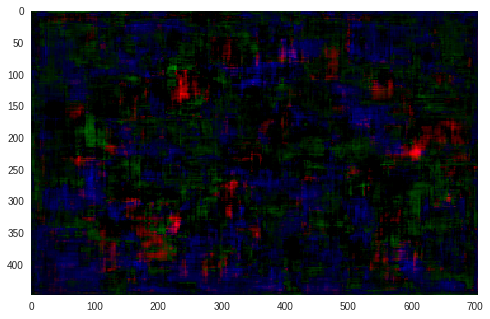

[1, 1 s] loss: 0.306 
[2, 1 s] loss: 0.258 
[3, 1 s] loss: 0.241 
[4, 1 s] loss: 0.187 
[5, 1 s] loss: 0.157 
[6, 1 s] loss: 0.131 
[7, 1 s] loss: 0.111 
[8, 1 s] loss: 0.095 
[9, 1 s] loss: 0.082 
[10, 1 s] loss: 0.072 
[11, 2 s] loss: 0.065 
[12, 2 s] loss: 0.061 
[13, 2 s] loss: 0.059 
[14, 2 s] loss: 0.060 
[15, 2 s] loss: 0.059 
[16, 2 s] loss: 0.059 
[17, 2 s] loss: 0.059 
[18, 2 s] loss: 0.058 
[19, 2 s] loss: 0.058 
[20, 2 s] loss: 0.057 
[21, 2 s] loss: 0.055 
[22, 2 s] loss: 0.054 
[23, 2 s] loss: 0.053 
[24, 3 s] loss: 0.052 
[25, 3 s] loss: 0.051 
[26, 3 s] loss: 0.051 
[27, 3 s] loss: 0.050 
[28, 3 s] loss: 0.049 
[29, 3 s] loss: 0.048 
[30, 3 s] loss: 0.048 
[31, 3 s] loss: 0.047 
[32, 3 s] loss: 0.047 
[33, 3 s] loss: 0.047 
[34, 3 s] loss: 0.046 
[35, 3 s] loss: 0.046 
[36, 3 s] loss: 0.046 
[37, 4 s] loss: 0.045 
[38, 4 s] loss: 0.045 
[39, 4 s] loss: 0.044 
[40, 4 s] loss: 0.044 
[41, 4 s] loss: 0.044 
[42, 4 s] loss: 0.044 
[43, 4 s] loss: 0.043 
[44, 4 s] loss: 0.04

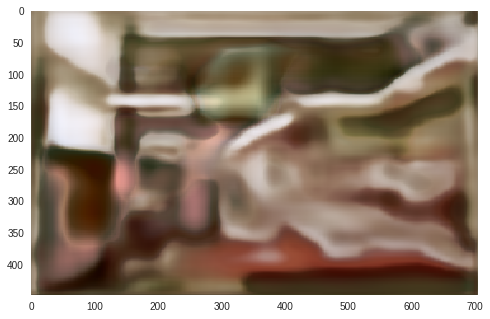

[101, 10 s] loss: 0.037 
[102, 10 s] loss: 0.035 
[103, 10 s] loss: 0.036 
[104, 10 s] loss: 0.035 
[105, 10 s] loss: 0.035 
[106, 10 s] loss: 0.035 
[107, 11 s] loss: 0.034 
[108, 11 s] loss: 0.034 
[109, 11 s] loss: 0.034 
[110, 11 s] loss: 0.034 
[111, 11 s] loss: 0.034 
[112, 11 s] loss: 0.035 
[113, 11 s] loss: 0.036 
[114, 11 s] loss: 0.035 
[115, 11 s] loss: 0.034 
[116, 11 s] loss: 0.034 
[117, 11 s] loss: 0.034 
[118, 11 s] loss: 0.033 
[119, 11 s] loss: 0.033 
[120, 12 s] loss: 0.033 
[121, 12 s] loss: 0.033 
[122, 12 s] loss: 0.033 
[123, 12 s] loss: 0.032 
[124, 12 s] loss: 0.033 
[125, 12 s] loss: 0.032 
[126, 12 s] loss: 0.032 
[127, 12 s] loss: 0.032 
[128, 12 s] loss: 0.032 
[129, 12 s] loss: 0.032 
[130, 12 s] loss: 0.032 
[131, 12 s] loss: 0.033 
[132, 13 s] loss: 0.034 
[133, 13 s] loss: 0.033 
[134, 13 s] loss: 0.033 
[135, 13 s] loss: 0.033 
[136, 13 s] loss: 0.032 
[137, 13 s] loss: 0.032 
[138, 13 s] loss: 0.032 
[139, 13 s] loss: 0.031 
[140, 13 s] loss: 0.031 


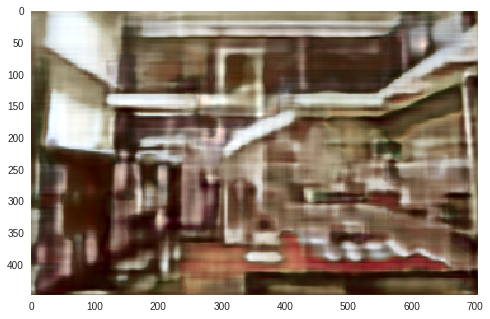

[201, 19 s] loss: 0.025 
[202, 20 s] loss: 0.025 
[203, 20 s] loss: 0.026 
[204, 20 s] loss: 0.025 
[205, 20 s] loss: 0.024 
[206, 20 s] loss: 0.024 
[207, 20 s] loss: 0.024 
[208, 20 s] loss: 0.024 
[209, 20 s] loss: 0.024 
[210, 20 s] loss: 0.024 
[211, 20 s] loss: 0.024 
[212, 20 s] loss: 0.024 
[213, 20 s] loss: 0.024 
[214, 20 s] loss: 0.023 
[215, 21 s] loss: 0.023 
[216, 21 s] loss: 0.024 
[217, 21 s] loss: 0.023 
[218, 21 s] loss: 0.023 
[219, 21 s] loss: 0.023 
[220, 21 s] loss: 0.023 
[221, 21 s] loss: 0.024 
[222, 21 s] loss: 0.023 
[223, 21 s] loss: 0.023 
[224, 21 s] loss: 0.023 
[225, 21 s] loss: 0.023 
[226, 21 s] loss: 0.023 
[227, 22 s] loss: 0.022 
[228, 22 s] loss: 0.023 
[229, 22 s] loss: 0.023 
[230, 22 s] loss: 0.023 
[231, 22 s] loss: 0.023 
[232, 22 s] loss: 0.023 
[233, 22 s] loss: 0.022 
[234, 22 s] loss: 0.022 
[235, 22 s] loss: 0.023 
[236, 22 s] loss: 0.022 
[237, 22 s] loss: 0.022 
[238, 22 s] loss: 0.022 
[239, 22 s] loss: 0.022 
[240, 23 s] loss: 0.022 


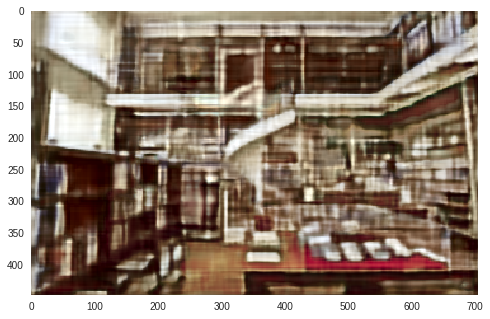

[301, 29 s] loss: 0.018 
[302, 29 s] loss: 0.018 
[303, 29 s] loss: 0.018 
[304, 29 s] loss: 0.018 
[305, 29 s] loss: 0.018 
[306, 29 s] loss: 0.017 
[307, 29 s] loss: 0.018 
[308, 29 s] loss: 0.018 
[309, 29 s] loss: 0.017 
[310, 29 s] loss: 0.017 
[311, 29 s] loss: 0.017 
[312, 30 s] loss: 0.017 
[313, 30 s] loss: 0.017 
[314, 30 s] loss: 0.017 
[315, 30 s] loss: 0.017 
[316, 30 s] loss: 0.017 
[317, 30 s] loss: 0.017 
[318, 30 s] loss: 0.017 
[319, 30 s] loss: 0.017 
[320, 30 s] loss: 0.017 
[321, 30 s] loss: 0.017 
[322, 30 s] loss: 0.017 
[323, 30 s] loss: 0.017 
[324, 31 s] loss: 0.017 
[325, 31 s] loss: 0.017 
[326, 31 s] loss: 0.016 
[327, 31 s] loss: 0.016 
[328, 31 s] loss: 0.016 
[329, 31 s] loss: 0.017 
[330, 31 s] loss: 0.017 
[331, 31 s] loss: 0.017 
[332, 31 s] loss: 0.017 
[333, 31 s] loss: 0.017 
[334, 31 s] loss: 0.017 
[335, 31 s] loss: 0.016 
[336, 31 s] loss: 0.017 
[337, 32 s] loss: 0.016 
[338, 32 s] loss: 0.016 
[339, 32 s] loss: 0.017 
[340, 32 s] loss: 0.016 


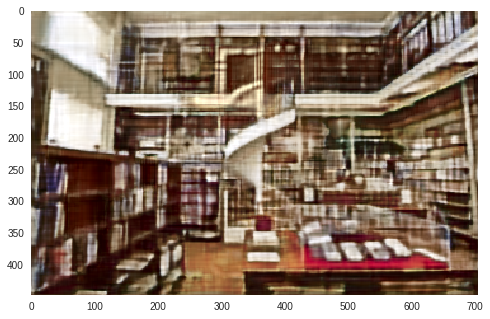

[401, 38 s] loss: 0.015 
[402, 38 s] loss: 0.015 
[403, 38 s] loss: 0.014 
[404, 38 s] loss: 0.015 
[405, 38 s] loss: 0.015 
[406, 38 s] loss: 0.015 
[407, 38 s] loss: 0.014 
[408, 38 s] loss: 0.014 
[409, 39 s] loss: 0.014 
[410, 39 s] loss: 0.014 
[411, 39 s] loss: 0.014 
[412, 39 s] loss: 0.014 
[413, 39 s] loss: 0.014 
[414, 39 s] loss: 0.014 
[415, 39 s] loss: 0.014 
[416, 39 s] loss: 0.014 
[417, 39 s] loss: 0.014 
[418, 39 s] loss: 0.014 
[419, 39 s] loss: 0.014 
[420, 39 s] loss: 0.014 
[421, 39 s] loss: 0.014 
[422, 40 s] loss: 0.014 
[423, 40 s] loss: 0.014 
[424, 40 s] loss: 0.014 
[425, 40 s] loss: 0.014 
[426, 40 s] loss: 0.014 
[427, 40 s] loss: 0.014 
[428, 40 s] loss: 0.014 
[429, 40 s] loss: 0.014 
[430, 40 s] loss: 0.014 
[431, 40 s] loss: 0.014 
[432, 40 s] loss: 0.014 
[433, 40 s] loss: 0.014 
[434, 41 s] loss: 0.014 
[435, 41 s] loss: 0.014 
[436, 41 s] loss: 0.013 
[437, 41 s] loss: 0.014 
[438, 41 s] loss: 0.013 
[439, 41 s] loss: 0.013 
[440, 41 s] loss: 0.013 


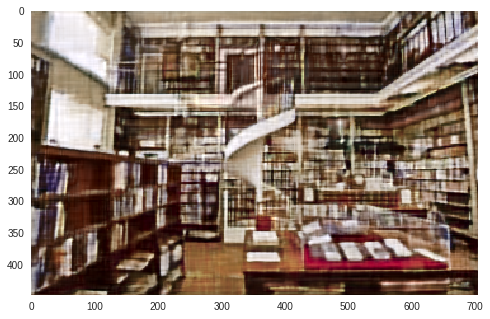

[501, 47 s] loss: 0.012 
[502, 47 s] loss: 0.012 
[503, 47 s] loss: 0.012 
[504, 47 s] loss: 0.012 
[505, 47 s] loss: 0.012 
[506, 47 s] loss: 0.012 
[507, 48 s] loss: 0.012 
[508, 48 s] loss: 0.012 
[509, 48 s] loss: 0.012 
[510, 48 s] loss: 0.012 
[511, 48 s] loss: 0.012 
[512, 48 s] loss: 0.012 
[513, 48 s] loss: 0.012 
[514, 48 s] loss: 0.012 
[515, 48 s] loss: 0.012 
[516, 48 s] loss: 0.012 
[517, 48 s] loss: 0.012 
[518, 48 s] loss: 0.012 
[519, 48 s] loss: 0.012 
[520, 49 s] loss: 0.012 
[521, 49 s] loss: 0.012 
[522, 49 s] loss: 0.012 
[523, 49 s] loss: 0.012 
[524, 49 s] loss: 0.012 
[525, 49 s] loss: 0.012 
[526, 49 s] loss: 0.012 
[527, 49 s] loss: 0.013 
[528, 49 s] loss: 0.012 
[529, 49 s] loss: 0.012 
[530, 49 s] loss: 0.012 
[531, 49 s] loss: 0.012 
[532, 50 s] loss: 0.012 
[533, 50 s] loss: 0.012 
[534, 50 s] loss: 0.012 
[535, 50 s] loss: 0.012 
[536, 50 s] loss: 0.012 
[537, 50 s] loss: 0.012 
[538, 50 s] loss: 0.012 
[539, 50 s] loss: 0.012 
[540, 50 s] loss: 0.012 


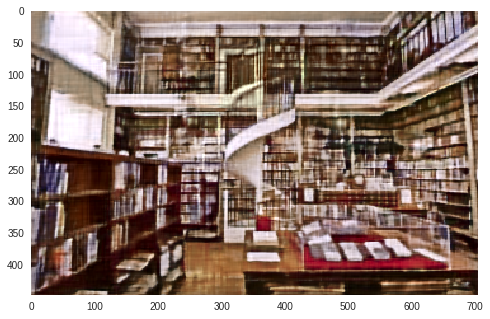

[601, 56 s] loss: 0.011 
[602, 56 s] loss: 0.012 
[603, 56 s] loss: 0.011 
[604, 56 s] loss: 0.011 
[605, 57 s] loss: 0.011 
[606, 57 s] loss: 0.011 
[607, 57 s] loss: 0.011 
[608, 57 s] loss: 0.011 
[609, 57 s] loss: 0.011 
[610, 57 s] loss: 0.011 
[611, 57 s] loss: 0.011 
[612, 57 s] loss: 0.011 
[613, 57 s] loss: 0.011 
[614, 57 s] loss: 0.011 
[615, 57 s] loss: 0.011 
[616, 57 s] loss: 0.011 
[617, 57 s] loss: 0.011 
[618, 58 s] loss: 0.011 
[619, 58 s] loss: 0.011 
[620, 58 s] loss: 0.011 
[621, 58 s] loss: 0.011 
[622, 58 s] loss: 0.011 
[623, 58 s] loss: 0.011 
[624, 58 s] loss: 0.011 
[625, 58 s] loss: 0.011 
[626, 58 s] loss: 0.011 
[627, 58 s] loss: 0.011 
[628, 58 s] loss: 0.011 
[629, 58 s] loss: 0.011 
[630, 59 s] loss: 0.011 
[631, 59 s] loss: 0.011 
[632, 59 s] loss: 0.011 
[633, 59 s] loss: 0.011 
[634, 59 s] loss: 0.011 
[635, 59 s] loss: 0.011 
[636, 59 s] loss: 0.011 
[637, 59 s] loss: 0.011 
[638, 59 s] loss: 0.011 
[639, 59 s] loss: 0.011 
[640, 59 s] loss: 0.011 


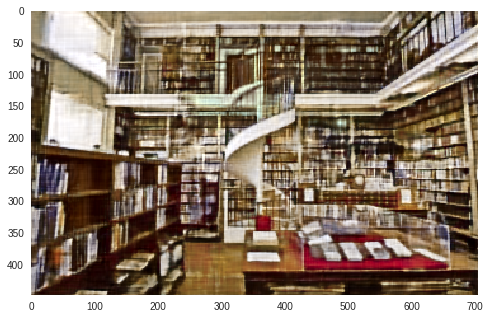

[701, 66 s] loss: 0.011 
[702, 66 s] loss: 0.010 
[703, 66 s] loss: 0.010 
[704, 66 s] loss: 0.010 
[705, 66 s] loss: 0.011 
[706, 66 s] loss: 0.011 
[707, 66 s] loss: 0.011 
[708, 66 s] loss: 0.010 
[709, 66 s] loss: 0.010 
[710, 66 s] loss: 0.010 
[711, 66 s] loss: 0.010 
[712, 66 s] loss: 0.011 
[713, 66 s] loss: 0.010 
[714, 67 s] loss: 0.010 
[715, 67 s] loss: 0.010 
[716, 67 s] loss: 0.010 
[717, 67 s] loss: 0.010 
[718, 67 s] loss: 0.010 
[719, 67 s] loss: 0.010 
[720, 67 s] loss: 0.010 
[721, 67 s] loss: 0.010 
[722, 67 s] loss: 0.010 
[723, 67 s] loss: 0.010 
[724, 67 s] loss: 0.010 
[725, 67 s] loss: 0.010 
[726, 67 s] loss: 0.010 
[727, 68 s] loss: 0.010 
[728, 68 s] loss: 0.010 
[729, 68 s] loss: 0.010 
[730, 68 s] loss: 0.010 
[731, 68 s] loss: 0.010 
[732, 68 s] loss: 0.010 
[733, 68 s] loss: 0.010 
[734, 68 s] loss: 0.010 
[735, 68 s] loss: 0.010 
[736, 68 s] loss: 0.010 
[737, 68 s] loss: 0.010 
[738, 68 s] loss: 0.010 
[739, 69 s] loss: 0.010 
[740, 69 s] loss: 0.010 


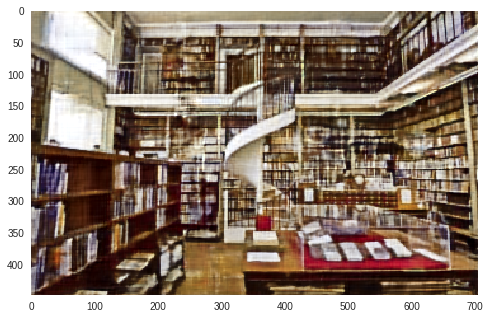

[801, 75 s] loss: 0.010 
[802, 75 s] loss: 0.010 
[803, 75 s] loss: 0.010 
[804, 75 s] loss: 0.010 
[805, 75 s] loss: 0.010 
[806, 75 s] loss: 0.010 
[807, 75 s] loss: 0.010 
[808, 75 s] loss: 0.010 
[809, 75 s] loss: 0.010 
[810, 75 s] loss: 0.010 
[811, 75 s] loss: 0.010 
[812, 76 s] loss: 0.010 
[813, 76 s] loss: 0.010 
[814, 76 s] loss: 0.010 
[815, 76 s] loss: 0.010 
[816, 76 s] loss: 0.010 
[817, 76 s] loss: 0.010 
[818, 76 s] loss: 0.010 
[819, 76 s] loss: 0.010 
[820, 76 s] loss: 0.010 
[821, 76 s] loss: 0.010 
[822, 76 s] loss: 0.010 
[823, 76 s] loss: 0.010 
[824, 77 s] loss: 0.010 
[825, 77 s] loss: 0.010 
[826, 77 s] loss: 0.010 
[827, 77 s] loss: 0.010 
[828, 77 s] loss: 0.010 
[829, 77 s] loss: 0.010 
[830, 77 s] loss: 0.010 
[831, 77 s] loss: 0.010 
[832, 77 s] loss: 0.010 
[833, 77 s] loss: 0.010 
[834, 77 s] loss: 0.010 
[835, 77 s] loss: 0.010 
[836, 77 s] loss: 0.010 
[837, 78 s] loss: 0.010 
[838, 78 s] loss: 0.010 
[839, 78 s] loss: 0.010 
[840, 78 s] loss: 0.010 


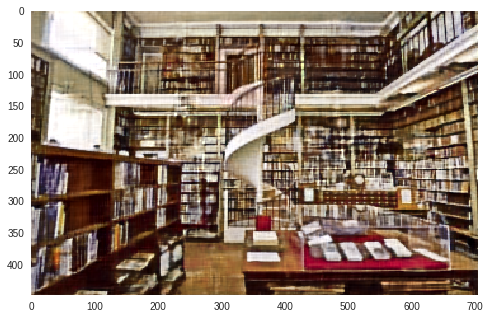

[901, 84 s] loss: 0.009 
[902, 84 s] loss: 0.009 
[903, 84 s] loss: 0.010 
[904, 84 s] loss: 0.009 
[905, 84 s] loss: 0.009 
[906, 84 s] loss: 0.010 
[907, 84 s] loss: 0.009 
[908, 84 s] loss: 0.009 
[909, 85 s] loss: 0.009 
[910, 85 s] loss: 0.010 
[911, 85 s] loss: 0.009 
[912, 85 s] loss: 0.009 
[913, 85 s] loss: 0.009 
[914, 85 s] loss: 0.009 
[915, 85 s] loss: 0.009 
[916, 85 s] loss: 0.009 
[917, 85 s] loss: 0.009 
[918, 85 s] loss: 0.009 
[919, 85 s] loss: 0.009 
[920, 85 s] loss: 0.009 
[921, 86 s] loss: 0.009 
[922, 86 s] loss: 0.009 
[923, 86 s] loss: 0.009 
[924, 86 s] loss: 0.009 
[925, 86 s] loss: 0.009 
[926, 86 s] loss: 0.009 
[927, 86 s] loss: 0.009 
[928, 86 s] loss: 0.009 
[929, 86 s] loss: 0.009 
[930, 86 s] loss: 0.010 
[931, 86 s] loss: 0.009 
[932, 86 s] loss: 0.010 
[933, 86 s] loss: 0.010 
[934, 87 s] loss: 0.009 
[935, 87 s] loss: 0.010 
[936, 87 s] loss: 0.009 
[937, 87 s] loss: 0.010 
[938, 87 s] loss: 0.009 
[939, 87 s] loss: 0.009 
[940, 87 s] loss: 0.009 


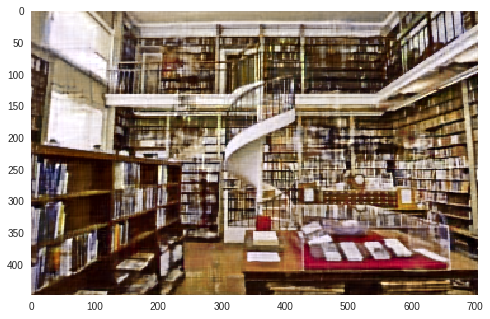

[1001, 93 s] loss: 0.009 
[1002, 94 s] loss: 0.009 
[1003, 94 s] loss: 0.009 
[1004, 94 s] loss: 0.009 
[1005, 94 s] loss: 0.009 
[1006, 94 s] loss: 0.009 
[1007, 94 s] loss: 0.009 
[1008, 94 s] loss: 0.009 
[1009, 94 s] loss: 0.009 
[1010, 94 s] loss: 0.009 
[1011, 94 s] loss: 0.009 
[1012, 94 s] loss: 0.009 
[1013, 94 s] loss: 0.009 
[1014, 95 s] loss: 0.009 
[1015, 95 s] loss: 0.009 
[1016, 95 s] loss: 0.009 
[1017, 95 s] loss: 0.009 
[1018, 95 s] loss: 0.009 
[1019, 95 s] loss: 0.009 
[1020, 95 s] loss: 0.009 
[1021, 95 s] loss: 0.009 
[1022, 95 s] loss: 0.009 
[1023, 95 s] loss: 0.009 
[1024, 95 s] loss: 0.009 
[1025, 95 s] loss: 0.009 
[1026, 95 s] loss: 0.009 
[1027, 96 s] loss: 0.009 
[1028, 96 s] loss: 0.009 
[1029, 96 s] loss: 0.009 
[1030, 96 s] loss: 0.009 
[1031, 96 s] loss: 0.009 
[1032, 96 s] loss: 0.009 
[1033, 96 s] loss: 0.009 
[1034, 96 s] loss: 0.009 
[1035, 96 s] loss: 0.009 
[1036, 96 s] loss: 0.009 
[1037, 96 s] loss: 0.009 
[1038, 96 s] loss: 0.009 
[1039, 97 s]

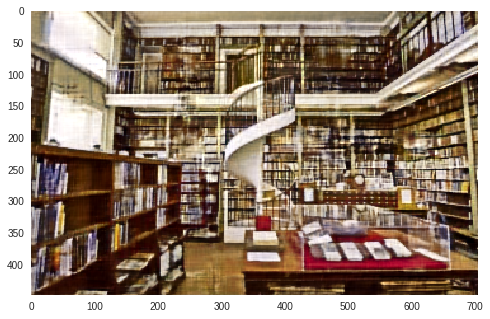

[1101, 103 s] loss: 0.009 
[1102, 103 s] loss: 0.009 
[1103, 103 s] loss: 0.009 
[1104, 103 s] loss: 0.009 
[1105, 103 s] loss: 0.009 
[1106, 103 s] loss: 0.009 
[1107, 103 s] loss: 0.009 
[1108, 103 s] loss: 0.009 
[1109, 103 s] loss: 0.009 
[1110, 103 s] loss: 0.009 
[1111, 104 s] loss: 0.009 
[1112, 104 s] loss: 0.009 
[1113, 104 s] loss: 0.009 
[1114, 104 s] loss: 0.009 
[1115, 104 s] loss: 0.009 
[1116, 104 s] loss: 0.009 
[1117, 104 s] loss: 0.009 
[1118, 104 s] loss: 0.009 
[1119, 104 s] loss: 0.009 
[1120, 104 s] loss: 0.009 
[1121, 104 s] loss: 0.009 
[1122, 104 s] loss: 0.009 
[1123, 104 s] loss: 0.009 
[1124, 105 s] loss: 0.009 
[1125, 105 s] loss: 0.009 
[1126, 105 s] loss: 0.009 
[1127, 105 s] loss: 0.009 
[1128, 105 s] loss: 0.009 
[1129, 105 s] loss: 0.009 
[1130, 105 s] loss: 0.009 
[1131, 105 s] loss: 0.009 
[1132, 105 s] loss: 0.009 
[1133, 105 s] loss: 0.009 
[1134, 105 s] loss: 0.009 
[1135, 105 s] loss: 0.009 
[1136, 106 s] loss: 0.009 
[1137, 106 s] loss: 0.009 
[

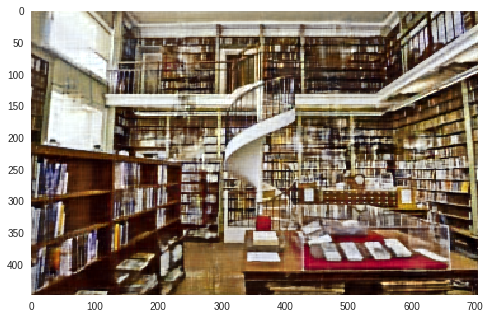

[1201, 113 s] loss: 0.009 
[1202, 113 s] loss: 0.009 
[1203, 113 s] loss: 0.009 
[1204, 113 s] loss: 0.009 
[1205, 113 s] loss: 0.009 
[1206, 113 s] loss: 0.009 
[1207, 113 s] loss: 0.009 
[1208, 113 s] loss: 0.009 
[1209, 113 s] loss: 0.009 
[1210, 113 s] loss: 0.009 
[1211, 113 s] loss: 0.009 
[1212, 113 s] loss: 0.009 
[1213, 114 s] loss: 0.009 
[1214, 114 s] loss: 0.009 
[1215, 114 s] loss: 0.009 
[1216, 114 s] loss: 0.009 
[1217, 114 s] loss: 0.009 
[1218, 114 s] loss: 0.009 
[1219, 114 s] loss: 0.009 
[1220, 114 s] loss: 0.009 
[1221, 114 s] loss: 0.009 
[1222, 114 s] loss: 0.009 
[1223, 114 s] loss: 0.009 
[1224, 114 s] loss: 0.009 
[1225, 115 s] loss: 0.009 
[1226, 115 s] loss: 0.009 
[1227, 115 s] loss: 0.009 
[1228, 115 s] loss: 0.009 
[1229, 115 s] loss: 0.009 
[1230, 115 s] loss: 0.009 
[1231, 115 s] loss: 0.009 
[1232, 115 s] loss: 0.009 
[1233, 115 s] loss: 0.009 
[1234, 115 s] loss: 0.009 
[1235, 115 s] loss: 0.009 
[1236, 115 s] loss: 0.009 
[1237, 115 s] loss: 0.009 
[

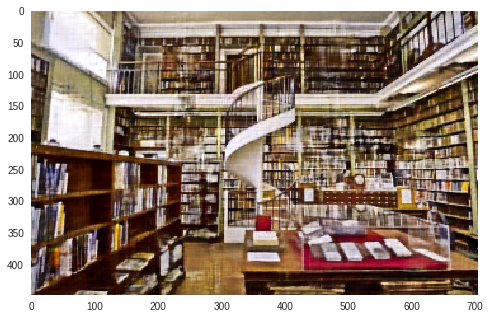

[1301, 122 s] loss: 0.009 
[1302, 122 s] loss: 0.009 
[1303, 122 s] loss: 0.009 
[1304, 122 s] loss: 0.009 
[1305, 122 s] loss: 0.009 
[1306, 122 s] loss: 0.009 
[1307, 122 s] loss: 0.009 
[1308, 122 s] loss: 0.009 
[1309, 122 s] loss: 0.009 
[1310, 122 s] loss: 0.009 
[1311, 123 s] loss: 0.009 
[1312, 123 s] loss: 0.009 
[1313, 123 s] loss: 0.009 
[1314, 123 s] loss: 0.009 
[1315, 123 s] loss: 0.009 
[1316, 123 s] loss: 0.009 
[1317, 123 s] loss: 0.009 
[1318, 123 s] loss: 0.009 
[1319, 123 s] loss: 0.009 
[1320, 123 s] loss: 0.009 
[1321, 123 s] loss: 0.009 
[1322, 123 s] loss: 0.009 
[1323, 123 s] loss: 0.009 
[1324, 124 s] loss: 0.009 
[1325, 124 s] loss: 0.009 
[1326, 124 s] loss: 0.009 
[1327, 124 s] loss: 0.009 
[1328, 124 s] loss: 0.009 
[1329, 124 s] loss: 0.009 
[1330, 124 s] loss: 0.009 
[1331, 124 s] loss: 0.009 
[1332, 124 s] loss: 0.009 
[1333, 124 s] loss: 0.009 
[1334, 124 s] loss: 0.009 
[1335, 124 s] loss: 0.009 
[1336, 125 s] loss: 0.009 
[1337, 125 s] loss: 0.009 
[

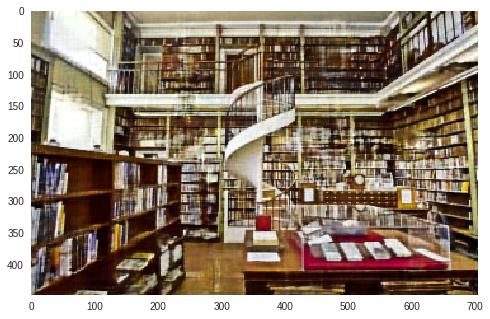

[1401, 131 s] loss: 0.009 
[1402, 131 s] loss: 0.009 
[1403, 131 s] loss: 0.009 
[1404, 132 s] loss: 0.009 
[1405, 132 s] loss: 0.009 
[1406, 132 s] loss: 0.009 
[1407, 132 s] loss: 0.009 
[1408, 132 s] loss: 0.009 
[1409, 132 s] loss: 0.008 
[1410, 132 s] loss: 0.009 
[1411, 132 s] loss: 0.008 
[1412, 132 s] loss: 0.008 
[1413, 132 s] loss: 0.009 
[1414, 132 s] loss: 0.008 
[1415, 132 s] loss: 0.009 
[1416, 133 s] loss: 0.008 
[1417, 133 s] loss: 0.009 
[1418, 133 s] loss: 0.009 
[1419, 133 s] loss: 0.009 
[1420, 133 s] loss: 0.009 
[1421, 133 s] loss: 0.009 
[1422, 133 s] loss: 0.009 
[1423, 133 s] loss: 0.009 
[1424, 133 s] loss: 0.009 
[1425, 133 s] loss: 0.009 
[1426, 133 s] loss: 0.009 
[1427, 133 s] loss: 0.009 
[1428, 133 s] loss: 0.009 
[1429, 134 s] loss: 0.008 
[1430, 134 s] loss: 0.009 
[1431, 134 s] loss: 0.008 
[1432, 134 s] loss: 0.009 
[1433, 134 s] loss: 0.009 
[1434, 134 s] loss: 0.008 
[1435, 134 s] loss: 0.008 
[1436, 134 s] loss: 0.008 
[1437, 134 s] loss: 0.008 
[

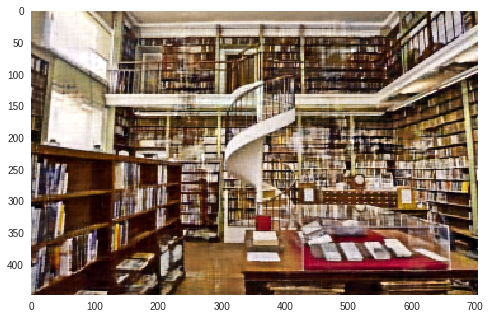

[1501, 141 s] loss: 0.008 
[1502, 141 s] loss: 0.008 
[1503, 141 s] loss: 0.008 
[1504, 141 s] loss: 0.008 
[1505, 141 s] loss: 0.008 
[1506, 141 s] loss: 0.008 
[1507, 141 s] loss: 0.008 
[1508, 141 s] loss: 0.008 
[1509, 141 s] loss: 0.008 
[1510, 141 s] loss: 0.008 
[1511, 141 s] loss: 0.008 
[1512, 142 s] loss: 0.008 
[1513, 142 s] loss: 0.008 
[1514, 142 s] loss: 0.009 
[1515, 142 s] loss: 0.008 
[1516, 142 s] loss: 0.008 
[1517, 142 s] loss: 0.008 
[1518, 142 s] loss: 0.008 
[1519, 142 s] loss: 0.008 
[1520, 142 s] loss: 0.008 
[1521, 142 s] loss: 0.008 
[1522, 142 s] loss: 0.008 
[1523, 142 s] loss: 0.008 
[1524, 143 s] loss: 0.009 
[1525, 143 s] loss: 0.008 
[1526, 143 s] loss: 0.008 
[1527, 143 s] loss: 0.008 
[1528, 143 s] loss: 0.008 
[1529, 143 s] loss: 0.008 
[1530, 143 s] loss: 0.008 
[1531, 143 s] loss: 0.008 
[1532, 143 s] loss: 0.008 
[1533, 143 s] loss: 0.009 
[1534, 143 s] loss: 0.008 
[1535, 143 s] loss: 0.009 
[1536, 143 s] loss: 0.008 
[1537, 144 s] loss: 0.008 
[

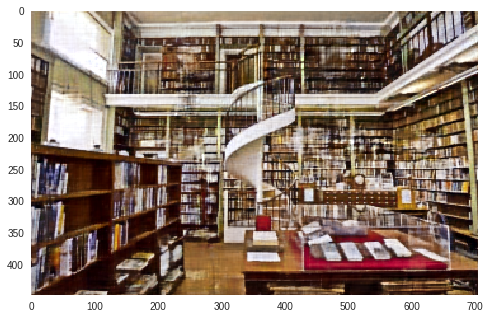

[1601, 150 s] loss: 0.008 
[1602, 150 s] loss: 0.008 
[1603, 150 s] loss: 0.008 
[1604, 150 s] loss: 0.008 
[1605, 150 s] loss: 0.008 
[1606, 150 s] loss: 0.008 
[1607, 150 s] loss: 0.008 
[1608, 150 s] loss: 0.008 
[1609, 151 s] loss: 0.008 
[1610, 151 s] loss: 0.008 
[1611, 151 s] loss: 0.008 
[1612, 151 s] loss: 0.008 
[1613, 151 s] loss: 0.008 
[1614, 151 s] loss: 0.009 
[1615, 151 s] loss: 0.008 
[1616, 151 s] loss: 0.008 
[1617, 151 s] loss: 0.008 
[1618, 151 s] loss: 0.009 
[1619, 151 s] loss: 0.008 
[1620, 151 s] loss: 0.009 
[1621, 152 s] loss: 0.008 
[1622, 152 s] loss: 0.008 
[1623, 152 s] loss: 0.008 
[1624, 152 s] loss: 0.008 
[1625, 152 s] loss: 0.008 
[1626, 152 s] loss: 0.008 
[1627, 152 s] loss: 0.008 
[1628, 152 s] loss: 0.008 
[1629, 152 s] loss: 0.008 
[1630, 152 s] loss: 0.008 
[1631, 152 s] loss: 0.008 
[1632, 152 s] loss: 0.008 
[1633, 152 s] loss: 0.008 
[1634, 153 s] loss: 0.008 
[1635, 153 s] loss: 0.008 
[1636, 153 s] loss: 0.008 
[1637, 153 s] loss: 0.008 
[

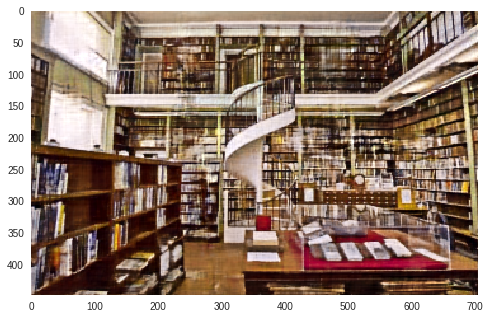

[1701, 159 s] loss: 0.008 
[1702, 159 s] loss: 0.008 
[1703, 159 s] loss: 0.008 
[1704, 159 s] loss: 0.008 
[1705, 160 s] loss: 0.008 
[1706, 160 s] loss: 0.008 
[1707, 160 s] loss: 0.008 
[1708, 160 s] loss: 0.008 
[1709, 160 s] loss: 0.008 
[1710, 160 s] loss: 0.008 
[1711, 160 s] loss: 0.008 
[1712, 160 s] loss: 0.008 
[1713, 160 s] loss: 0.008 
[1714, 160 s] loss: 0.008 
[1715, 160 s] loss: 0.008 
[1716, 160 s] loss: 0.008 
[1717, 161 s] loss: 0.008 
[1718, 161 s] loss: 0.008 
[1719, 161 s] loss: 0.008 
[1720, 161 s] loss: 0.008 
[1721, 161 s] loss: 0.008 
[1722, 161 s] loss: 0.008 
[1723, 161 s] loss: 0.008 
[1724, 161 s] loss: 0.008 
[1725, 161 s] loss: 0.008 
[1726, 161 s] loss: 0.008 
[1727, 161 s] loss: 0.008 
[1728, 161 s] loss: 0.008 
[1729, 161 s] loss: 0.008 
[1730, 162 s] loss: 0.008 
[1731, 162 s] loss: 0.008 
[1732, 162 s] loss: 0.008 
[1733, 162 s] loss: 0.008 
[1734, 162 s] loss: 0.008 
[1735, 162 s] loss: 0.008 
[1736, 162 s] loss: 0.008 
[1737, 162 s] loss: 0.008 
[

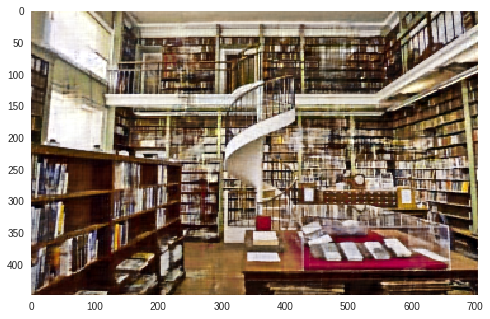

[1801, 169 s] loss: 0.008 
[1802, 169 s] loss: 0.008 
[1803, 169 s] loss: 0.008 
[1804, 169 s] loss: 0.008 
[1805, 169 s] loss: 0.008 
[1806, 169 s] loss: 0.008 
[1807, 169 s] loss: 0.008 
[1808, 169 s] loss: 0.008 
[1809, 169 s] loss: 0.008 
[1810, 169 s] loss: 0.008 
[1811, 169 s] loss: 0.008 
[1812, 169 s] loss: 0.008 
[1813, 169 s] loss: 0.008 
[1814, 170 s] loss: 0.008 
[1815, 170 s] loss: 0.008 
[1816, 170 s] loss: 0.008 
[1817, 170 s] loss: 0.008 
[1818, 170 s] loss: 0.008 
[1819, 170 s] loss: 0.008 
[1820, 170 s] loss: 0.008 
[1821, 170 s] loss: 0.008 
[1822, 170 s] loss: 0.008 
[1823, 170 s] loss: 0.008 
[1824, 170 s] loss: 0.008 
[1825, 170 s] loss: 0.008 
[1826, 171 s] loss: 0.008 
[1827, 171 s] loss: 0.008 
[1828, 171 s] loss: 0.008 
[1829, 171 s] loss: 0.008 
[1830, 171 s] loss: 0.008 
[1831, 171 s] loss: 0.008 
[1832, 171 s] loss: 0.008 
[1833, 171 s] loss: 0.008 
[1834, 171 s] loss: 0.008 
[1835, 171 s] loss: 0.008 
[1836, 171 s] loss: 0.008 
[1837, 171 s] loss: 0.008 
[

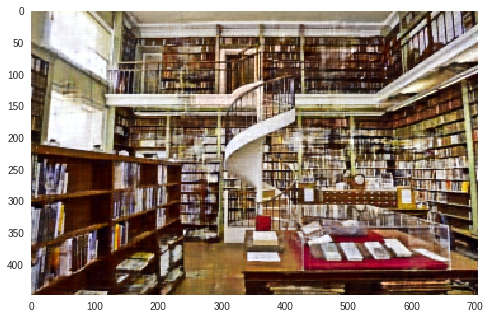

[1901, 178 s] loss: 0.008 
[1902, 178 s] loss: 0.008 
[1903, 178 s] loss: 0.008 
[1904, 178 s] loss: 0.008 
[1905, 178 s] loss: 0.008 
[1906, 178 s] loss: 0.008 
[1907, 178 s] loss: 0.008 
[1908, 178 s] loss: 0.008 
[1909, 179 s] loss: 0.008 
[1910, 179 s] loss: 0.008 
[1911, 179 s] loss: 0.008 
[1912, 179 s] loss: 0.008 
[1913, 179 s] loss: 0.008 
[1914, 179 s] loss: 0.008 
[1915, 179 s] loss: 0.008 
[1916, 179 s] loss: 0.008 
[1917, 179 s] loss: 0.008 
[1918, 179 s] loss: 0.008 
[1919, 179 s] loss: 0.008 
[1920, 179 s] loss: 0.008 
[1921, 179 s] loss: 0.008 
[1922, 180 s] loss: 0.008 
[1923, 180 s] loss: 0.008 
[1924, 180 s] loss: 0.008 
[1925, 180 s] loss: 0.008 
[1926, 180 s] loss: 0.008 
[1927, 180 s] loss: 0.008 
[1928, 180 s] loss: 0.008 
[1929, 180 s] loss: 0.008 
[1930, 180 s] loss: 0.008 
[1931, 180 s] loss: 0.008 
[1932, 180 s] loss: 0.008 
[1933, 180 s] loss: 0.008 
[1934, 181 s] loss: 0.008 
[1935, 181 s] loss: 0.008 
[1936, 181 s] loss: 0.008 
[1937, 181 s] loss: 0.008 
[

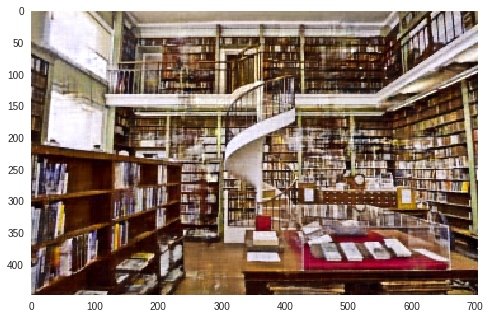

[2001, 187 s] loss: 0.008 
[2002, 187 s] loss: 0.008 
[2003, 187 s] loss: 0.008 
[2004, 187 s] loss: 0.008 
[2005, 187 s] loss: 0.008 
[2006, 188 s] loss: 0.008 
[2007, 188 s] loss: 0.008 
[2008, 188 s] loss: 0.008 
[2009, 188 s] loss: 0.008 
[2010, 188 s] loss: 0.008 
[2011, 188 s] loss: 0.008 
[2012, 188 s] loss: 0.008 
[2013, 188 s] loss: 0.008 
[2014, 188 s] loss: 0.008 
[2015, 188 s] loss: 0.008 
[2016, 188 s] loss: 0.008 
[2017, 188 s] loss: 0.008 
[2018, 189 s] loss: 0.008 
[2019, 189 s] loss: 0.008 
[2020, 189 s] loss: 0.008 
[2021, 189 s] loss: 0.008 
[2022, 189 s] loss: 0.008 
[2023, 189 s] loss: 0.008 
[2024, 189 s] loss: 0.008 
[2025, 189 s] loss: 0.008 
[2026, 189 s] loss: 0.008 
[2027, 189 s] loss: 0.008 
[2028, 189 s] loss: 0.008 
[2029, 189 s] loss: 0.008 
[2030, 189 s] loss: 0.008 
[2031, 190 s] loss: 0.008 
[2032, 190 s] loss: 0.008 
[2033, 190 s] loss: 0.008 
[2034, 190 s] loss: 0.008 
[2035, 190 s] loss: 0.008 
[2036, 190 s] loss: 0.008 
[2037, 190 s] loss: 0.008 
[

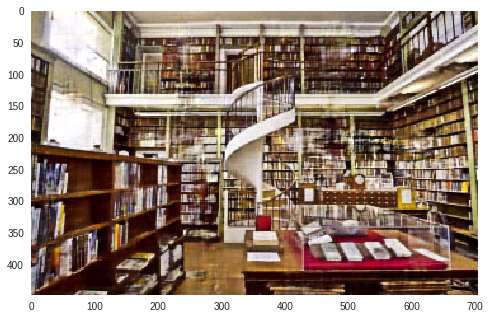

[2101, 197 s] loss: 0.008 
[2102, 197 s] loss: 0.008 
[2103, 197 s] loss: 0.008 
[2104, 197 s] loss: 0.008 
[2105, 197 s] loss: 0.008 
[2106, 197 s] loss: 0.008 
[2107, 197 s] loss: 0.008 
[2108, 197 s] loss: 0.008 
[2109, 197 s] loss: 0.008 
[2110, 197 s] loss: 0.008 
[2111, 197 s] loss: 0.008 
[2112, 197 s] loss: 0.008 
[2113, 197 s] loss: 0.008 
[2114, 198 s] loss: 0.008 
[2115, 198 s] loss: 0.008 
[2116, 198 s] loss: 0.008 
[2117, 198 s] loss: 0.008 
[2118, 198 s] loss: 0.008 
[2119, 198 s] loss: 0.008 
[2120, 198 s] loss: 0.008 
[2121, 198 s] loss: 0.008 
[2122, 198 s] loss: 0.008 
[2123, 198 s] loss: 0.008 
[2124, 198 s] loss: 0.008 
[2125, 198 s] loss: 0.008 
[2126, 198 s] loss: 0.008 
[2127, 199 s] loss: 0.008 
[2128, 199 s] loss: 0.008 
[2129, 199 s] loss: 0.008 
[2130, 199 s] loss: 0.008 
[2131, 199 s] loss: 0.008 
[2132, 199 s] loss: 0.008 
[2133, 199 s] loss: 0.008 
[2134, 199 s] loss: 0.008 
[2135, 199 s] loss: 0.008 
[2136, 199 s] loss: 0.008 
[2137, 199 s] loss: 0.008 
[

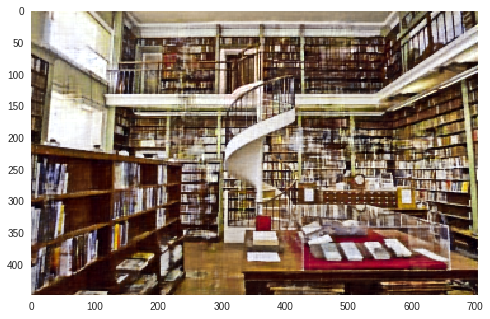

[2201, 206 s] loss: 0.008 
[2202, 206 s] loss: 0.008 
[2203, 206 s] loss: 0.008 
[2204, 206 s] loss: 0.008 
[2205, 206 s] loss: 0.008 
[2206, 206 s] loss: 0.008 
[2207, 206 s] loss: 0.008 
[2208, 206 s] loss: 0.008 
[2209, 206 s] loss: 0.008 
[2210, 207 s] loss: 0.008 
[2211, 207 s] loss: 0.008 
[2212, 207 s] loss: 0.008 
[2213, 207 s] loss: 0.008 
[2214, 207 s] loss: 0.008 
[2215, 207 s] loss: 0.008 
[2216, 207 s] loss: 0.008 
[2217, 207 s] loss: 0.008 
[2218, 207 s] loss: 0.008 
[2219, 207 s] loss: 0.008 
[2220, 207 s] loss: 0.008 
[2221, 207 s] loss: 0.008 
[2222, 208 s] loss: 0.008 
[2223, 208 s] loss: 0.008 
[2224, 208 s] loss: 0.008 
[2225, 208 s] loss: 0.008 
[2226, 208 s] loss: 0.008 
[2227, 208 s] loss: 0.008 
[2228, 208 s] loss: 0.008 
[2229, 208 s] loss: 0.008 
[2230, 208 s] loss: 0.008 
[2231, 208 s] loss: 0.008 
[2232, 208 s] loss: 0.008 
[2233, 208 s] loss: 0.008 
[2234, 208 s] loss: 0.008 
[2235, 209 s] loss: 0.008 
[2236, 209 s] loss: 0.008 
[2237, 209 s] loss: 0.008 
[

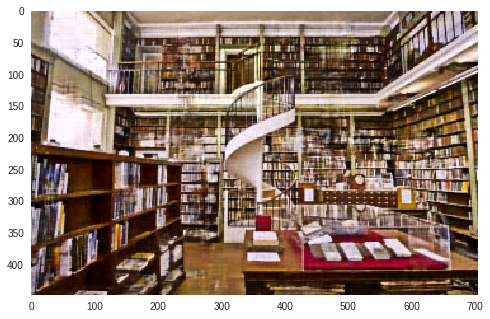

[2301, 215 s] loss: 0.008 
[2302, 215 s] loss: 0.008 
[2303, 215 s] loss: 0.008 
[2304, 215 s] loss: 0.008 
[2305, 215 s] loss: 0.008 
[2306, 216 s] loss: 0.008 
[2307, 216 s] loss: 0.008 
[2308, 216 s] loss: 0.008 
[2309, 216 s] loss: 0.008 
[2310, 216 s] loss: 0.008 
[2311, 216 s] loss: 0.008 
[2312, 216 s] loss: 0.008 
[2313, 216 s] loss: 0.008 
[2314, 216 s] loss: 0.008 
[2315, 216 s] loss: 0.008 
[2316, 216 s] loss: 0.008 
[2317, 216 s] loss: 0.008 
[2318, 216 s] loss: 0.008 
[2319, 217 s] loss: 0.008 
[2320, 217 s] loss: 0.008 
[2321, 217 s] loss: 0.008 
[2322, 217 s] loss: 0.008 
[2323, 217 s] loss: 0.008 
[2324, 217 s] loss: 0.008 
[2325, 217 s] loss: 0.008 
[2326, 217 s] loss: 0.008 
[2327, 217 s] loss: 0.008 
[2328, 217 s] loss: 0.008 
[2329, 217 s] loss: 0.008 
[2330, 217 s] loss: 0.008 
[2331, 218 s] loss: 0.008 
[2332, 218 s] loss: 0.008 
[2333, 218 s] loss: 0.008 
[2334, 218 s] loss: 0.008 
[2335, 218 s] loss: 0.008 
[2336, 218 s] loss: 0.008 
[2337, 218 s] loss: 0.008 
[

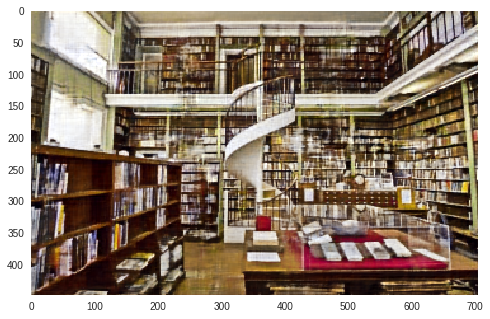

[2401, 224 s] loss: 0.008 
[2402, 224 s] loss: 0.008 
[2403, 224 s] loss: 0.008 
[2404, 225 s] loss: 0.008 
[2405, 225 s] loss: 0.008 
[2406, 225 s] loss: 0.008 
[2407, 225 s] loss: 0.008 
[2408, 225 s] loss: 0.008 
[2409, 225 s] loss: 0.008 
[2410, 225 s] loss: 0.008 
[2411, 225 s] loss: 0.008 
[2412, 225 s] loss: 0.008 
[2413, 225 s] loss: 0.008 
[2414, 225 s] loss: 0.008 
[2415, 225 s] loss: 0.008 
[2416, 226 s] loss: 0.008 
[2417, 226 s] loss: 0.008 
[2418, 226 s] loss: 0.008 
[2419, 226 s] loss: 0.008 
[2420, 226 s] loss: 0.008 
[2421, 226 s] loss: 0.008 
[2422, 226 s] loss: 0.008 
[2423, 226 s] loss: 0.008 
[2424, 226 s] loss: 0.008 
[2425, 226 s] loss: 0.008 
[2426, 226 s] loss: 0.008 
[2427, 226 s] loss: 0.008 
[2428, 226 s] loss: 0.008 
[2429, 227 s] loss: 0.008 
[2430, 227 s] loss: 0.008 
[2431, 227 s] loss: 0.008 
[2432, 227 s] loss: 0.008 
[2433, 227 s] loss: 0.008 
[2434, 227 s] loss: 0.008 
[2435, 227 s] loss: 0.008 
[2436, 227 s] loss: 0.008 
[2437, 227 s] loss: 0.008 
[

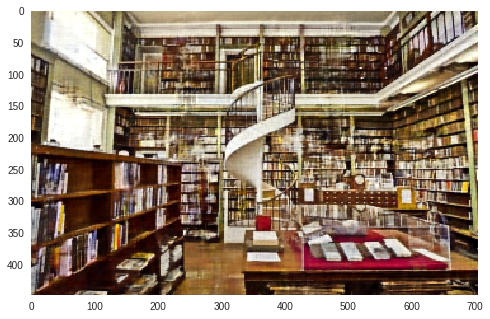

[2501, 234 s] loss: 0.008 
[2502, 234 s] loss: 0.008 
[2503, 234 s] loss: 0.008 
[2504, 234 s] loss: 0.008 
[2505, 234 s] loss: 0.008 
[2506, 234 s] loss: 0.008 
[2507, 234 s] loss: 0.008 
[2508, 234 s] loss: 0.008 
[2509, 234 s] loss: 0.008 
[2510, 234 s] loss: 0.008 
[2511, 234 s] loss: 0.008 
[2512, 235 s] loss: 0.008 
[2513, 235 s] loss: 0.008 
[2514, 235 s] loss: 0.008 
[2515, 235 s] loss: 0.008 
[2516, 235 s] loss: 0.008 
[2517, 235 s] loss: 0.008 
[2518, 235 s] loss: 0.008 
[2519, 235 s] loss: 0.008 
[2520, 235 s] loss: 0.008 
[2521, 235 s] loss: 0.008 
[2522, 235 s] loss: 0.008 
[2523, 235 s] loss: 0.008 
[2524, 236 s] loss: 0.008 
[2525, 236 s] loss: 0.008 
[2526, 236 s] loss: 0.008 
[2527, 236 s] loss: 0.008 
[2528, 236 s] loss: 0.008 
[2529, 236 s] loss: 0.008 
[2530, 236 s] loss: 0.008 
[2531, 236 s] loss: 0.008 
[2532, 236 s] loss: 0.008 
[2533, 236 s] loss: 0.008 
[2534, 236 s] loss: 0.008 
[2535, 236 s] loss: 0.008 
[2536, 236 s] loss: 0.008 
[2537, 237 s] loss: 0.008 
[

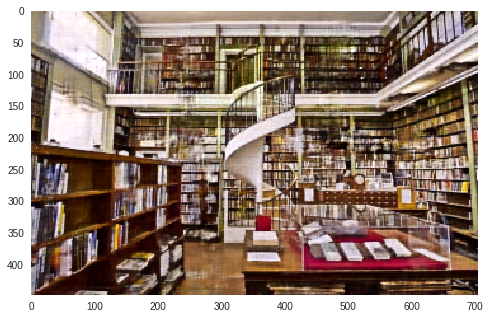

[2601, 243 s] loss: 0.008 
[2602, 243 s] loss: 0.008 
[2603, 243 s] loss: 0.008 
[2604, 243 s] loss: 0.008 
[2605, 243 s] loss: 0.008 
[2606, 243 s] loss: 0.008 
[2607, 243 s] loss: 0.008 
[2608, 243 s] loss: 0.008 
[2609, 243 s] loss: 0.008 
[2610, 244 s] loss: 0.008 
[2611, 244 s] loss: 0.008 
[2612, 244 s] loss: 0.008 
[2613, 244 s] loss: 0.008 
[2614, 244 s] loss: 0.008 
[2615, 244 s] loss: 0.008 
[2616, 244 s] loss: 0.008 
[2617, 244 s] loss: 0.008 
[2618, 244 s] loss: 0.008 
[2619, 244 s] loss: 0.008 
[2620, 244 s] loss: 0.008 
[2621, 244 s] loss: 0.008 
[2622, 245 s] loss: 0.008 
[2623, 245 s] loss: 0.008 
[2624, 245 s] loss: 0.008 
[2625, 245 s] loss: 0.008 
[2626, 245 s] loss: 0.008 
[2627, 245 s] loss: 0.008 
[2628, 245 s] loss: 0.008 
[2629, 245 s] loss: 0.008 
[2630, 245 s] loss: 0.008 
[2631, 245 s] loss: 0.008 
[2632, 245 s] loss: 0.008 
[2633, 245 s] loss: 0.008 
[2634, 245 s] loss: 0.008 
[2635, 246 s] loss: 0.008 
[2636, 246 s] loss: 0.008 
[2637, 246 s] loss: 0.008 
[

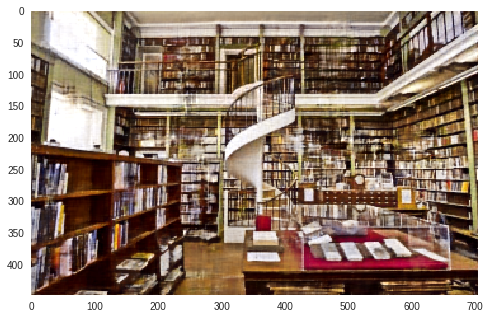

[2701, 252 s] loss: 0.008 
[2702, 252 s] loss: 0.008 
[2703, 252 s] loss: 0.008 
[2704, 253 s] loss: 0.008 
[2705, 253 s] loss: 0.008 
[2706, 253 s] loss: 0.008 
[2707, 253 s] loss: 0.008 
[2708, 253 s] loss: 0.008 
[2709, 253 s] loss: 0.008 
[2710, 253 s] loss: 0.008 
[2711, 253 s] loss: 0.008 
[2712, 253 s] loss: 0.008 
[2713, 253 s] loss: 0.008 
[2714, 253 s] loss: 0.008 
[2715, 253 s] loss: 0.008 
[2716, 254 s] loss: 0.008 
[2717, 254 s] loss: 0.008 
[2718, 254 s] loss: 0.008 
[2719, 254 s] loss: 0.008 
[2720, 254 s] loss: 0.008 
[2721, 254 s] loss: 0.008 
[2722, 254 s] loss: 0.008 
[2723, 254 s] loss: 0.008 
[2724, 254 s] loss: 0.008 
[2725, 254 s] loss: 0.008 
[2726, 254 s] loss: 0.008 
[2727, 254 s] loss: 0.008 
[2728, 254 s] loss: 0.008 
[2729, 255 s] loss: 0.008 
[2730, 255 s] loss: 0.008 
[2731, 255 s] loss: 0.008 
[2732, 255 s] loss: 0.008 
[2733, 255 s] loss: 0.008 
[2734, 255 s] loss: 0.008 
[2735, 255 s] loss: 0.008 
[2736, 255 s] loss: 0.008 
[2737, 255 s] loss: 0.008 
[

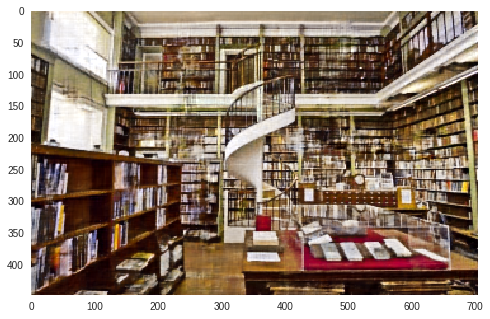

[2801, 262 s] loss: 0.008 
[2802, 262 s] loss: 0.008 
[2803, 262 s] loss: 0.008 
[2804, 262 s] loss: 0.008 
[2805, 263 s] loss: 0.008 
[2806, 263 s] loss: 0.008 
[2807, 263 s] loss: 0.008 
[2808, 263 s] loss: 0.008 
[2809, 263 s] loss: 0.008 
[2810, 263 s] loss: 0.008 
[2811, 263 s] loss: 0.008 
[2812, 263 s] loss: 0.008 
[2813, 263 s] loss: 0.008 
[2814, 263 s] loss: 0.008 
[2815, 263 s] loss: 0.008 
[2816, 263 s] loss: 0.008 
[2817, 264 s] loss: 0.008 
[2818, 264 s] loss: 0.008 
[2819, 264 s] loss: 0.008 
[2820, 264 s] loss: 0.008 
[2821, 264 s] loss: 0.008 
[2822, 264 s] loss: 0.008 
[2823, 264 s] loss: 0.008 
[2824, 264 s] loss: 0.008 
[2825, 264 s] loss: 0.008 
[2826, 264 s] loss: 0.008 
[2827, 264 s] loss: 0.008 
[2828, 264 s] loss: 0.008 
[2829, 264 s] loss: 0.008 
[2830, 265 s] loss: 0.008 
[2831, 265 s] loss: 0.008 
[2832, 265 s] loss: 0.008 
[2833, 265 s] loss: 0.008 
[2834, 265 s] loss: 0.008 
[2835, 265 s] loss: 0.008 
[2836, 265 s] loss: 0.008 
[2837, 265 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331.7K of output have been discarded. 

[2901, 272 s] loss: 0.008 
[2902, 272 s] loss: 0.008 
[2903, 272 s] loss: 0.008 
[2904, 272 s] loss: 0.008 
[2905, 272 s] loss: 0.008 
[2906, 272 s] loss: 0.008 
[2907, 272 s] loss: 0.008 
[2908, 272 s] loss: 0.008 
[2909, 272 s] loss: 0.008 
[2910, 272 s] loss: 0.008 
[2911, 272 s] loss: 0.008 
[2912, 273 s] loss: 0.008 
[2913, 273 s] loss: 0.008 
[2914, 273 s] loss: 0.008 
[2915, 273 s] loss: 0.008 
[2916, 273 s] loss: 0.008 
[2917, 273 s] loss: 0.008 
[2918, 273 s] loss: 0.008 
[2919, 273 s] loss: 0.008 
[2920, 273 s] loss: 0.008 
[2921, 273 s] loss: 0.008 
[2922, 273 s] loss: 0.008 
[2923, 273 s] loss: 0.008 
[2924, 273 s] loss: 0.008 
[2925, 274 s] loss: 0.008 
[2926, 274 s] loss: 0.008 
[2927, 274 s] loss: 0.008 
[2928, 274 s] loss: 0.008 
[2929, 274 s] loss: 0.008 
[2930, 274 s] loss: 0.008 
[2931, 274 s] loss: 0.008 
[2932, 274 s] loss: 0.008 
[2933, 274 s] loss: 0.008 
[2934, 274 s] loss: 0.008 
[2935, 274 s] loss: 0.008 
[2936, 274 s] loss: 0.008 
[2937, 275 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 329.4K of output have been discarded. 

[3001, 281 s] loss: 0.008 
[3002, 281 s] loss: 0.008 
[3003, 281 s] loss: 0.008 
[3004, 281 s] loss: 0.008 
[3005, 281 s] loss: 0.008 
[3006, 281 s] loss: 0.008 
[3007, 281 s] loss: 0.008 
[3008, 282 s] loss: 0.008 
[3009, 282 s] loss: 0.008 
[3010, 282 s] loss: 0.008 
[3011, 282 s] loss: 0.008 
[3012, 282 s] loss: 0.008 
[3013, 282 s] loss: 0.008 
[3014, 282 s] loss: 0.008 
[3015, 282 s] loss: 0.008 
[3016, 282 s] loss: 0.008 
[3017, 282 s] loss: 0.008 
[3018, 282 s] loss: 0.008 
[3019, 282 s] loss: 0.008 
[3020, 282 s] loss: 0.008 
[3021, 283 s] loss: 0.008 
[3022, 283 s] loss: 0.008 
[3023, 283 s] loss: 0.008 
[3024, 283 s] loss: 0.008 
[3025, 283 s] loss: 0.008 
[3026, 283 s] loss: 0.008 
[3027, 283 s] loss: 0.008 
[3028, 283 s] loss: 0.008 
[3029, 283 s] loss: 0.008 
[3030, 283 s] loss: 0.008 
[3031, 283 s] loss: 0.008 
[3032, 283 s] loss: 0.008 
[3033, 284 s] loss: 0.008 
[3034, 284 s] loss: 0.008 
[3035, 284 s] loss: 0.008 
[3036, 284 s] loss: 0.008 
[3037, 284 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331.5K of output have been discarded. 

[3101, 290 s] loss: 0.008 
[3102, 290 s] loss: 0.008 
[3103, 290 s] loss: 0.008 
[3104, 291 s] loss: 0.008 
[3105, 291 s] loss: 0.008 
[3106, 291 s] loss: 0.008 
[3107, 291 s] loss: 0.008 
[3108, 291 s] loss: 0.008 
[3109, 291 s] loss: 0.008 
[3110, 291 s] loss: 0.008 
[3111, 291 s] loss: 0.008 
[3112, 291 s] loss: 0.008 
[3113, 291 s] loss: 0.008 
[3114, 291 s] loss: 0.008 
[3115, 291 s] loss: 0.008 
[3116, 291 s] loss: 0.008 
[3117, 292 s] loss: 0.008 
[3118, 292 s] loss: 0.008 
[3119, 292 s] loss: 0.008 
[3120, 292 s] loss: 0.008 
[3121, 292 s] loss: 0.008 
[3122, 292 s] loss: 0.008 
[3123, 292 s] loss: 0.008 
[3124, 292 s] loss: 0.008 
[3125, 292 s] loss: 0.008 
[3126, 292 s] loss: 0.008 
[3127, 292 s] loss: 0.008 
[3128, 292 s] loss: 0.008 
[3129, 293 s] loss: 0.008 
[3130, 293 s] loss: 0.008 
[3131, 293 s] loss: 0.008 
[3132, 293 s] loss: 0.008 
[3133, 293 s] loss: 0.008 
[3134, 293 s] loss: 0.008 
[3135, 293 s] loss: 0.008 
[3136, 293 s] loss: 0.008 
[3137, 293 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331K of output have been discarded. 

[3201, 300 s] loss: 0.008 
[3202, 300 s] loss: 0.008 
[3203, 300 s] loss: 0.008 
[3204, 300 s] loss: 0.008 
[3205, 300 s] loss: 0.008 
[3206, 300 s] loss: 0.008 
[3207, 300 s] loss: 0.008 
[3208, 300 s] loss: 0.008 
[3209, 300 s] loss: 0.008 
[3210, 300 s] loss: 0.008 
[3211, 300 s] loss: 0.008 
[3212, 300 s] loss: 0.008 
[3213, 301 s] loss: 0.008 
[3214, 301 s] loss: 0.008 
[3215, 301 s] loss: 0.008 
[3216, 301 s] loss: 0.008 
[3217, 301 s] loss: 0.008 
[3218, 301 s] loss: 0.008 
[3219, 301 s] loss: 0.008 
[3220, 301 s] loss: 0.008 
[3221, 301 s] loss: 0.008 
[3222, 301 s] loss: 0.008 
[3223, 301 s] loss: 0.008 
[3224, 301 s] loss: 0.008 
[3225, 301 s] loss: 0.008 
[3226, 302 s] loss: 0.008 
[3227, 302 s] loss: 0.008 
[3228, 302 s] loss: 0.008 
[3229, 302 s] loss: 0.008 
[3230, 302 s] loss: 0.008 
[3231, 302 s] loss: 0.008 
[3232, 302 s] loss: 0.008 
[3233, 302 s] loss: 0.008 
[3234, 302 s] loss: 0.008 
[3235, 302 s] loss: 0.008 
[3236, 302 s] loss: 0.008 
[3237, 302 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 330.8K of output have been discarded. 

[3301, 309 s] loss: 0.008 
[3302, 309 s] loss: 0.008 
[3303, 309 s] loss: 0.008 
[3304, 309 s] loss: 0.008 
[3305, 309 s] loss: 0.008 
[3306, 309 s] loss: 0.008 
[3307, 309 s] loss: 0.008 
[3308, 310 s] loss: 0.008 
[3309, 310 s] loss: 0.008 
[3310, 310 s] loss: 0.008 
[3311, 310 s] loss: 0.008 
[3312, 310 s] loss: 0.008 
[3313, 310 s] loss: 0.008 
[3314, 310 s] loss: 0.008 
[3315, 310 s] loss: 0.008 
[3316, 310 s] loss: 0.008 
[3317, 310 s] loss: 0.008 
[3318, 310 s] loss: 0.008 
[3319, 310 s] loss: 0.008 
[3320, 311 s] loss: 0.008 
[3321, 311 s] loss: 0.008 
[3322, 311 s] loss: 0.008 
[3323, 311 s] loss: 0.008 
[3324, 311 s] loss: 0.008 
[3325, 311 s] loss: 0.008 
[3326, 311 s] loss: 0.008 
[3327, 311 s] loss: 0.008 
[3328, 311 s] loss: 0.008 
[3329, 311 s] loss: 0.008 
[3330, 311 s] loss: 0.008 
[3331, 311 s] loss: 0.008 
[3332, 311 s] loss: 0.008 
[3333, 312 s] loss: 0.008 
[3334, 312 s] loss: 0.008 
[3335, 312 s] loss: 0.008 
[3336, 312 s] loss: 0.008 
[3337, 312 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 330.1K of output have been discarded. 

[3401, 318 s] loss: 0.008 
[3402, 318 s] loss: 0.008 
[3403, 318 s] loss: 0.008 
[3404, 318 s] loss: 0.008 
[3405, 319 s] loss: 0.008 
[3406, 319 s] loss: 0.008 
[3407, 319 s] loss: 0.008 
[3408, 319 s] loss: 0.008 
[3409, 319 s] loss: 0.008 
[3410, 319 s] loss: 0.008 
[3411, 319 s] loss: 0.008 
[3412, 319 s] loss: 0.008 
[3413, 319 s] loss: 0.008 
[3414, 319 s] loss: 0.008 
[3415, 319 s] loss: 0.008 
[3416, 319 s] loss: 0.008 
[3417, 319 s] loss: 0.008 
[3418, 320 s] loss: 0.008 
[3419, 320 s] loss: 0.008 
[3420, 320 s] loss: 0.008 
[3421, 320 s] loss: 0.008 
[3422, 320 s] loss: 0.008 
[3423, 320 s] loss: 0.008 
[3424, 320 s] loss: 0.008 
[3425, 320 s] loss: 0.008 
[3426, 320 s] loss: 0.008 
[3427, 320 s] loss: 0.008 
[3428, 320 s] loss: 0.008 
[3429, 320 s] loss: 0.008 
[3430, 321 s] loss: 0.008 
[3431, 321 s] loss: 0.008 
[3432, 321 s] loss: 0.008 
[3433, 321 s] loss: 0.008 
[3434, 321 s] loss: 0.008 
[3435, 321 s] loss: 0.008 
[3436, 321 s] loss: 0.008 
[3437, 321 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332.3K of output have been discarded. 

[3501, 327 s] loss: 0.008 
[3502, 328 s] loss: 0.008 
[3503, 328 s] loss: 0.008 
[3504, 328 s] loss: 0.008 
[3505, 328 s] loss: 0.008 
[3506, 328 s] loss: 0.008 
[3507, 328 s] loss: 0.008 
[3508, 328 s] loss: 0.008 
[3509, 328 s] loss: 0.008 
[3510, 328 s] loss: 0.008 
[3511, 328 s] loss: 0.008 
[3512, 328 s] loss: 0.008 
[3513, 328 s] loss: 0.008 
[3514, 329 s] loss: 0.008 
[3515, 329 s] loss: 0.008 
[3516, 329 s] loss: 0.008 
[3517, 329 s] loss: 0.008 
[3518, 329 s] loss: 0.008 
[3519, 329 s] loss: 0.008 
[3520, 329 s] loss: 0.008 
[3521, 329 s] loss: 0.008 
[3522, 329 s] loss: 0.008 
[3523, 329 s] loss: 0.008 
[3524, 329 s] loss: 0.008 
[3525, 329 s] loss: 0.008 
[3526, 329 s] loss: 0.008 
[3527, 330 s] loss: 0.008 
[3528, 330 s] loss: 0.008 
[3529, 330 s] loss: 0.008 
[3530, 330 s] loss: 0.008 
[3531, 330 s] loss: 0.008 
[3532, 330 s] loss: 0.008 
[3533, 330 s] loss: 0.008 
[3534, 330 s] loss: 0.008 
[3535, 330 s] loss: 0.008 
[3536, 330 s] loss: 0.008 
[3537, 330 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 333.3K of output have been discarded. 

[3601, 337 s] loss: 0.008 
[3602, 337 s] loss: 0.008 
[3603, 337 s] loss: 0.008 
[3604, 337 s] loss: 0.008 
[3605, 337 s] loss: 0.008 
[3606, 337 s] loss: 0.008 
[3607, 337 s] loss: 0.008 
[3608, 337 s] loss: 0.008 
[3609, 338 s] loss: 0.008 
[3610, 338 s] loss: 0.008 
[3611, 338 s] loss: 0.008 
[3612, 338 s] loss: 0.008 
[3613, 338 s] loss: 0.008 
[3614, 338 s] loss: 0.008 
[3615, 338 s] loss: 0.008 
[3616, 338 s] loss: 0.008 
[3617, 338 s] loss: 0.008 
[3618, 338 s] loss: 0.008 
[3619, 338 s] loss: 0.008 
[3620, 338 s] loss: 0.008 
[3621, 338 s] loss: 0.008 
[3622, 339 s] loss: 0.008 
[3623, 339 s] loss: 0.008 
[3624, 339 s] loss: 0.008 
[3625, 339 s] loss: 0.008 
[3626, 339 s] loss: 0.008 
[3627, 339 s] loss: 0.008 
[3628, 339 s] loss: 0.008 
[3629, 339 s] loss: 0.008 
[3630, 339 s] loss: 0.008 
[3631, 339 s] loss: 0.008 
[3632, 339 s] loss: 0.008 
[3633, 339 s] loss: 0.008 
[3634, 340 s] loss: 0.008 
[3635, 340 s] loss: 0.008 
[3636, 340 s] loss: 0.008 
[3637, 340 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 329.9K of output have been discarded. 

[3701, 346 s] loss: 0.008 
[3702, 346 s] loss: 0.008 
[3703, 346 s] loss: 0.008 
[3704, 346 s] loss: 0.008 
[3705, 346 s] loss: 0.008 
[3706, 346 s] loss: 0.008 
[3707, 347 s] loss: 0.008 
[3708, 347 s] loss: 0.008 
[3709, 347 s] loss: 0.008 
[3710, 347 s] loss: 0.008 
[3711, 347 s] loss: 0.008 
[3712, 347 s] loss: 0.008 
[3713, 347 s] loss: 0.008 
[3714, 347 s] loss: 0.008 
[3715, 347 s] loss: 0.008 
[3716, 347 s] loss: 0.008 
[3717, 347 s] loss: 0.008 
[3718, 347 s] loss: 0.008 
[3719, 347 s] loss: 0.008 
[3720, 348 s] loss: 0.008 
[3721, 348 s] loss: 0.008 
[3722, 348 s] loss: 0.008 
[3723, 348 s] loss: 0.008 
[3724, 348 s] loss: 0.008 
[3725, 348 s] loss: 0.008 
[3726, 348 s] loss: 0.008 
[3727, 348 s] loss: 0.008 
[3728, 348 s] loss: 0.008 
[3729, 348 s] loss: 0.008 
[3730, 348 s] loss: 0.008 
[3731, 348 s] loss: 0.008 
[3732, 349 s] loss: 0.008 
[3733, 349 s] loss: 0.008 
[3734, 349 s] loss: 0.008 
[3735, 349 s] loss: 0.008 
[3736, 349 s] loss: 0.008 
[3737, 349 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331.4K of output have been discarded. 

[3801, 355 s] loss: 0.008 
[3802, 355 s] loss: 0.008 
[3803, 356 s] loss: 0.008 
[3804, 356 s] loss: 0.008 
[3805, 356 s] loss: 0.008 
[3806, 356 s] loss: 0.008 
[3807, 356 s] loss: 0.008 
[3808, 356 s] loss: 0.008 
[3809, 356 s] loss: 0.008 
[3810, 356 s] loss: 0.008 
[3811, 356 s] loss: 0.008 
[3812, 356 s] loss: 0.008 
[3813, 356 s] loss: 0.008 
[3814, 356 s] loss: 0.008 
[3815, 356 s] loss: 0.008 
[3816, 357 s] loss: 0.008 
[3817, 357 s] loss: 0.008 
[3818, 357 s] loss: 0.008 
[3819, 357 s] loss: 0.008 
[3820, 357 s] loss: 0.008 
[3821, 357 s] loss: 0.008 
[3822, 357 s] loss: 0.008 
[3823, 357 s] loss: 0.008 
[3824, 357 s] loss: 0.008 
[3825, 357 s] loss: 0.008 
[3826, 357 s] loss: 0.008 
[3827, 357 s] loss: 0.008 
[3828, 358 s] loss: 0.008 
[3829, 358 s] loss: 0.008 
[3830, 358 s] loss: 0.008 
[3831, 358 s] loss: 0.008 
[3832, 358 s] loss: 0.008 
[3833, 358 s] loss: 0.008 
[3834, 358 s] loss: 0.008 
[3835, 358 s] loss: 0.008 
[3836, 358 s] loss: 0.008 
[3837, 358 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331.5K of output have been discarded. 

[3901, 365 s] loss: 0.008 
[3902, 365 s] loss: 0.008 
[3903, 365 s] loss: 0.008 
[3904, 365 s] loss: 0.008 
[3905, 365 s] loss: 0.008 
[3906, 365 s] loss: 0.008 
[3907, 365 s] loss: 0.008 
[3908, 365 s] loss: 0.008 
[3909, 365 s] loss: 0.008 
[3910, 365 s] loss: 0.008 
[3911, 365 s] loss: 0.008 
[3912, 366 s] loss: 0.008 
[3913, 366 s] loss: 0.008 
[3914, 366 s] loss: 0.008 
[3915, 366 s] loss: 0.008 
[3916, 366 s] loss: 0.008 
[3917, 366 s] loss: 0.008 
[3918, 366 s] loss: 0.008 
[3919, 366 s] loss: 0.008 
[3920, 366 s] loss: 0.008 
[3921, 366 s] loss: 0.008 
[3922, 366 s] loss: 0.008 
[3923, 366 s] loss: 0.008 
[3924, 366 s] loss: 0.008 
[3925, 367 s] loss: 0.008 
[3926, 367 s] loss: 0.008 
[3927, 367 s] loss: 0.008 
[3928, 367 s] loss: 0.008 
[3929, 367 s] loss: 0.008 
[3930, 367 s] loss: 0.008 
[3931, 367 s] loss: 0.008 
[3932, 367 s] loss: 0.008 
[3933, 367 s] loss: 0.008 
[3934, 367 s] loss: 0.008 
[3935, 367 s] loss: 0.008 
[3936, 367 s] loss: 0.008 
[3937, 368 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331.3K of output have been discarded. 

[4001, 374 s] loss: 0.008 
[4002, 374 s] loss: 0.008 
[4003, 374 s] loss: 0.008 
[4004, 374 s] loss: 0.008 
[4005, 374 s] loss: 0.008 
[4006, 374 s] loss: 0.008 
[4007, 374 s] loss: 0.008 
[4008, 375 s] loss: 0.008 
[4009, 375 s] loss: 0.008 
[4010, 375 s] loss: 0.008 
[4011, 375 s] loss: 0.008 
[4012, 375 s] loss: 0.008 
[4013, 375 s] loss: 0.008 
[4014, 375 s] loss: 0.008 
[4015, 375 s] loss: 0.008 
[4016, 375 s] loss: 0.008 
[4017, 375 s] loss: 0.008 
[4018, 375 s] loss: 0.008 
[4019, 375 s] loss: 0.008 
[4020, 375 s] loss: 0.008 
[4021, 376 s] loss: 0.008 
[4022, 376 s] loss: 0.008 
[4023, 376 s] loss: 0.008 
[4024, 376 s] loss: 0.008 
[4025, 376 s] loss: 0.008 
[4026, 376 s] loss: 0.008 
[4027, 376 s] loss: 0.008 
[4028, 376 s] loss: 0.008 
[4029, 376 s] loss: 0.008 
[4030, 376 s] loss: 0.008 
[4031, 376 s] loss: 0.008 
[4032, 376 s] loss: 0.008 
[4033, 377 s] loss: 0.008 
[4034, 377 s] loss: 0.008 
[4035, 377 s] loss: 0.008 
[4036, 377 s] loss: 0.008 
[4037, 377 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332.8K of output have been discarded. 

[4101, 383 s] loss: 0.008 
[4102, 384 s] loss: 0.008 
[4103, 384 s] loss: 0.008 
[4104, 384 s] loss: 0.008 
[4105, 384 s] loss: 0.008 
[4106, 384 s] loss: 0.008 
[4107, 384 s] loss: 0.008 
[4108, 384 s] loss: 0.008 
[4109, 384 s] loss: 0.008 
[4110, 384 s] loss: 0.008 
[4111, 384 s] loss: 0.008 
[4112, 384 s] loss: 0.008 
[4113, 384 s] loss: 0.008 
[4114, 385 s] loss: 0.008 
[4115, 385 s] loss: 0.008 
[4116, 385 s] loss: 0.008 
[4117, 385 s] loss: 0.008 
[4118, 385 s] loss: 0.008 
[4119, 385 s] loss: 0.008 
[4120, 385 s] loss: 0.008 
[4121, 385 s] loss: 0.008 
[4122, 385 s] loss: 0.008 
[4123, 385 s] loss: 0.008 
[4124, 385 s] loss: 0.008 
[4125, 385 s] loss: 0.008 
[4126, 385 s] loss: 0.008 
[4127, 386 s] loss: 0.008 
[4128, 386 s] loss: 0.008 
[4129, 386 s] loss: 0.008 
[4130, 386 s] loss: 0.008 
[4131, 386 s] loss: 0.008 
[4132, 386 s] loss: 0.008 
[4133, 386 s] loss: 0.008 
[4134, 386 s] loss: 0.008 
[4135, 386 s] loss: 0.008 
[4136, 386 s] loss: 0.008 
[4137, 386 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 330.7K of output have been discarded. 

[4201, 393 s] loss: 0.008 
[4202, 393 s] loss: 0.008 
[4203, 393 s] loss: 0.008 
[4204, 393 s] loss: 0.008 
[4205, 393 s] loss: 0.008 
[4206, 393 s] loss: 0.008 
[4207, 393 s] loss: 0.008 
[4208, 393 s] loss: 0.008 
[4209, 393 s] loss: 0.008 
[4210, 393 s] loss: 0.008 
[4211, 394 s] loss: 0.008 
[4212, 394 s] loss: 0.008 
[4213, 394 s] loss: 0.008 
[4214, 394 s] loss: 0.008 
[4215, 394 s] loss: 0.008 
[4216, 394 s] loss: 0.008 
[4217, 394 s] loss: 0.008 
[4218, 394 s] loss: 0.008 
[4219, 394 s] loss: 0.008 
[4220, 394 s] loss: 0.008 
[4221, 394 s] loss: 0.008 
[4222, 394 s] loss: 0.008 
[4223, 395 s] loss: 0.008 
[4224, 395 s] loss: 0.008 
[4225, 395 s] loss: 0.008 
[4226, 395 s] loss: 0.008 
[4227, 395 s] loss: 0.008 
[4228, 395 s] loss: 0.008 
[4229, 395 s] loss: 0.008 
[4230, 395 s] loss: 0.008 
[4231, 395 s] loss: 0.008 
[4232, 395 s] loss: 0.008 
[4233, 395 s] loss: 0.008 
[4234, 395 s] loss: 0.008 
[4235, 395 s] loss: 0.008 
[4236, 396 s] loss: 0.008 
[4237, 396 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332.6K of output have been discarded. 

[4301, 402 s] loss: 0.008 
[4302, 402 s] loss: 0.008 
[4303, 402 s] loss: 0.008 
[4304, 402 s] loss: 0.008 
[4305, 402 s] loss: 0.008 
[4306, 402 s] loss: 0.008 
[4307, 402 s] loss: 0.008 
[4308, 403 s] loss: 0.008 
[4309, 403 s] loss: 0.008 
[4310, 403 s] loss: 0.008 
[4311, 403 s] loss: 0.008 
[4312, 403 s] loss: 0.008 
[4313, 403 s] loss: 0.008 
[4314, 403 s] loss: 0.008 
[4315, 403 s] loss: 0.008 
[4316, 403 s] loss: 0.008 
[4317, 403 s] loss: 0.008 
[4318, 403 s] loss: 0.008 
[4319, 403 s] loss: 0.008 
[4320, 403 s] loss: 0.008 
[4321, 404 s] loss: 0.008 
[4322, 404 s] loss: 0.008 
[4323, 404 s] loss: 0.008 
[4324, 404 s] loss: 0.008 
[4325, 404 s] loss: 0.008 
[4326, 404 s] loss: 0.008 
[4327, 404 s] loss: 0.008 
[4328, 404 s] loss: 0.008 
[4329, 404 s] loss: 0.008 
[4330, 404 s] loss: 0.008 
[4331, 404 s] loss: 0.008 
[4332, 404 s] loss: 0.008 
[4333, 405 s] loss: 0.008 
[4334, 405 s] loss: 0.008 
[4335, 405 s] loss: 0.008 
[4336, 405 s] loss: 0.008 
[4337, 405 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332.4K of output have been discarded. 

[4401, 411 s] loss: 0.008 
[4402, 411 s] loss: 0.008 
[4403, 411 s] loss: 0.008 
[4404, 412 s] loss: 0.008 
[4405, 412 s] loss: 0.008 
[4406, 412 s] loss: 0.008 
[4407, 412 s] loss: 0.008 
[4408, 412 s] loss: 0.008 
[4409, 412 s] loss: 0.008 
[4410, 412 s] loss: 0.008 
[4411, 412 s] loss: 0.008 
[4412, 412 s] loss: 0.008 
[4413, 412 s] loss: 0.008 
[4414, 412 s] loss: 0.008 
[4415, 412 s] loss: 0.008 
[4416, 412 s] loss: 0.008 
[4417, 413 s] loss: 0.008 
[4418, 413 s] loss: 0.008 
[4419, 413 s] loss: 0.008 
[4420, 413 s] loss: 0.008 
[4421, 413 s] loss: 0.008 
[4422, 413 s] loss: 0.008 
[4423, 413 s] loss: 0.008 
[4424, 413 s] loss: 0.008 
[4425, 413 s] loss: 0.008 
[4426, 413 s] loss: 0.008 
[4427, 413 s] loss: 0.008 
[4428, 413 s] loss: 0.008 
[4429, 413 s] loss: 0.008 
[4430, 414 s] loss: 0.008 
[4431, 414 s] loss: 0.008 
[4432, 414 s] loss: 0.008 
[4433, 414 s] loss: 0.008 
[4434, 414 s] loss: 0.008 
[4435, 414 s] loss: 0.008 
[4436, 414 s] loss: 0.008 
[4437, 414 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332.6K of output have been discarded. 

[4501, 420 s] loss: 0.008 
[4502, 421 s] loss: 0.008 
[4503, 421 s] loss: 0.008 
[4504, 421 s] loss: 0.008 
[4505, 421 s] loss: 0.008 
[4506, 421 s] loss: 0.008 
[4507, 421 s] loss: 0.008 
[4508, 421 s] loss: 0.008 
[4509, 421 s] loss: 0.008 
[4510, 421 s] loss: 0.008 
[4511, 421 s] loss: 0.008 
[4512, 421 s] loss: 0.008 
[4513, 421 s] loss: 0.008 
[4514, 421 s] loss: 0.008 
[4515, 422 s] loss: 0.008 
[4516, 422 s] loss: 0.008 
[4517, 422 s] loss: 0.008 
[4518, 422 s] loss: 0.008 
[4519, 422 s] loss: 0.008 
[4520, 422 s] loss: 0.008 
[4521, 422 s] loss: 0.008 
[4522, 422 s] loss: 0.008 
[4523, 422 s] loss: 0.008 
[4524, 422 s] loss: 0.008 
[4525, 422 s] loss: 0.008 
[4526, 422 s] loss: 0.008 
[4527, 423 s] loss: 0.008 
[4528, 423 s] loss: 0.008 
[4529, 423 s] loss: 0.008 
[4530, 423 s] loss: 0.008 
[4531, 423 s] loss: 0.008 
[4532, 423 s] loss: 0.008 
[4533, 423 s] loss: 0.008 
[4534, 423 s] loss: 0.008 
[4535, 423 s] loss: 0.008 
[4536, 423 s] loss: 0.008 
[4537, 423 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332K of output have been discarded. 

[4601, 430 s] loss: 0.008 
[4602, 430 s] loss: 0.008 
[4603, 430 s] loss: 0.008 
[4604, 430 s] loss: 0.008 
[4605, 430 s] loss: 0.008 
[4606, 430 s] loss: 0.008 
[4607, 430 s] loss: 0.008 
[4608, 430 s] loss: 0.008 
[4609, 430 s] loss: 0.008 
[4610, 430 s] loss: 0.008 
[4611, 430 s] loss: 0.008 
[4612, 431 s] loss: 0.008 
[4613, 431 s] loss: 0.008 
[4614, 431 s] loss: 0.008 
[4615, 431 s] loss: 0.008 
[4616, 431 s] loss: 0.008 
[4617, 431 s] loss: 0.008 
[4618, 431 s] loss: 0.008 
[4619, 431 s] loss: 0.008 
[4620, 431 s] loss: 0.008 
[4621, 431 s] loss: 0.008 
[4622, 431 s] loss: 0.008 
[4623, 431 s] loss: 0.008 
[4624, 431 s] loss: 0.008 
[4625, 432 s] loss: 0.008 
[4626, 432 s] loss: 0.008 
[4627, 432 s] loss: 0.008 
[4628, 432 s] loss: 0.008 
[4629, 432 s] loss: 0.008 
[4630, 432 s] loss: 0.008 
[4631, 432 s] loss: 0.008 
[4632, 432 s] loss: 0.008 
[4633, 432 s] loss: 0.008 
[4634, 432 s] loss: 0.008 
[4635, 432 s] loss: 0.008 
[4636, 432 s] loss: 0.008 
[4637, 433 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332.1K of output have been discarded. 

[4701, 439 s] loss: 0.008 
[4702, 439 s] loss: 0.008 
[4703, 439 s] loss: 0.008 
[4704, 439 s] loss: 0.008 
[4705, 439 s] loss: 0.008 
[4706, 439 s] loss: 0.008 
[4707, 439 s] loss: 0.008 
[4708, 440 s] loss: 0.008 
[4709, 440 s] loss: 0.008 
[4710, 440 s] loss: 0.008 
[4711, 440 s] loss: 0.008 
[4712, 440 s] loss: 0.008 
[4713, 440 s] loss: 0.008 
[4714, 440 s] loss: 0.008 
[4715, 440 s] loss: 0.008 
[4716, 440 s] loss: 0.008 
[4717, 440 s] loss: 0.008 
[4718, 440 s] loss: 0.008 
[4719, 440 s] loss: 0.008 
[4720, 441 s] loss: 0.008 
[4721, 441 s] loss: 0.008 
[4722, 441 s] loss: 0.008 
[4723, 441 s] loss: 0.008 
[4724, 441 s] loss: 0.008 
[4725, 441 s] loss: 0.008 
[4726, 441 s] loss: 0.008 
[4727, 441 s] loss: 0.008 
[4728, 441 s] loss: 0.008 
[4729, 441 s] loss: 0.008 
[4730, 441 s] loss: 0.008 
[4731, 441 s] loss: 0.008 
[4732, 441 s] loss: 0.008 
[4733, 442 s] loss: 0.008 
[4734, 442 s] loss: 0.008 
[4735, 442 s] loss: 0.008 
[4736, 442 s] loss: 0.008 
[4737, 442 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 332K of output have been discarded. 

[4801, 448 s] loss: 0.008 
[4802, 448 s] loss: 0.008 
[4803, 448 s] loss: 0.008 
[4804, 449 s] loss: 0.008 
[4805, 449 s] loss: 0.008 
[4806, 449 s] loss: 0.008 
[4807, 449 s] loss: 0.008 
[4808, 449 s] loss: 0.008 
[4809, 449 s] loss: 0.008 
[4810, 449 s] loss: 0.008 
[4811, 449 s] loss: 0.008 
[4812, 449 s] loss: 0.008 
[4813, 449 s] loss: 0.008 
[4814, 449 s] loss: 0.008 
[4815, 449 s] loss: 0.008 
[4816, 449 s] loss: 0.008 
[4817, 450 s] loss: 0.008 
[4818, 450 s] loss: 0.008 
[4819, 450 s] loss: 0.008 
[4820, 450 s] loss: 0.008 
[4821, 450 s] loss: 0.008 
[4822, 450 s] loss: 0.008 
[4823, 450 s] loss: 0.008 
[4824, 450 s] loss: 0.008 
[4825, 450 s] loss: 0.008 
[4826, 450 s] loss: 0.008 
[4827, 450 s] loss: 0.008 
[4828, 450 s] loss: 0.008 
[4829, 451 s] loss: 0.008 
[4830, 451 s] loss: 0.008 
[4831, 451 s] loss: 0.008 
[4832, 451 s] loss: 0.008 
[4833, 451 s] loss: 0.008 
[4834, 451 s] loss: 0.008 
[4835, 451 s] loss: 0.008 
[4836, 451 s] loss: 0.008 
[4837, 451 s] loss: 0.008 
[

Your cell size is close to the size limit (9M). Large new outputs may be dropped. So far, 331.1K of output have been discarded. 

[4901, 458 s] loss: 0.008 
[4902, 458 s] loss: 0.008 
[4903, 458 s] loss: 0.008 
[4904, 458 s] loss: 0.008 
[4905, 458 s] loss: 0.008 
[4906, 458 s] loss: 0.008 
[4907, 458 s] loss: 0.008 
[4908, 458 s] loss: 0.008 
[4909, 458 s] loss: 0.008 
[4910, 458 s] loss: 0.008 
[4911, 458 s] loss: 0.008 
[4912, 458 s] loss: 0.008 
[4913, 459 s] loss: 0.008 
[4914, 459 s] loss: 0.008 
[4915, 459 s] loss: 0.008 
[4916, 459 s] loss: 0.008 
[4917, 459 s] loss: 0.008 
[4918, 459 s] loss: 0.008 
[4919, 459 s] loss: 0.008 
[4920, 459 s] loss: 0.008 
[4921, 459 s] loss: 0.008 
[4922, 459 s] loss: 0.008 
[4923, 459 s] loss: 0.008 
[4924, 459 s] loss: 0.008 
[4925, 460 s] loss: 0.008 
[4926, 460 s] loss: 0.008 
[4927, 460 s] loss: 0.008 
[4928, 460 s] loss: 0.008 
[4929, 460 s] loss: 0.008 
[4930, 460 s] loss: 0.008 
[4931, 460 s] loss: 0.008 
[4932, 460 s] loss: 0.008 
[4933, 460 s] loss: 0.008 
[4934, 460 s] loss: 0.008 
[4935, 460 s] loss: 0.008 
[4936, 460 s] loss: 0.008 
[4937, 460 s] loss: 0.008 
[

NameError: ignored

In [78]:
#Set up Training
#Loss Function = MSE
#Get image in Tensor form. This is the label
dtype = torch.cuda.FloatTensor

print('Started Training')
startime = time.time();

maxepochs = 3000
numepochs = 0

# horizon = 5

acc = []
trainLoss = []
criterion = nn.MSELoss()
optimizer = optim.Adam(net.parameters(), lr = 0.01)
i=1
mask_fname = 'library_mask.png'
image_fname = 'library.png'
train_model_inpainting(net, mask_fname, image_fname, criterion, optimizer, maxepochs=5000, fname='first_train')